In [23]:
import os
os.environ['NUMPY_EXPERIMENTAL_ARRAY_FUNCTION'] = '0'

from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr
import gcsfs # A pythonic file-system interface to Google Cloud Storage
from tqdm.autonotebook import tqdm

%matplotlib inline
plt.rcParams['figure.figsize'] = 12, 6
%config InlineBackend.figure_format = 'retina' 

In [24]:
import math
import copy
from scipy.interpolate import griddata
import seawater as sw
from mpl_toolkits.basemap import Basemap, cm, maskoceans

In [25]:
# Cluster was created via the dask labextension
# Delete this cell and replace with a new one

from dask.distributed import Client
from dask_kubernetes import KubeCluster

cluster = KubeCluster()
cluster.adapt(minimum=1, maximum=10, interval='2s')
client = Client(cluster)
client

distributed.scheduler - INFO - Clear task state
distributed.scheduler - INFO -   Scheduler at:    tcp://10.32.38.7:35579
distributed.scheduler - INFO -   dashboard at:                    :42831
distributed.scheduler - INFO - Receive client connection: Client-929a86ac-b3df-11ea-8588-5a8b89141e3a
distributed.core - INFO - Starting established connection


Client Scheduler: tcp://10.32.38.7:35579 Dashboard: /user/0000-0002-3606-2575/proxy/42831/status,Cluster Workers: 0 Cores: 0 Memory: 0 B


In [26]:
import warnings; warnings.simplefilter('ignore')

In [27]:
def func_latlon_regrid_eq(lat_n_regrid, lon_n_regrid, lat_min_regrid, lat_max_regrid, lon_min_regrid, lon_max_regrid): 
    #### Latitude Bounds ####
    Lat_regrid_1D= np.zeros ((lat_n_regrid+1));
    Lat_bound_regrid = np.zeros ((lat_n_regrid+1,2)); Lat_bound_regrid[0,0]=-90;  Lat_bound_regrid[0,1]=Lat_bound_regrid[0,0] + ( (180/lat_n_regrid) /2 ); Lat_regrid_1D[0]=(Lat_bound_regrid[0,0]+Lat_bound_regrid[0,1])/2
    for ii in range(1,lat_n_regrid+1):
        Lat_bound_regrid[ii,0]=Lat_bound_regrid[ii-1,1]
        Lat_bound_regrid[ii,1]=Lat_bound_regrid[ii,0] +  (180/lat_n_regrid)
        Lat_regrid_1D[ii]=(Lat_bound_regrid[ii,0]+Lat_bound_regrid[ii,1])/2
    Lat_bound_regrid[-1,1]=90;  Lat_regrid_1D[-1]=(Lat_bound_regrid[-1,0]+Lat_bound_regrid[-1,1])/2
    #### Longitude Bounds ####
    Lon_regrid_1D= np.zeros ((lon_n_regrid));
    Lon_bound_regrid = np.zeros ((lon_n_regrid,2)); Lon_bound_regrid[0,0]=0;  Lon_bound_regrid[0,1]=Lon_bound_regrid[0,0] + (360/lon_n_regrid); Lon_regrid_1D[0]=(Lon_bound_regrid[0,0]+Lon_bound_regrid[0,1])/2
    for ii in range(1,lon_n_regrid):
        Lon_bound_regrid[ii,0]=Lon_bound_regrid[ii-1,1]
        Lon_bound_regrid[ii,1]=Lon_bound_regrid[ii,0] +  (360/lon_n_regrid)
        Lon_regrid_1D[ii]=(Lon_bound_regrid[ii,0]+Lon_bound_regrid[ii,1])/2
    
    return Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid


def func_regrid(Data_orig, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D):    
    
    Lon_orig[Lon_orig < 0] +=360
    if np.ndim(Lon_orig)==1: # If the GCM grid is not curvlinear
        Lon_orig,Lat_orig=np.meshgrid(Lon_orig, Lat_orig)
        
    lon_vec = np.asarray(Lon_orig)
    lat_vec = np.asarray(Lat_orig)
    lon_vec = lon_vec.flatten()
    lat_vec = lat_vec.flatten()
    coords=np.squeeze(np.dstack((lon_vec,lat_vec)))

    Data_orig=np.squeeze(Data_orig)
    if Data_orig.ndim==2:#this is for 2d regridding
        data_vec = np.asarray(Data_orig)
        if np.ndim(data_vec)>1:
            data_vec = data_vec.flatten()
        Data_regrid = griddata(coords, data_vec, (Lon_regrid_2D, Lat_regrid_2D), method='nearest')
        return np.asarray(Data_regrid)
    if Data_orig.ndim==3:#this is for 3d regridding
        Data_regrid=[]
        for d in range(len(Data_orig)):
            z = np.asarray(Data_orig[d,:,:])
            if np.ndim(z)>1:
                z = z.flatten()
            zi = griddata(coords, z, (Lon_regrid_2D, Lat_regrid_2D), method='nearest')
            Data_regrid.append(zi)
        return np.asarray(Data_regrid)

def func_oceanlandmask(Lat_regrid_2D, Lon_regrid_2D):
    lat_n_regrid, lon_n_regrid =Lat_regrid_2D.shape[0], Lat_regrid_2D.shape[1]
    Ocean_Land_mask = np.empty ((lat_n_regrid, lon_n_regrid)) * np.nan
    ocean_mask= maskoceans(Lon_regrid_2D-180, Lat_regrid_2D, Ocean_Land_mask)
    for ii in range(lat_n_regrid):
        for jj in range(lon_n_regrid):
            if np.ma.is_masked(ocean_mask[ii,jj]):
                Ocean_Land_mask[ii,jj]=1 # Land_Ocean_mask=1 means grid cell is ocean (not on land)
            else:
                Ocean_Land_mask[ii,jj]=0 # Land_Ocean_mask=0 means grid cell is land
    land_mask2 = copy.deepcopy ( Ocean_Land_mask ) # The created land_mask's longitude is from -180-180 - following lines transfer it to 0-360
    Ocean_Land_mask = np.empty((Lat_regrid_2D.shape[0], Lat_regrid_2D.shape[1])) * np.nan
    Ocean_Land_mask[:,0:int(Ocean_Land_mask.shape[1]/2)]=land_mask2[:,int(Ocean_Land_mask.shape[1]/2):]
    Ocean_Land_mask[:,int(Ocean_Land_mask.shape[1]/2):]=land_mask2[:,0:int(Ocean_Land_mask.shape[1]/2)]
    
    return Ocean_Land_mask # 1= ocean, 0= land

#### running mean calculation ####
def runningMeanFast(x, N):
    return np.convolve(x, np.ones((N,))/N)[(N-1):]

#### Compute and plot lagged regression plot####
def lag_cor(x,y,lag, c, l):
    stat=[]
    from scipy import stats
    for i in range(2*lag):
        slope, intercept, r_value, p_value, std_err = stats.linregress(x[lag:len(x)-lag], y[i:len(y)-2*lag+i])
        stat.append(r_value)
    x=np.linspace(-lag,lag+1, 2*lag)
    plt.grid(True,which="both",ls="-", color='0.65')
    plt.plot(x, stat, c, label=l, linewidth=3.0)
    plt.xlabel('Year lag')
    plt.ylabel('r')
    
def lag_cor_data(x,y,lag):
    stat=[]
    from scipy import stats
    for i in range(2*lag):
        slope, intercept, r_value, p_value, std_err = stats.linregress(x[lag:len(x)-lag], y[i:len(y)-2*lag+i])
        stat.append(r_value)
    return stat

In [28]:
def func_oceanindex (Lat_regrid_2D, Lon_regrid_2D):
    from netCDF4 import Dataset
    Ocean_Land_mask = func_oceanlandmask(Lat_regrid_2D, Lon_regrid_2D) # 1= ocean, 0= land
    
    #directory= '/data1/home/basadieh/behzadcodes/behzadlibrary/'
    #directory = os.path.dirname(os.path.realpath(__file__)) # Gets the directory where the code is located - The gx3v5_OceanIndex.nc should be placed in the same directory
    directory = os.getcwd()
    file_name='gx3v5_OceanIndex.nc'
    dset_n = Dataset(directory+'/'+file_name)
    
    REGION_MASK=np.asarray(dset_n.variables['REGION_MASK'][:])
    TLAT=np.asarray(dset_n.variables['TLAT'][:])
    TLONG=np.asarray(dset_n.variables['TLONG'][:])
    
    REGION_MASK_regrid = func_regrid(REGION_MASK, TLAT, TLONG, Lat_regrid_2D, Lon_regrid_2D)
    Ocean_Index = copy.deepcopy(REGION_MASK_regrid)    
    for tt in range(0,6): # Smoothing the coastal gridcells - If a cell in the regrid has fallen on land but in Ocean_Land_mask it's in ocean, a neighboring Ocean_Index value will be assigned to it
        for ii in range(Ocean_Index.shape[0]):
            for jj in range(Ocean_Index.shape[1]):
                
                if Ocean_Index[ii,jj] == 0 and Ocean_Land_mask[ii,jj] == 1:
                    if ii>2 and jj>2:
                        Ocean_Index[ii,jj] = np.max(Ocean_Index[ii-1:ii+2,jj-1:jj+2])

    Ocean_Index[ np.where( np.logical_and(   np.logical_and( 0 <= Lon_regrid_2D , Lon_regrid_2D < 20 ) , np.logical_and( Lat_regrid_2D <= -30 , Ocean_Index != 0 )   ) ) ] = 6 ## Assigning Atlantic South of 30S to Atlantic Ocean Index
    Ocean_Index[ np.where( np.logical_and(   np.logical_and( 290 <= Lon_regrid_2D , Lon_regrid_2D <= 360 ) , np.logical_and( Lat_regrid_2D <= -30 , Ocean_Index != 0 )   ) ) ] = 6   
    Ocean_Index[ np.where( np.logical_and(   np.logical_and( 20 <= Lon_regrid_2D , Lon_regrid_2D < 150 ) , np.logical_and( Lat_regrid_2D <= -30 , Ocean_Index != 0 )   ) ) ] = 3 ## Assigning Pacifi South of 30S to Atlantic Ocean Index   
    Ocean_Index[ np.where( np.logical_and(   np.logical_and( 150 <= Lon_regrid_2D , Lon_regrid_2D < 290 ) , np.logical_and( Lat_regrid_2D <= -30 , Ocean_Index != 0 )   ) ) ] = 2 ## Assigning Pacifi South of 30S to Atlantic Ocean Index
    
    return Ocean_Index # [0=land] [2=Pacific] [3=Indian Ocean] [6=Atlantic] [10=Arctic] [8=Baffin Bay (west of Greenland)] [9=Norwegian Sea (east of Greenland)] [11=Hudson Bay (Canada)] 
                       # [-7=Mediterranean] [-12=Baltic Sea] [-13=Black Sea] [-5=Red Sea] [-4=Persian Gulf] [-14=Caspian Sea]


In [29]:
def func_plotmap_contourf(P_Var, P_Lon, P_Lat, P_range, P_title, P_unit, P_cmap, P_proj, P_lon0, P_latN, P_latS, P_c_fill):

### P_Var= Plotting variable, 2D(lat,lon) || P_Lon=Longitude, 2D || P_range=range of plotted values, can be vector or number || P_title=Plot title || P_unit=Plot colorbar unit
### P_cmap= plt.cm.seismic , plt.cm.jet || P_proj= 'cyl', 'npstere', 'spstere' || P_lon0=middle longitude of plot || P_latN=upper lat bound of plot || P_latS=lower lat bound of plot || P_c_fill= 'fill' fills the continets with grey color
    
#%% Example :
    
#Plot_Var = np.nanmean(Wind_Curl,axis=0)
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
#Plot_range=np.linspace(-cmap_limit,cmap_limit,101) ### Or:  Plot_range=100
#Plot_unit='(N/m3)'; Plot_title= 'Wind Curl (1E-7 N/m3) - (contour lines = Tau_x) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
#fig, m = func_plotmap_contourf(Plot_Var, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+'name.png', format='png', dpi=300, transparent=True, bbox_inches='tight')
#%%  
    fig=plt.figure()
    
    if P_proj=='npstere':
        m = Basemap( projection='npstere',lon_0=0, boundinglat=30)
        m.drawparallels(np.arange(-90,90,20), labels=[1,1,0,1], linewidth=1, color='k', fontsize=20)
        m.drawmeridians(np.arange(0,360,30), labels=[1,1,0,1], linewidth=1, color='k', fontsize=20)
    elif P_proj=='spstere':
        m = Basemap( projection='spstere',lon_0=180, boundinglat=-30)
        m.drawparallels(np.arange(-90,90,20), labels=[1,1,0,1], linewidth=1, color='k', fontsize=20)
        m.drawmeridians(np.arange(0,360,30), labels=[1,1,0,1], linewidth=1, color='k', fontsize=20)        
    else:
         m = Basemap( projection=P_proj, lon_0=P_lon0, llcrnrlon=P_lon0-180, llcrnrlat=P_latS, urcrnrlon=P_lon0+180, urcrnrlat=P_latN)
         m.drawparallels(np.arange(P_latS, P_latN+0.001, 40.),labels=[True,False,False,False], linewidth=0.01, color='k', fontsize=20) # labels = [left,right,top,bottom] # Latitutes
         m.drawmeridians(np.arange(P_lon0-180,P_lon0+180,60.),labels=[False,False,False,True], linewidth=0.01, color='k', fontsize=20) # labels = [left,right,top,bottom] # Longitudes        
    if P_c_fill=='fill':
        m.fillcontinents(color='0.8')
    m.drawcoastlines(linewidth=1.0, linestyle='solid', color='k', antialiased=1, ax=None, zorder=None)
    im=m.contourf(P_Lon, P_Lat, P_Var,P_range,latlon=True, cmap=P_cmap, extend='both')
    if P_proj=='npstere' or P_proj=='spstere':
        cbar = m.colorbar(im,"right", size="4%", pad="14%")
    else:
        cbar = m.colorbar(im,"right", size="3%", pad="2%")
    cbar.ax.tick_params(labelsize=20) 
    cbar.set_label(P_unit)
    plt.title(P_title, fontsize=18)
    mng = plt.get_current_fig_manager()
    #mng.window.showMaximized() # Maximizes the plot window to save figures in full
    
    #m = Basemap( projection='cyl',lon_0=210., llcrnrlon=30.,llcrnrlat=-80.,urcrnrlon=390.,urcrnrlat=80.)    
    #m.drawparallels(np.arange(-90.,90.001,30.),labels=[True,False,False,False], linewidth=0.01, color='k', fontsize=20) # labels = [left,right,top,bottom] # Latitutes
    #m.drawmeridians(np.arange(0.,360.,60.),labels=[False,False,False,True], linewidth=0.01, color='k', fontsize=18) # labels = [left,right,top,bottom] # Longitudes
    #plt.close()
    
    return fig, m


def func_plot2Dcolor_contourf(P_Var_x1, P_Var_y1, P_Var_z1, P_range, P_xlable, P_ylable, P_title, P_unit, P_cmap, P_invert_yaxis):

    fig=plt.figure()
    im = plt.contourf(P_Var_x1, P_Var_y1, P_Var_z1, P_range, cmap=P_cmap, extend='both')

    if P_invert_yaxis == 'invert_yaxis':
        plt.gca().invert_yaxis()
    plt.xticks(fontsize = 26); plt.yticks(fontsize = 26)
    plt.xlabel(P_xlable, fontsize=18)
    plt.ylabel(P_ylable, fontsize=18)
    plt.title(P_title, fontsize=18)
    #m = Basemap( projection='cyl', lon_0=0) # This is only added to be used for the cbar in the next line
    #cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
    cbar = plt.colorbar(im)
    cbar.set_label(P_unit)
    cbar.ax.tick_params(labelsize=18) 
    mng = plt.get_current_fig_manager()
    #mng.window.showMaximized() # Maximizes the plot window to save figures in full
        
    return fig

def func_plotline_1var(P_Var_x, P_Var_y, P_xlable, P_ylable, P_title, P_color, P_invert_yaxis):
### P_Var_x= Plotting variable at X-axis, 1D(X) || P_Var_y= Plotting variable at Y-axis , 1D(Y)
### P_xlable=lable to be shown on x-axis || P_ylable=lable to be shown on y-axis || P_title=Plot title || P_color=contour color || P_invert_yaxis='yes' inverts the y axis (lower values plotted at top)

#%% Example :
    
#P_Var_x=Density #or P_Var_x=years=np.linspace(year_start,year_end,year_end-year_start+1)
#P_Var_y=Depths
#P_xlable='Potential Density [kg/m3]'
#P_ylable='Depth [m]'
#P_title='Potential Density Ave - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
#fig = func_plotline_1var(P_Var_x, P_Var_y, P_xlable, P_ylable, P_title, 'darkcyan', 'invert_yaxis')
#fig.savefig(dir_figs+'name.png', format='png'time,, dpi=300, transparent=True, bbox_inches='tight')
#%%
    fig=plt.figure()
    im1=plt.plot(P_Var_x, P_Var_y, c=P_color, linewidth=3.0)
    if P_invert_yaxis == 'invert_yaxis':
        plt.gca().invert_yaxis()
    plt.xticks(fontsize = 26); plt.yticks(fontsize = 26)
    plt.xlabel(P_xlable, fontsize=18)
    plt.ylabel(P_ylable, fontsize=18)
    plt.title(P_title, fontsize=18)
    mng = plt.get_current_fig_manager()
        
    return fig

def func_plot2Dcontour_1var(P_Var_x1, P_Var_y1, P_Var_z1, P_xlable, P_ylable, P_title, P_color1, P_countour_no, P_invert_yaxis):
  
    fig=plt.figure()
    im1=plt.contour(P_Var_x1, P_Var_y1, P_Var_z1, P_countour_no, colors=P_color1)
    plt.clabel(im1, fontsize=8, inline=1)
    if P_invert_yaxis == 'invert_yaxis':
        plt.gca().invert_yaxis()
    plt.xticks(fontsize = 26); plt.yticks(fontsize = 26)
    plt.xlabel(P_xlable, fontsize=18)
    plt.ylabel(P_ylable, fontsize=18)
    plt.title(P_title, fontsize=18)
    mng = plt.get_current_fig_manager()
        
    return fig

def func_plot2Dcontour_2var(P_Var_x1, P_Var_y1, P_Var_z1, P_Var_x2, P_Var_y2, P_Var_z2, P_xlable, P_ylable, P_title, P_color1, P_color2, P_countour_no, P_invert_yaxis):
  
    fig=plt.figure()
    im1=plt.contour(P_Var_x1, P_Var_y1, P_Var_z1, P_countour_no, colors=P_color1)
    plt.clabel(im1, fontsize=8, inline=1)
    im1=plt.contour(P_Var_x2, P_Var_y2, P_Var_z2, P_countour_no, colors=P_color2)
    plt.clabel(im1, fontsize=8, inline=1)
    if P_invert_yaxis == 'invert_yaxis':
        plt.gca().invert_yaxis()
    plt.xticks(fontsize = 26); plt.yticks(fontsize = 26)
    plt.xlabel(P_xlable, fontsize=18)
    plt.ylabel(P_ylable, fontsize=18)
    plt.title(P_title, fontsize=18)
    mng = plt.get_current_fig_manager()
        
    return fig

## Regridding calculations
creating new coordinate grid, same which was used in interpolation in data processing code

In [30]:
lat_n_regrid, lon_n_regrid = 180, 360 # Number of Lat and Lon elements in the regridded data
lon_min_regrid, lon_max_regrid = 0, 360 # Min and Max value of Lon in the regridded data
lat_min_regrid, lat_max_regrid = -90, 90 # Min and Max value of Lat in the regridded data

Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(lat_n_regrid, lon_n_regrid, lat_min_regrid, lat_max_regrid, lon_min_regrid, lon_max_regrid)
Lon_regrid_2D, Lat_regrid_2D = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)

Ocean_Land_mask = func_oceanlandmask(Lat_regrid_2D, Lon_regrid_2D) # 1= ocean, 0= land
Ocean_Index = func_oceanindex (Lat_regrid_2D, Lon_regrid_2D) # [0=land] [2=Pacific] [3=Indian Ocean] [6=Atlantic] [10=Arctic] [8=Baffin Bay (west of Greenland)] [9=Norwegian Sea (east of Greenland)] [11=Hudson Bay (Canada)]
Ocean_Index[Ocean_Index==8]=6; Ocean_Index[Ocean_Index==9]=6; # Converting the left and right seas of Greenland to Atlantic

distributed.scheduler - INFO - Register tcp://10.32.41.4:36521
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.41.4:36521
distributed.core - INFO - Starting established connection


In [31]:
#df = pd.read_csv('https://storage.googleapis.com/pangeo-cmip6/pangeo-cmip6-zarr-consolidated-stores.csv')

In [32]:
df = pd.read_csv('pangeo-cmip6-zarr-consolidated-stores.csv')

In [33]:
def func_load_ds_uri(uri):
    """
    Load data for given uri
    """
    gcs = gcsfs.GCSFileSystem(token='anon') # GCSFS will attempt to use your default gcloud credentials
    ds = xr.open_zarr(gcs.get_mapper(uri), consolidated=True)
    return ds

In [34]:
GCM_name = 'GFDL-CM4'

GCM = GCM_name
year_start=1
year_end=500

conv_index_depth = 500

dir_figs = (os.getcwd() + '/Figures_GFDL-CM4/') # Directory to save figures

In [35]:
df_plt = df[(df.table_id == 'Omon') & (df.variable_id == 'thetao') & (df.activity_id == 'CMIP') & (df.experiment_id == 'piControl')& (df.source_id==GCM_name)]
df_plt = df_plt[ df_plt['grid_label'] == 'gr']
#run_counts = df_plt.groupby(['source_id', 'experiment_id'])['zstore'].count()
#run_counts
uri_thetao = df_plt[(df_plt.source_id == GCM_name)].zstore.values[0]
uri_thetao

'gs://cmip6/CMIP/NOAA-GFDL/GFDL-CM4/piControl/r1i1p1f1/Omon/thetao/gr/'

In [36]:
df_plt = df[(df.table_id == 'Omon') & (df.variable_id == 'so') & (df.activity_id == 'CMIP') & (df.experiment_id == 'piControl')& (df.source_id==GCM_name)]
df_plt = df_plt[ df_plt['grid_label'] == 'gr']
uri_so = df_plt[(df_plt.source_id == GCM_name)].zstore.values[0]
uri_so

'gs://cmip6/CMIP/NOAA-GFDL/GFDL-CM4/piControl/r1i1p1f1/Omon/so/gr/'

In [37]:
ds_thetao = func_load_ds_uri(uri_thetao)
ds_so = func_load_ds_uri(uri_so)

In [17]:
ds_thetao = ds_thetao.isel(time=slice(year_start-1, year_end*12))
ds_so = ds_so.isel(time=slice(year_start-1, year_end*12))

In [18]:
Depths=ds_thetao.lev.values
Depths.shape

(35,)

distributed.scheduler - INFO - Register tcp://10.32.31.11:43335
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.31.11:43335
distributed.core - INFO - Starting established connection


In [16]:
#############################################################################
################        To restore:        ##################################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()

#############################################################################
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_ROSS.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()

In [17]:
dir_figs = (os.getcwd() + '/Figures_GFDL-CM4/') # Directory to save figures
dir_figs

'/home/jovyan/CMIP6_Ocean_Convection/Figures_GFDL-CM4/'

In [ ]:
Density_allyears = []
yrs_no = np.int(len(ds_thetao.time)/12)
Lon_orig=ds_thetao.lon.values
Lat_orig=ds_thetao.lat.values

import seawater as sw
for t in tqdm(range(yrs_no)):
    data_thetao_extracted = ds_thetao.thetao.isel(time= slice(12*t,12*t+12) ).values
    data_so_extracted = ds_so.so.isel(time= slice(12*t,12*t+12) ).values
    data_dens=sw.dens0(data_so_extracted, data_thetao_extracted)
    data_dens = np.nanmean(data_dens, axis=0)
    data_i = func_regrid(data_dens, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Density_allyears.append(data_i)

Density_allyears = np.asarray(Density_allyears)

np.save('Density_allyears_GFDL-CM4_500yr.npy', Density_allyears)

In [12]:
#####################################################################
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

In [18]:
[ii,jj]=LAB_indeces_lonlat
LAB_Density_time_depth=[] 

for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,:,ii,jj]
    LAB_Density_time_depth.append(np.nanmean(data_i,axis=0))
    
LAB_Density_time_depth = np.asarray(LAB_Density_time_depth)

In [28]:
month_no=3 # month of the year
hemis_no=1 # 0 = Weddell Sea, 1 = Labrador Sea, 2 = Norwegian Sea, 4 = Ross Sea

Density_allyears_winter_NH = []
yrs_no = np.int(len(ds_thetao.time)/12)
Lon_orig=ds_thetao.lon.values
Lat_orig=ds_thetao.lat.values

import seawater as sw
for t in tqdm(range(yrs_no)):
    data_thetao_extracted = ds_thetao.thetao.isel(time= 12*t+month_no-1 ).values
    data_so_extracted = ds_so.so.isel(time= 12*t+month_no-1 ).values
    data_dens=sw.dens0(data_so_extracted, data_thetao_extracted)
    #data_dens = np.nanmean(data_dens, axis=0)
    data_i = func_regrid(data_dens, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Density_allyears_winter_NH.append(data_i)

Density_allyears_winter_NH = np.asarray(Density_allyears_winter_NH)

#np.save('Density_allyears_winter_NH_GFDL-CM4_500yr.npy', Density_allyears_winter_NH)

In [22]:
Density_allyears_winter_NH=np.load('Density_allyears_winter_NH_GFDL-CM4_500yr.npy')

In [23]:
[ii,jj]=LAB_indeces_lonlat
LAB_Density_time_depth_winter=[] 

for t in tqdm(range(Density_allyears_winter_NH.shape[0])):
    data_i=Density_allyears_winter_NH[t,:,ii,jj]
    LAB_Density_time_depth_winter.append(np.nanmean(data_i,axis=0))
    
LAB_Density_time_depth_winter = np.asarray(LAB_Density_time_depth_winter)

LAB_index_density=LAB_Density_time_depth_winter[:,4]
LAB_index_density_norm=(LAB_index_density-np.nanmean(LAB_index_density))/np.std(LAB_index_density) # Normalized Convection Index

LAB_index_density_norm_rm = runningMeanFast(LAB_index_density_norm, 10)#if data is not smoothed
LAB_index_density_norm_rm=LAB_index_density_norm_rm[:-9]

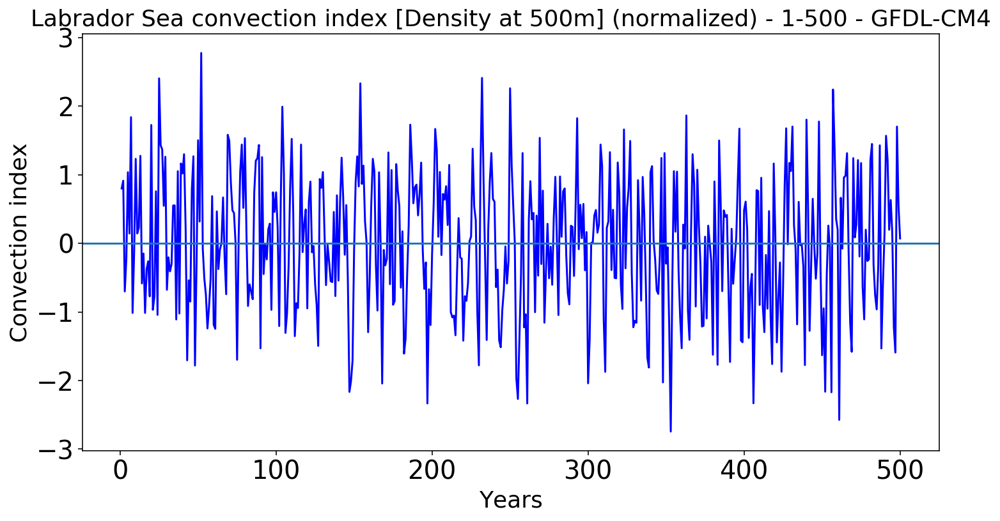

In [25]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_index_density_norm,'b')
l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Convection index', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Labrador Sea convection index [Density at 500m] (normalized) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_density_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

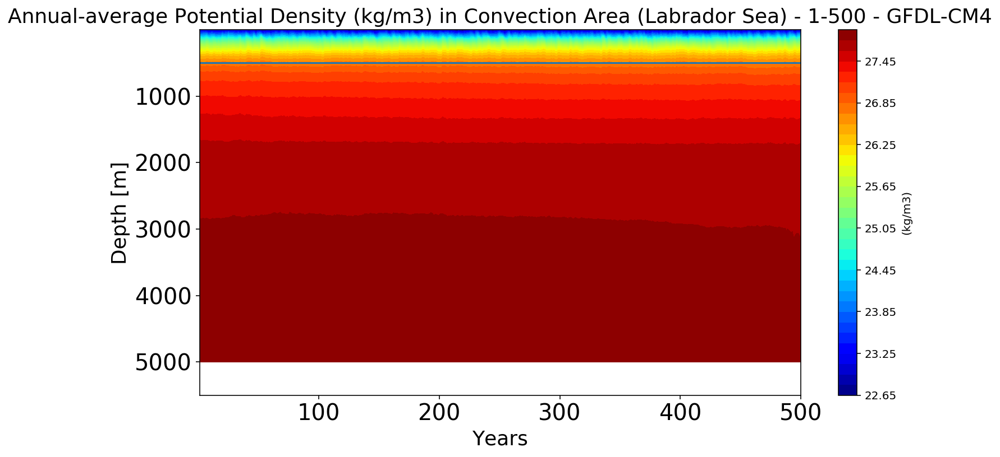

In [27]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth[:,0:33]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_time_depth_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

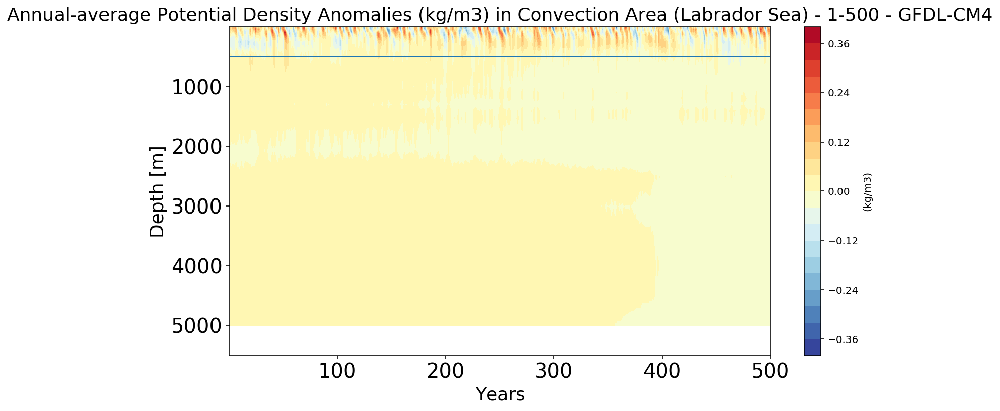

In [60]:
aa = np.nanmean(LAB_Density_time_depth,axis=0)
bb = copy.deepcopy(LAB_Density_time_depth)
for ii in range(LAB_Density_time_depth.shape[0]):
    bb[ii,:]=aa

fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth[:,0:33]-bb[:,0:33]), 20, cmap=plt.cm.RdYlBu_r)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density Anomalies (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_anomaly_time_depth_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

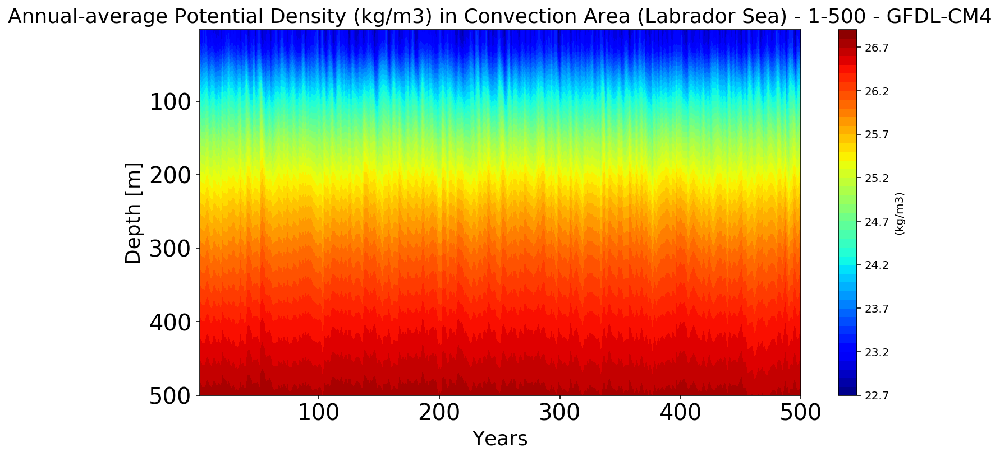

In [28]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_Density_time_depth[:,0:14]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_time_depth_surface_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

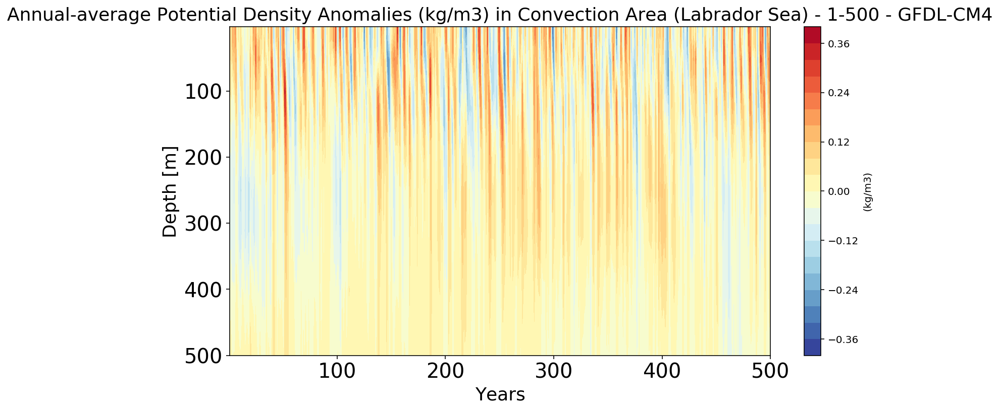

In [21]:
aa = np.nanmean(LAB_Density_time_depth,axis=0)
bb = copy.deepcopy(LAB_Density_time_depth)
for ii in range(LAB_Density_time_depth.shape[0]):
    bb[ii,:]=aa
    
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_Density_time_depth[:,0:14]-bb[:,0:14]), 20, cmap=plt.cm.RdYlBu_r)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density Anomalies (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_anomaly_time_depth_surface_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

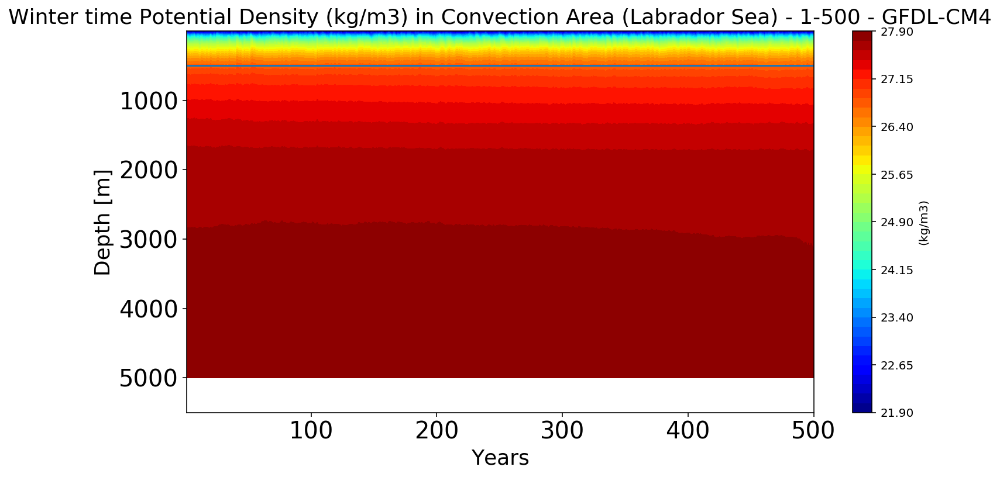

In [51]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth_winter[:,0:33]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Winter time Potential Density (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_winter_time_depth_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

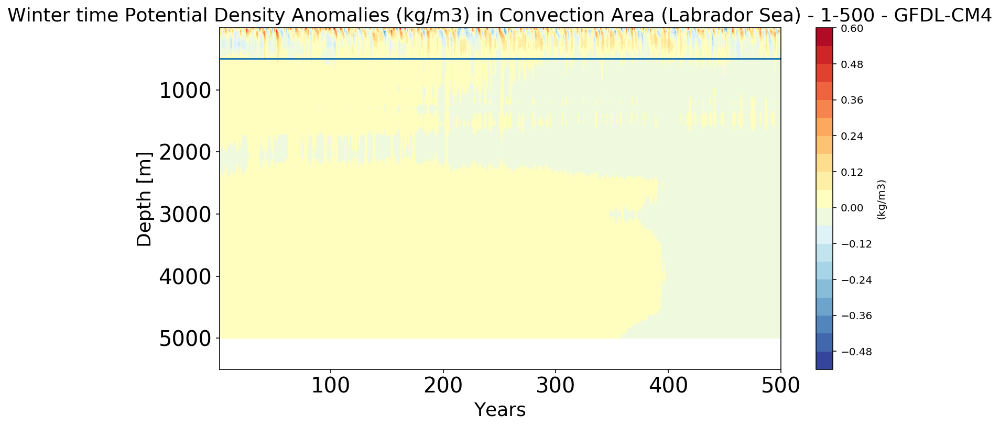

In [61]:
cc = np.nanmean(LAB_Density_time_depth_winter,axis=0)
dd = copy.deepcopy(LAB_Density_time_depth_winter)
for ii in range(LAB_Density_time_depth_winter.shape[0]):
    dd[ii,:]=cc

fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth_winter[:,0:33]-dd[:,0:33]), 20, cmap=plt.cm.RdYlBu_r)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Winter time Potential Density Anomalies (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_winter_anomaly_time_depth_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

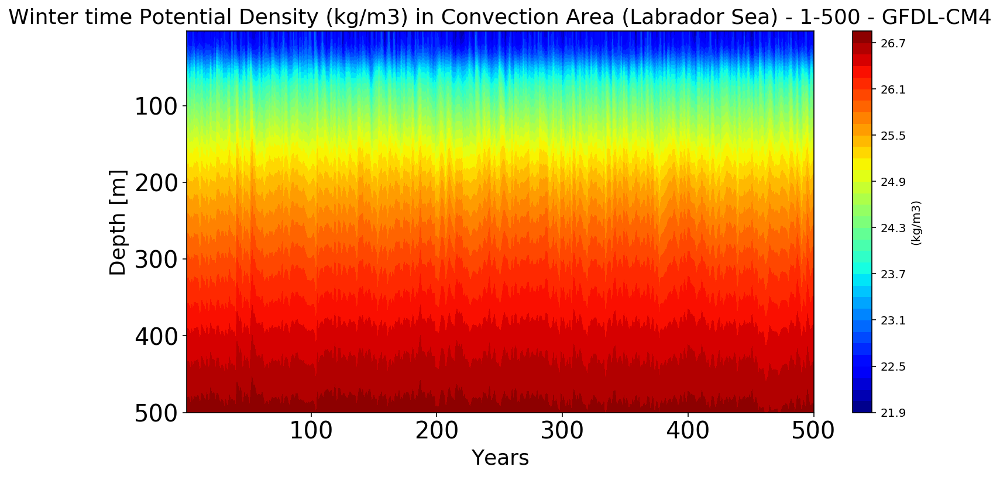

In [52]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_Density_time_depth_winter[:,0:14]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Winter time Potential Density (kg/m3) in Convection Area (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_winter_time_depth_surface_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
##################################################################################################
##################################################################################################
##################################################################################################

In [13]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

In [14]:
Salinity_time_lat_atl_surf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,0,:,:]
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_surf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_atl_surf = np.asarray(Salinity_time_lat_atl_surf)

In [15]:
Salinity_time_lat_atl_subsurf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_subsurf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_atl_subsurf = np.asarray(Salinity_time_lat_atl_subsurf)

In [17]:
del Salinity_allyears

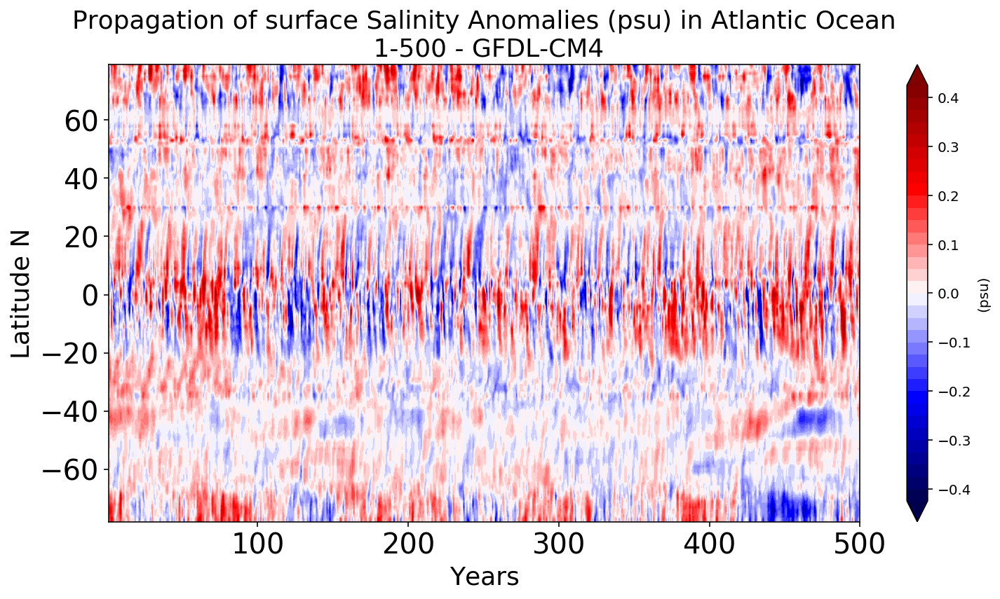

In [19]:
aa = np.nanmean(Salinity_time_lat_atl_surf,axis=0)
bb = copy.deepcopy(Salinity_time_lat_atl_surf)
for ii in range(Salinity_time_lat_atl_surf.shape[0]):
    bb[ii,:]=aa

fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose(Salinity_time_lat_atl_surf[:,12:170]-bb[:,12:170]), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Salinity Anomalies (psu) in Atlantic Ocean\n '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(psu)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_surf.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

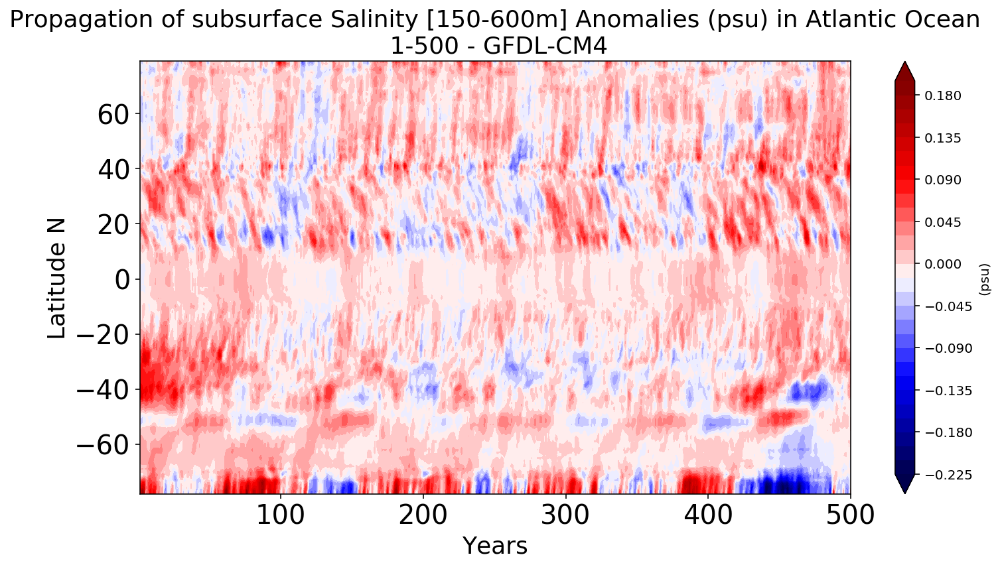

In [71]:
aa = np.nanmean(Salinity_time_lat_atl_subsurf,axis=0)
bb = copy.deepcopy(Salinity_time_lat_atl_subsurf)
for ii in range(Salinity_time_lat_atl_subsurf.shape[0]):
    bb[ii,:]=aa

fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose(Salinity_time_lat_atl_subsurf[:,12:170]-bb[:,12:170]), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Salinity [150-600m] Anomalies (psu) in Atlantic Ocean\n '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(psu)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_subsurf.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [21]:
Depths

array([2.5000e+00, 1.0000e+01, 2.0000e+01, 3.2500e+01, 5.1250e+01,
       7.5000e+01, 1.0000e+02, 1.2500e+02, 1.5625e+02, 2.0000e+02,
       2.5000e+02, 3.1250e+02, 4.0000e+02, 5.0000e+02, 6.0000e+02,
       7.0000e+02, 8.0000e+02, 9.0000e+02, 1.0000e+03, 1.1000e+03,
       1.2000e+03, 1.3000e+03, 1.4000e+03, 1.5375e+03, 1.7500e+03,
       2.0625e+03, 2.5000e+03, 3.0000e+03, 3.5000e+03, 4.0000e+03,
       4.5000e+03, 5.0000e+03, 5.5000e+03, 6.0000e+03, 6.5000e+03])

In [23]:
Depths[29]

4000.0

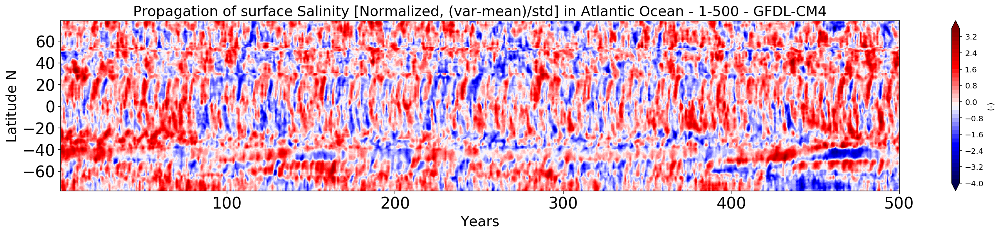

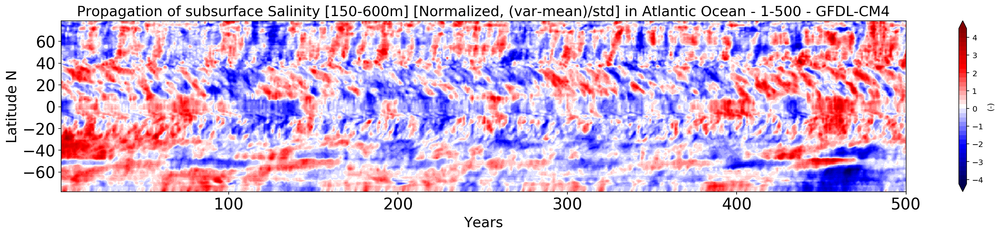

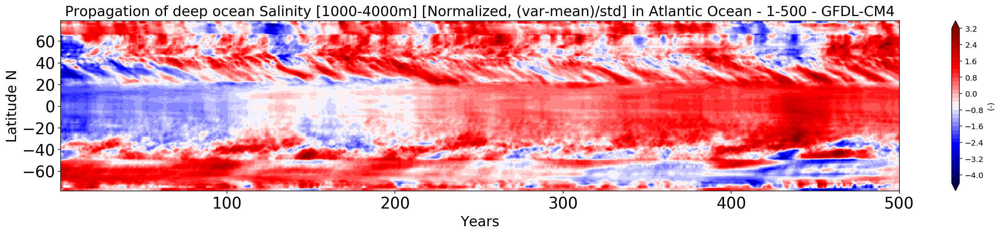

In [18]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_time_lat_atl_surf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,0,:,:]
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_surf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_atl_surf = np.asarray(Salinity_time_lat_atl_surf)

Salinity_time_lat_atl_subsurf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,8:15,:,:] #150-600m
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_subsurf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_atl_subsurf = np.asarray(Salinity_time_lat_atl_subsurf)

Salinity_time_lat_atl_deep=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,18:30,:,:] # 1000-4000m
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_deep.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_atl_deep = np.asarray(Salinity_time_lat_atl_deep)

del Salinity_allyears

#############################################################################################
#############################################################################################
Var_plot = Salinity_time_lat_atl_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Salinity [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Salinity_time_lat_atl_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Salinity [150-600m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Salinity_time_lat_atl_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Salinity [1000-4000m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


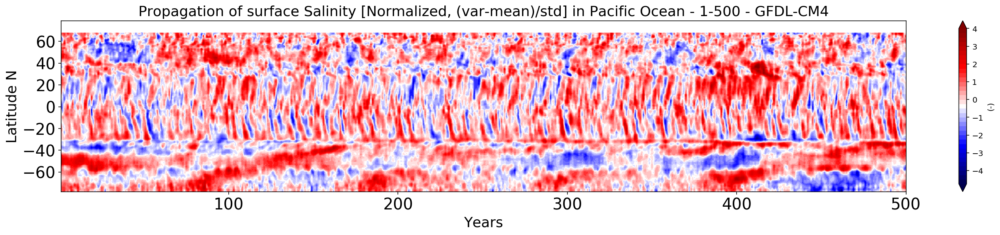

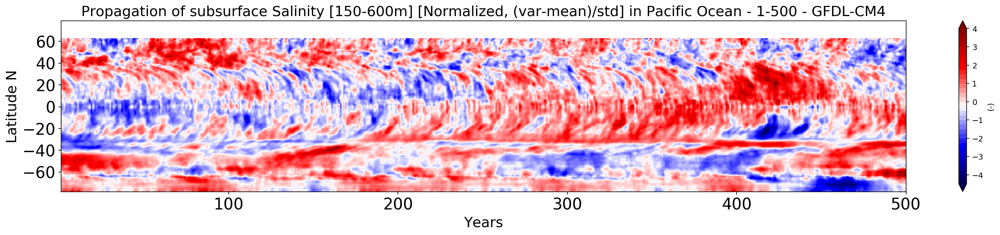

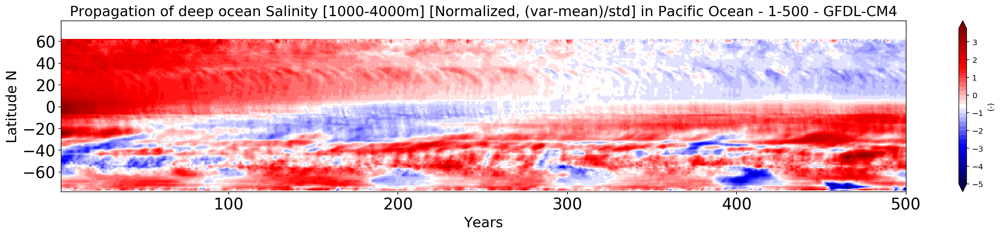

In [35]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_time_lat_pacfc_surf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,0,:,:]
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Salinity_time_lat_pacfc_surf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_pacfc_surf = np.asarray(Salinity_time_lat_pacfc_surf)

Salinity_time_lat_pacfc_subsurf=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Salinity_time_lat_pacfc_subsurf.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_pacfc_subsurf = np.asarray(Salinity_time_lat_pacfc_subsurf)

Salinity_time_lat_pacfc_deep=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,18:30,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Salinity_time_lat_pacfc_deep.append(np.nanmean(data_i,axis=1))
    
Salinity_time_lat_pacfc_deep = np.asarray(Salinity_time_lat_pacfc_deep)

del Salinity_allyears

#############################################################################################
#############################################################################################
Var_plot = Salinity_time_lat_pacfc_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc
    
fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Salinity [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Salinity_time_lat_pacfc_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Salinity [150-600m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Salinity_time_lat_pacfc_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Salinity [1000-4000m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_pacfc_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


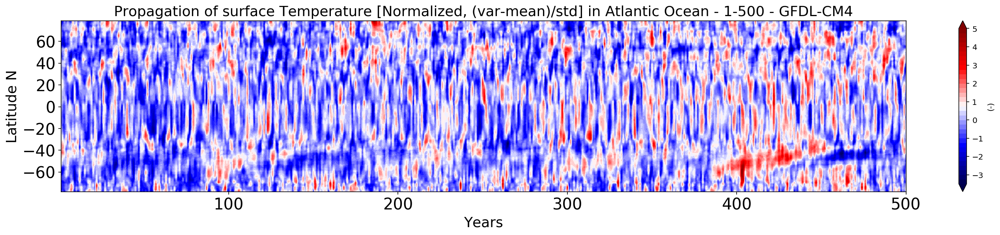

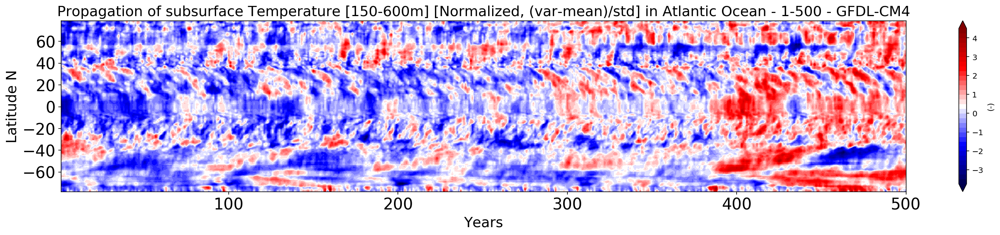

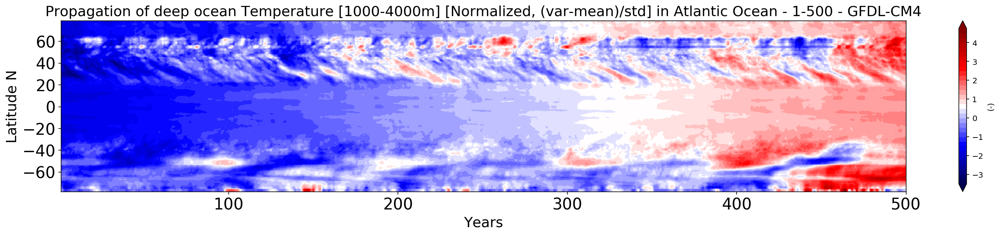

In [20]:
Temp_allyears=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_time_lat_atl_surf=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,0,:,:]
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Temp_time_lat_atl_surf.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_atl_surf = np.asarray(Temp_time_lat_atl_surf)

Temp_time_lat_atl_subsurf=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Temp_time_lat_atl_subsurf.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_atl_subsurf = np.asarray(Temp_time_lat_atl_subsurf)

Temp_time_lat_atl_deep=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,18:30,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Temp_time_lat_atl_deep.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_atl_deep = np.asarray(Temp_time_lat_atl_deep)

del Temp_allyears

#############################################################################################
#############################################################################################
Var_plot = Temp_time_lat_atl_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Temperature [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Temp_time_lat_atl_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Temperature [150-600m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Temp_time_lat_atl_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Temperature [1000-4000m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_Temp_time_lat_atl_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


distributed.utils_perf - INFO - full garbage collection released 12.14 MB from 70324 reference cycles (threshold: 10.00 MB)


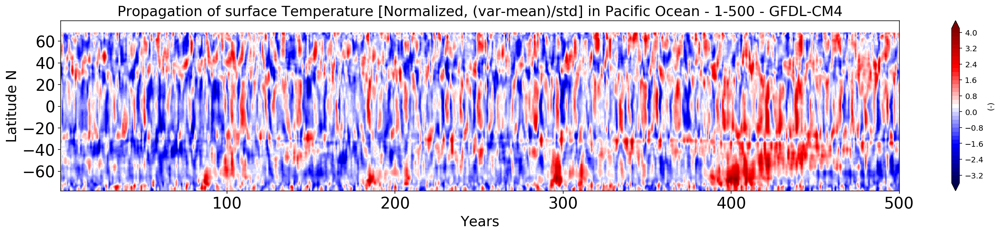

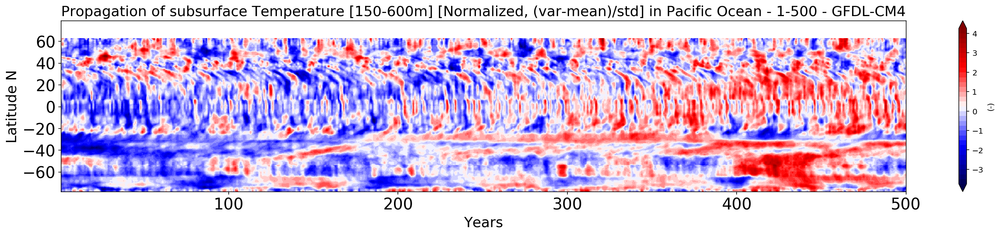

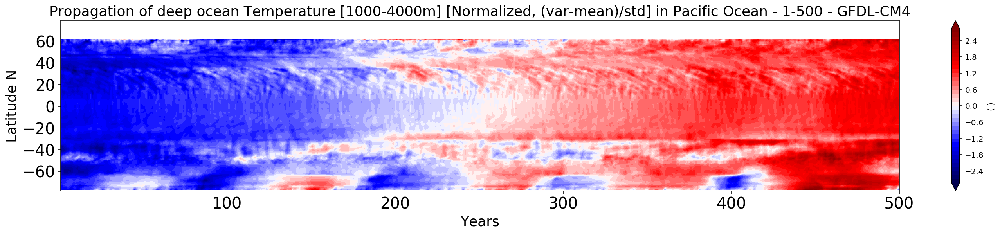

In [38]:
Temp_allyears=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_time_lat_pacfc_surf=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,0,:,:]
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Temp_time_lat_pacfc_surf.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_pacfc_surf = np.asarray(Temp_time_lat_pacfc_surf)

Temp_time_lat_pacfc_subsurf=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Temp_time_lat_pacfc_subsurf.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_pacfc_subsurf = np.asarray(Temp_time_lat_pacfc_subsurf)

Temp_time_lat_pacfc_deep=[] 
for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,18:30,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Temp_time_lat_pacfc_deep.append(np.nanmean(data_i,axis=1))
    
Temp_time_lat_pacfc_deep = np.asarray(Temp_time_lat_pacfc_deep)

del Temp_allyears

#############################################################################################
#############################################################################################
Var_plot = Temp_time_lat_pacfc_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Temperature [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Temp_time_lat_pacfc_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Temperature [150-600m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Temp_time_lat_pacfc_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Temperature [1000-4000m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_temp_time_lat_pacfc_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


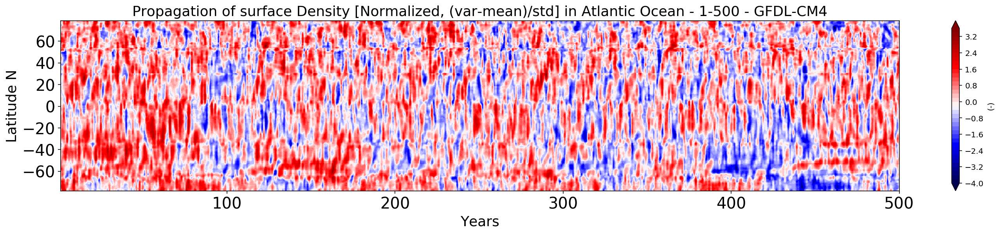

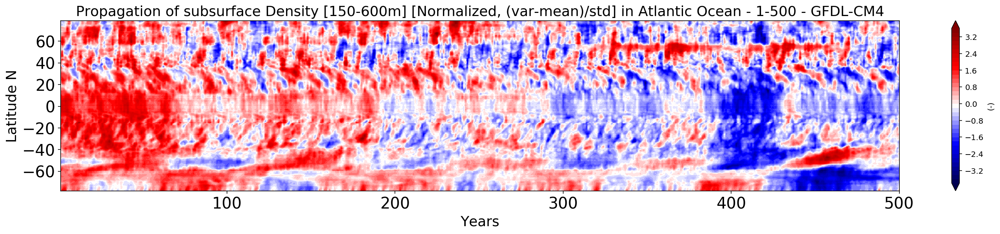

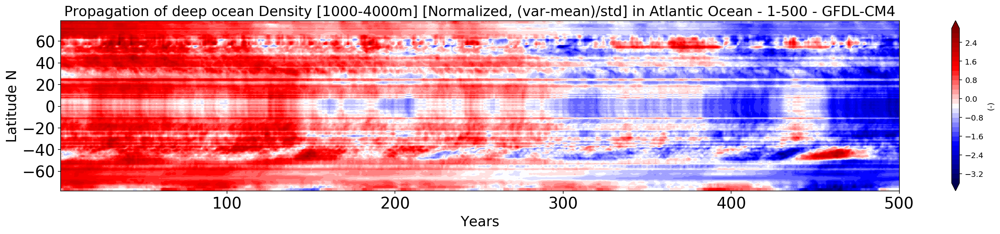

In [22]:
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_time_lat_atl_surf=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,0,:,:]
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Density_time_lat_atl_surf.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_atl_surf = np.asarray(Density_time_lat_atl_surf)

Density_time_lat_atl_subsurf=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Density_time_lat_atl_subsurf.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_atl_subsurf = np.asarray(Density_time_lat_atl_subsurf)

Density_time_lat_atl_deep=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,18:30,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Density_time_lat_atl_deep.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_atl_deep = np.asarray(Density_time_lat_atl_deep)

del Density_allyears

#############################################################################################
#############################################################################################
Var_plot = Density_time_lat_atl_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Density [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Density_time_lat_atl_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Density [150-600m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Density_time_lat_atl_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Density [1000-4000m] [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_time_lat_atl_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


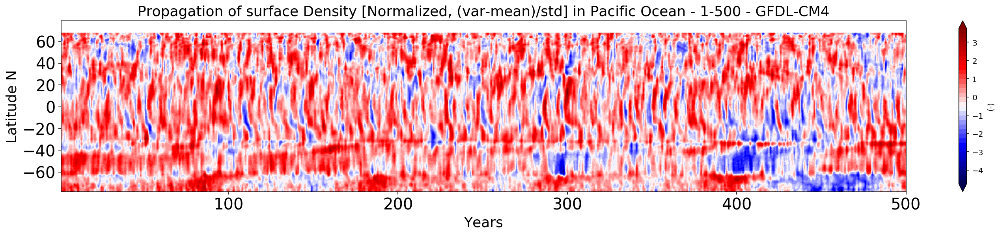

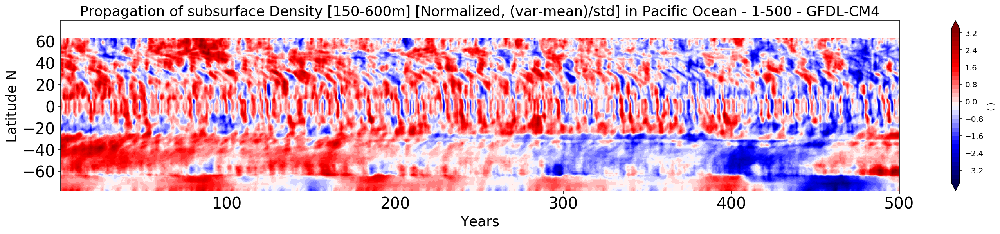

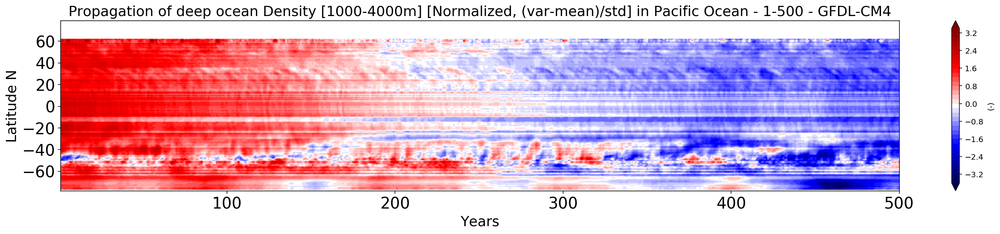

In [37]:
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_time_lat_pacfc_surf=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,0,:,:]
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Density_time_lat_pacfc_surf.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_pacfc_surf = np.asarray(Density_time_lat_pacfc_surf)

Density_time_lat_pacfc_subsurf=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,8:15,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Density_time_lat_pacfc_subsurf.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_pacfc_subsurf = np.asarray(Density_time_lat_pacfc_subsurf)

Density_time_lat_pacfc_deep=[] 
for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,18:30,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Density_time_lat_pacfc_deep.append(np.nanmean(data_i,axis=1))
    
Density_time_lat_pacfc_deep = np.asarray(Density_time_lat_pacfc_deep)

del Density_allyears

#############################################################################################
#############################################################################################
Var_plot = Density_time_lat_pacfc_surf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of surface Density [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Density_time_lat_pacfc_subsurf
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of subsurface Density [150-600m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = Density_time_lat_pacfc_deep
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), 40, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of deep ocean Density [1000-4000m] [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_time_lat_pacfc_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [13]:
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

In [14]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

In [15]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']; my_shelf.close()

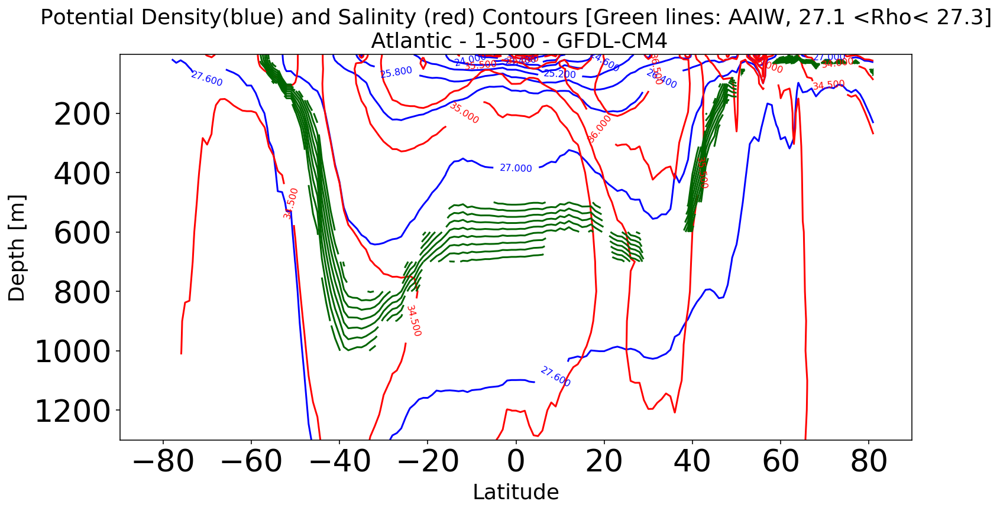

In [16]:
P_Var_x1=P_Var_x2=Lat_regrid_1D
P_Var_y1=P_Var_y2=Depths[0:22]
P_Var_z1=np.nanmean(Density_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:22,:]-1000

P_Var_z2=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z2.shape[0]):
    P_Var_z2[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z2=np.nanmean(P_Var_z2,axis=2)
P_Var_z2=P_Var_z2[0:22,:]
P_title='Potential Density(blue) and Salinity (red) Contours [Green lines: AAIW, 27.1 <Rho< 27.3]\n Atlantic - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
P_xlable='Latitude'  ;P_ylable='Depth [m]'
fig = func_plot2Dcontour_2var(P_Var_x1, P_Var_y1, P_Var_z1, P_Var_x2, P_Var_y2, P_Var_z2, P_xlable, P_ylable, P_title, 'b', 'r', 10, 'invert_yaxis')

P_Var_z3=copy.deepcopy(P_Var_z1)
P_Var_z3[ P_Var_z3 > 27.3]=np.nan ; P_Var_z3[ P_Var_z3 < 27.1 ]=np.nan
im2=plt.contour(P_Var_x1, P_Var_y1, P_Var_z3, 10, latlon=True, colors='darkgreen')
#fig.savefig(dir_figs+str(GCM)+'_Density_Salinity_Atlantic_AAIW_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

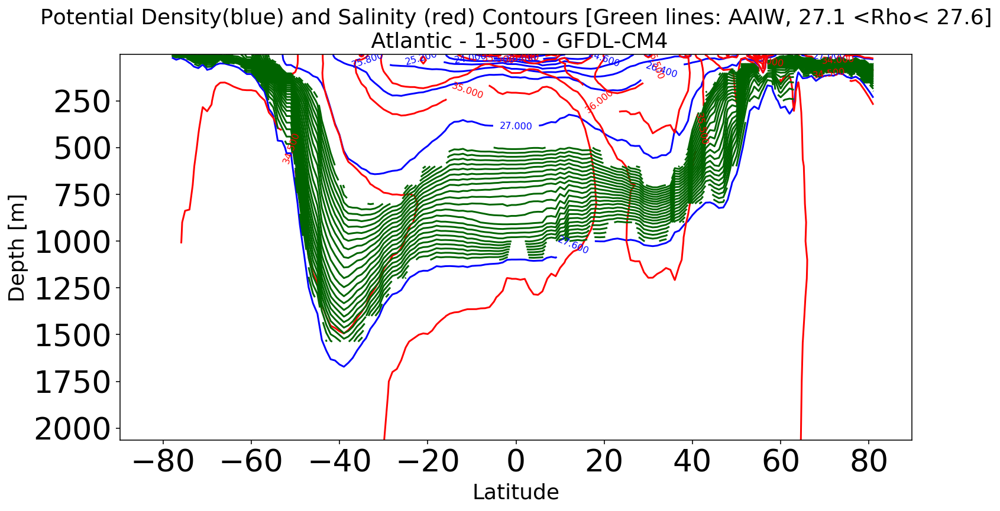

In [22]:
P_Var_x1=P_Var_x2=Lat_regrid_1D
P_Var_y1=P_Var_y2=Depths[0:26]
P_Var_z1=np.nanmean(Density_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:26,:]-1000

P_Var_z2=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z2.shape[0]):
    P_Var_z2[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z2=np.nanmean(P_Var_z2,axis=2)
P_Var_z2=P_Var_z2[0:26,:]
P_title='Potential Density(blue) and Salinity (red) Contours [Green lines: AAIW, 27.1 <Rho< 27.6]\n Atlantic - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
P_xlable='Latitude'  ;P_ylable='Depth [m]'
fig = func_plot2Dcontour_2var(P_Var_x1, P_Var_y1, P_Var_z1, P_Var_x2, P_Var_y2, P_Var_z2, P_xlable, P_ylable, P_title, 'b', 'r', 10, 'invert_yaxis')

P_Var_z3=copy.deepcopy(P_Var_z1)
P_Var_z3[ P_Var_z3 > 27.6]=np.nan ; P_Var_z3[ P_Var_z3 < 27.1 ]=np.nan
im2=plt.contour(P_Var_x1, P_Var_y1, P_Var_z3, 30, latlon=True, colors='darkgreen')
#fig.savefig(dir_figs+str(GCM)+'_Density_Salinity_Atlantic_AAIW_2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

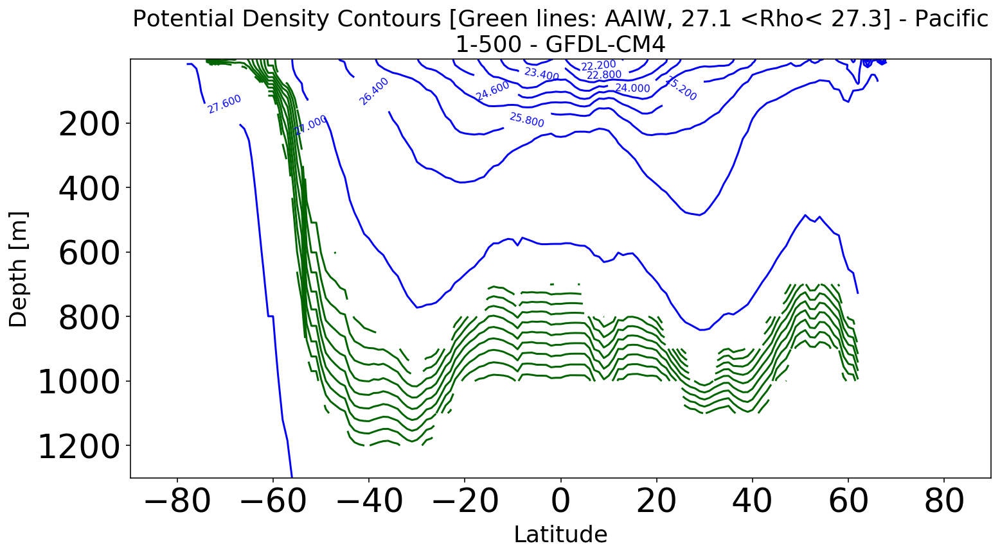

In [60]:
P_Var_x1=Lat_regrid_1D
P_Var_y1=Depths[0:22]
P_Var_z1=np.nanmean(Density_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=2]=np.nan # Pacific Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:22,:]-1000
P_xlable='Latitude'  ;P_ylable='Depth [m]'
P_title='Potential Density Contours [Green lines: AAIW, 27.1 <Rho< 27.3] - Pacific\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig = func_plot2Dcontour_1var(P_Var_x1, P_Var_y1, P_Var_z1, P_xlable, P_ylable, P_title, 'b', 10, 'invert_yaxis')
P_Var_z2=copy.deepcopy(P_Var_z1)
P_Var_z2[ P_Var_z2 > 27.301]=np.nan ; P_Var_z2[ P_Var_z2 < 27.099 ]=np.nan
im2=plt.contour(P_Var_x1, P_Var_y1, P_Var_z2, 10, latlon=True, colors='darkgreen')
#fig.savefig(dir_figs+str(GCM)+'_Density_Pacific_AAIW_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

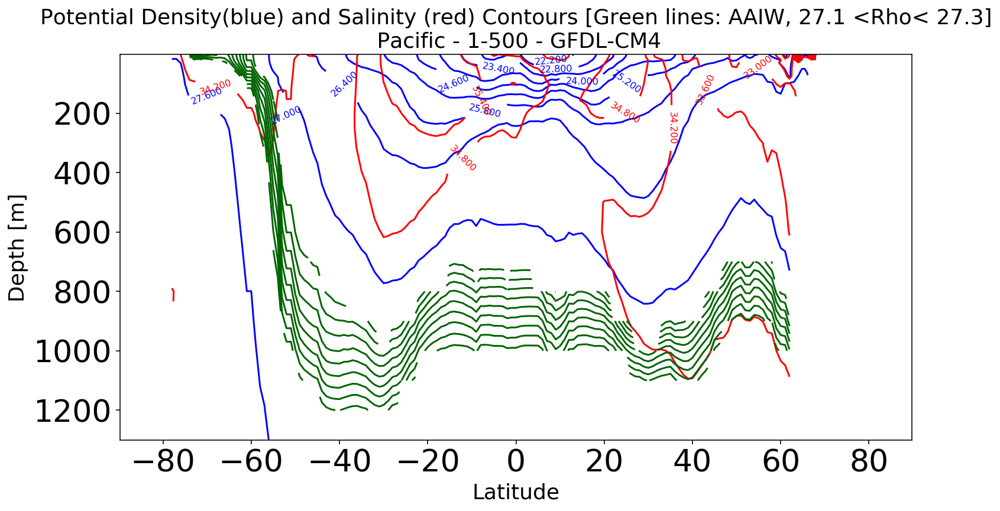

In [38]:
P_Var_x1=P_Var_x2=Lat_regrid_1D
P_Var_y1=P_Var_y2=Depths[0:22]
P_Var_z1=np.nanmean(Density_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=2]=np.nan # Pacific Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:22,:]-1000

P_Var_z2=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z2.shape[0]):
    P_Var_z2[ii,:,:][Ocean_Index!=2]=np.nan # Pacific Ocean only
P_Var_z2=np.nanmean(P_Var_z2,axis=2)
P_Var_z2=P_Var_z2[0:22,:]
P_title='Potential Density(blue) and Salinity (red) Contours [Green lines: AAIW, 27.1 <Rho< 27.3]\n Pacific - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
P_xlable='Latitude'  ;P_ylable='Depth [m]'
fig = func_plot2Dcontour_2var(P_Var_x1, P_Var_y1, P_Var_z1, P_Var_x2, P_Var_y2, P_Var_z2, P_xlable, P_ylable, P_title, 'b', 'r', 10, 'invert_yaxis')

P_Var_z3=copy.deepcopy(P_Var_z1)
P_Var_z3[ P_Var_z3 > 27.3]=np.nan ; P_Var_z3[ P_Var_z3 < 27.1 ]=np.nan
im2=plt.contour(P_Var_x1, P_Var_y1, P_Var_z3, 10, latlon=True, colors='darkgreen')
#fig.savefig(dir_figs+str(GCM)+'_Density_Salinity_Pacific_AAIW_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

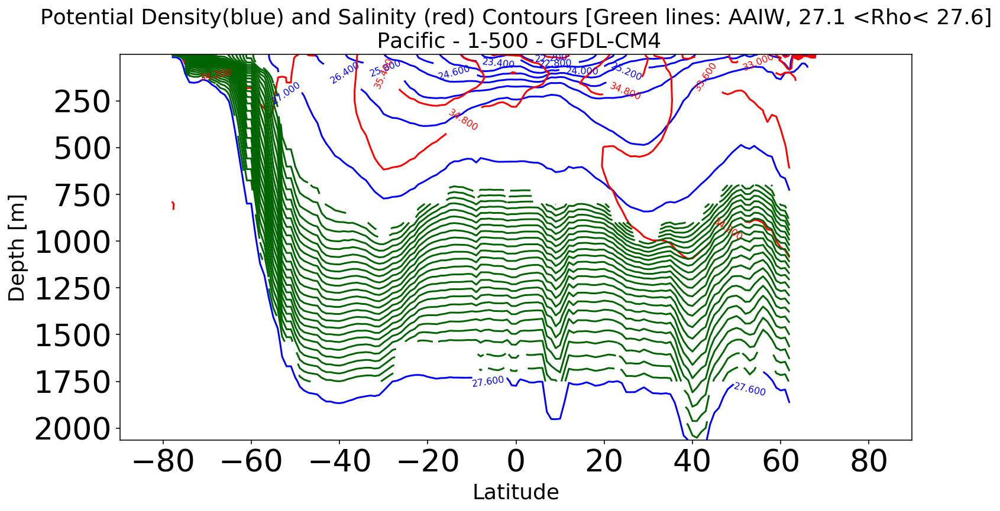

In [19]:
P_Var_x1=P_Var_x2=Lat_regrid_1D
P_Var_y1=P_Var_y2=Depths[0:26]
P_Var_z1=np.nanmean(Density_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=2]=np.nan # Pacific Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:26,:]-1000

P_Var_z2=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z2.shape[0]):
    P_Var_z2[ii,:,:][Ocean_Index!=2]=np.nan # Pacific Ocean only
P_Var_z2=np.nanmean(P_Var_z2,axis=2)
P_Var_z2=P_Var_z2[0:26,:]
P_title='Potential Density(blue) and Salinity (red) Contours [Green lines: AAIW, 27.1 <Rho< 27.6]\n Pacific - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
P_xlable='Latitude'  ;P_ylable='Depth [m]'
fig = func_plot2Dcontour_2var(P_Var_x1, P_Var_y1, P_Var_z1, P_Var_x2, P_Var_y2, P_Var_z2, P_xlable, P_ylable, P_title, 'b', 'r', 10, 'invert_yaxis')

P_Var_z3=copy.deepcopy(P_Var_z1)
P_Var_z3[ P_Var_z3 > 27.6]=np.nan ; P_Var_z3[ P_Var_z3 < 27.1 ]=np.nan
im2=plt.contour(P_Var_x1, P_Var_y1, P_Var_z3, 30, latlon=True, colors='darkgreen')
#fig.savefig(dir_figs+str(GCM)+'_Density_Salinity_Pacific_AAIW_2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
array([2.5000e+00, 1.0000e+01, 2.0000e+01, 3.2500e+01, 5.1250e+01,
       7.5000e+01, 1.0000e+02, 1.2500e+02, 1.5625e+02, 2.0000e+02,
       2.5000e+02, 3.1250e+02, 4.0000e+02, 5.0000e+02, 6.0000e+02,
       7.0000e+02, 8.0000e+02, 9.0000e+02, 1.0000e+03, 1.1000e+03,
       1.2000e+03, 1.3000e+03, 1.4000e+03, 1.5375e+03, 1.7500e+03,
       2.0625e+03, 2.5000e+03, 3.0000e+03, 3.5000e+03, 4.0000e+03,
       4.5000e+03, 5.0000e+03, 5.5000e+03, 6.0000e+03, 6.5000e+03])

In [14]:
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

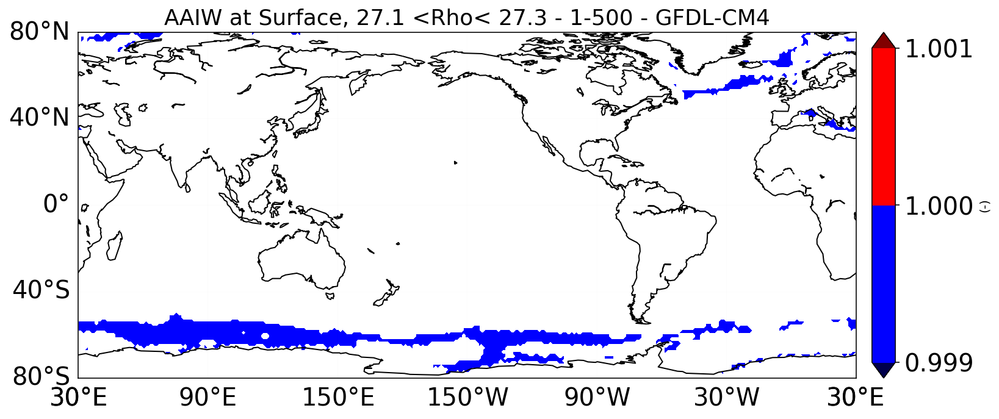

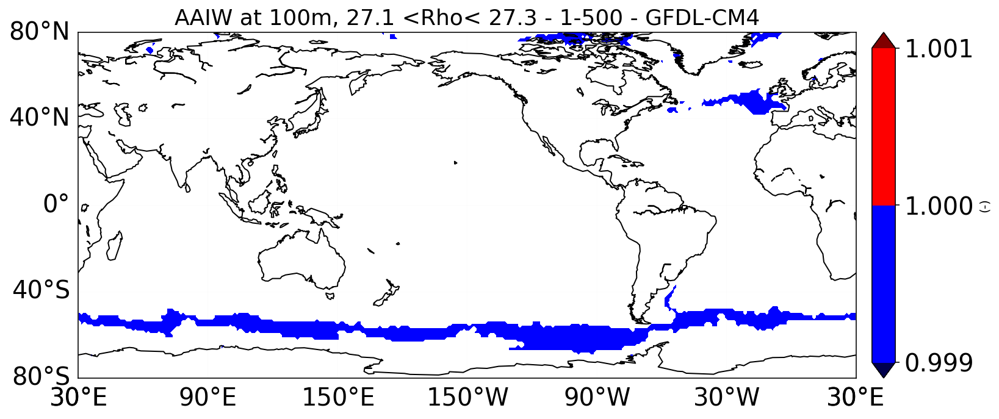

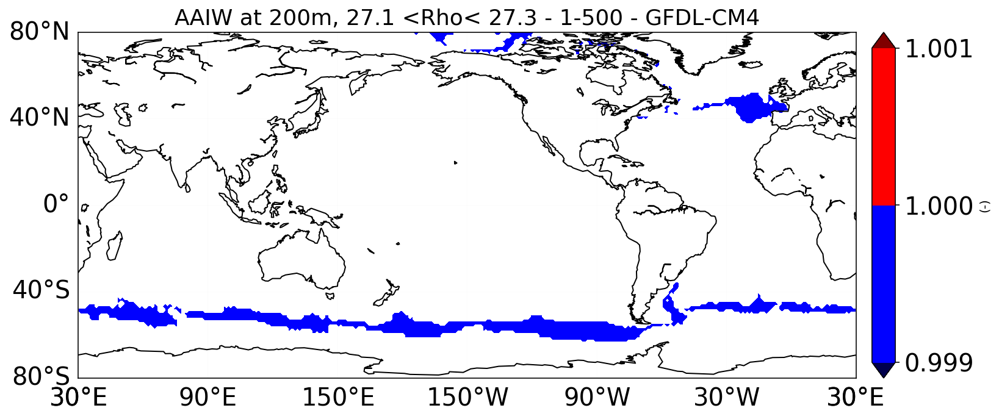

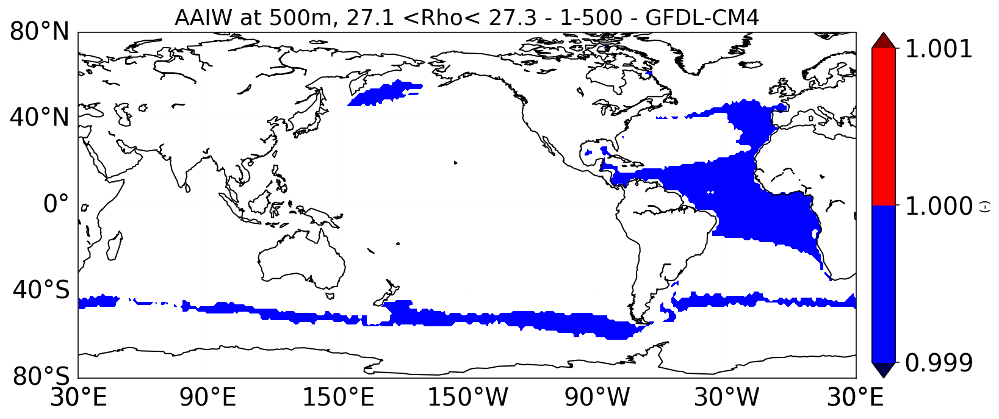

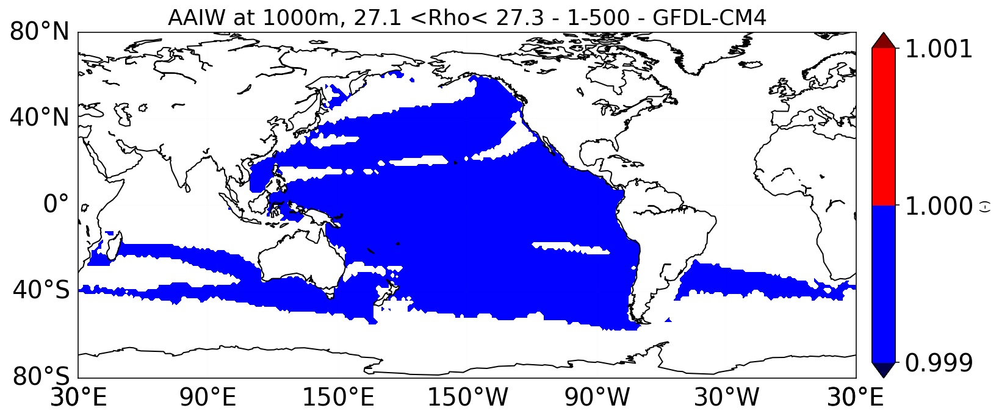

In [34]:
Plot_Var = np.nanmean(Density_allyears[:,0,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,0,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.3] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at Surface, 27.1 <Rho< 27.3 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,6,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,6,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.3] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 100m, 27.1 <Rho< 27.3 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,9,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,9,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.3] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 200m, 27.1 <Rho< 27.3 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,13,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,13,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.3] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 500m, 27.1 <Rho< 27.3 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,18,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,18,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.3] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 1000m, 27.1 <Rho< 27.3 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

#fig.savefig(dir_figs+str(GCM)+'_surface_temperature_composites_ROSS.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

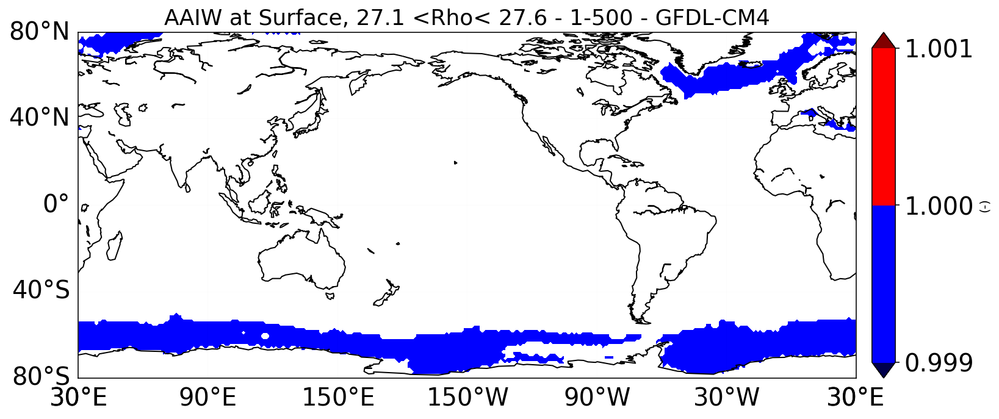

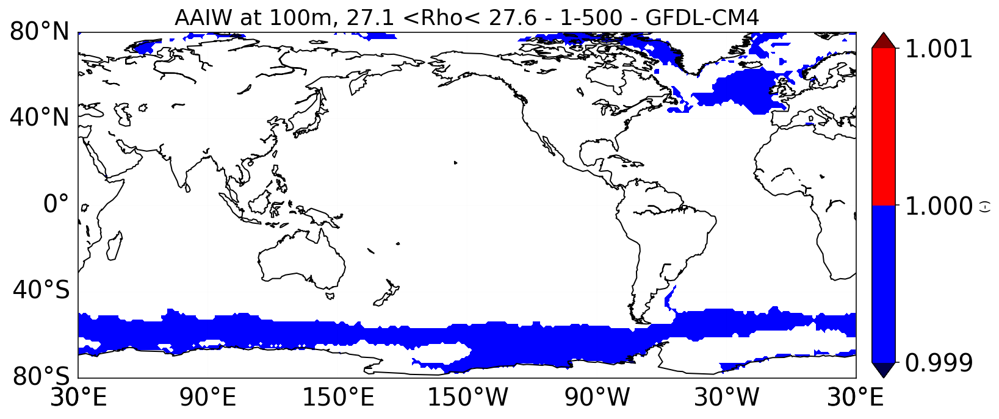

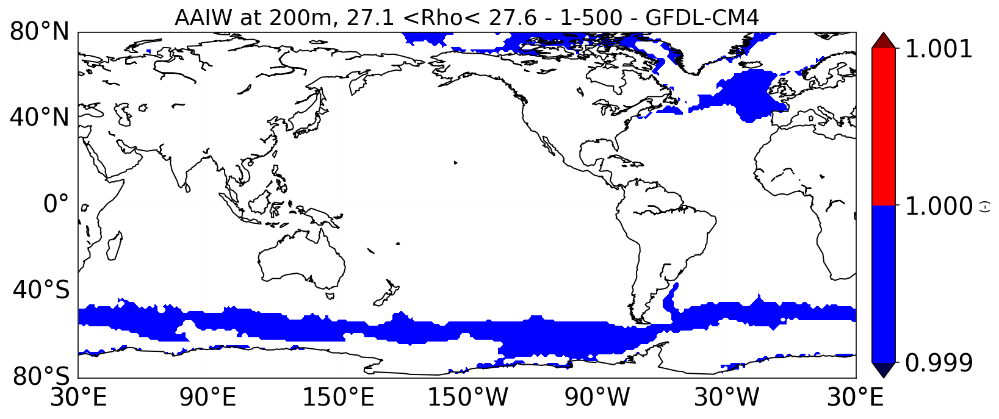

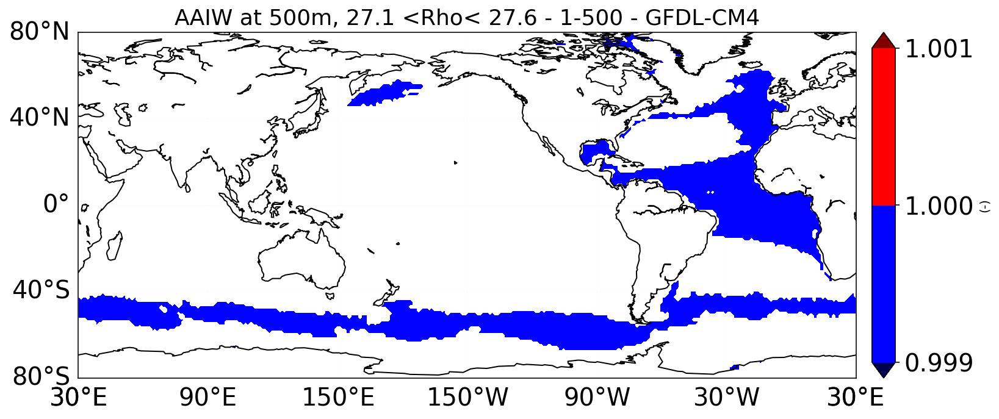

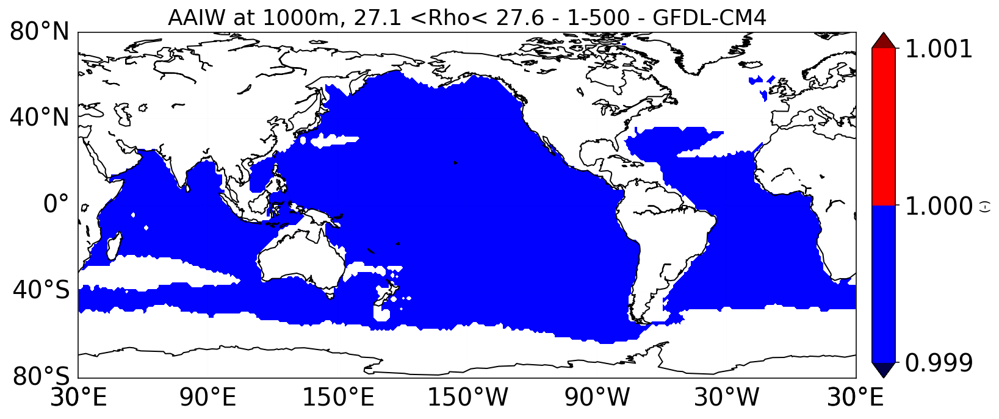

In [20]:
Plot_Var = np.nanmean(Density_allyears[:,0,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,0,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.6] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at Surface, 27.1 <Rho< 27.6 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,6,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,6,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.6] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 100m, 27.1 <Rho< 27.6 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,9,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,9,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.6] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 200m, 27.1 <Rho< 27.6 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,13,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,13,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.6] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 500m, 27.1 <Rho< 27.6 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

Plot_Var = np.nanmean(Density_allyears[:,18,:,:],axis=0)-1000
Plot_Var_AAIW = np.nanmean(Density_allyears[:,18,:,:],axis=0)-1000
Plot_Var_AAIW [Plot_Var_AAIW < 27.1] = np.nan; Plot_Var_AAIW [Plot_Var_AAIW > 27.6] = np.nan
Plot_Var_AAIW [ ~np.isnan(Plot_Var_AAIW) ] = 1
#cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99)))
Plot_range=np.linspace(0.999,1.001,3)
#Plot_range = 20
Plot_unit='(-)'; Plot_title= 'AAIW at 1000m, 27.1 <Rho< 27.6 - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var_AAIW, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., '-')

#fig.savefig(dir_figs+str(GCM)+'_surface_temperature_composites_ROSS.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [13]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']; my_shelf.close()

lat_n=Lat_regrid_2D.shape[0] # Number of Lat elements in the data
lon_n=Lon_regrid_2D.shape[1] # Number of Lon elements in the data
earth_R = 6378 # Earth Radius - Unit is kilometer (km)
GridCell_Areas = np.zeros ((lat_n, lon_n )) # A = 2*pi*R^2 |sin(lat1)-sin(lat2)| |lon1-lon2|/360 = (pi/180)R^2 |lon1-lon2| |sin(lat1)-sin(lat2)| 
for ii in range(1,lat_n-1):
    for jj in range(1,lon_n-1):
        GridCell_Areas [ii,jj] = math.fabs( (earth_R**2) * (math.pi/180) * np.absolute( (Lon_regrid_2D[ii,jj-1]+Lon_regrid_2D[ii,jj])/2  -  (Lon_regrid_2D[ii,jj]+Lon_regrid_2D[ii,jj+1])/2 )  * np.absolute( math.sin(math.radians( ( Lat_regrid_2D[ii-1,jj]+Lat_regrid_2D[ii,jj])/2 )) - math.sin(math.radians( Lat_regrid_2D[ii,jj]+Lat_regrid_2D[ii+1,jj])/2  )) )                  
for ii in range(1,lat_n-1):
    for jj in range(2,lon_n-2):
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj-1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj-1]
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj+1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj+1]
GridCell_Areas[0,:]=GridCell_Areas[1,:]; GridCell_Areas[-1,:]=GridCell_Areas[-2,:]
GridCell_Areas[:,0]=GridCell_Areas[:,1]; GridCell_Areas[:,-1]=GridCell_Areas[:,-2] 
# GridCell_Areas unit = km2

GridCell_volume = np.full([Depths.shape[0],Lat_regrid_2D.shape[0],Lat_regrid_2D.shape[1]],np.nan)
for l in range(GridCell_volume.shape[0]):
    GridCell_volume[l,:,:] = GridCell_Areas * Depths[l]

##################################################################   
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

AAIW_volume=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
    AAIW_volume[t]= np.nansum(np.nansum(np.nansum(GridCell_volume_yr,axis=0),axis=0),axis=0)

AAIW_volume_atl=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    AAIW_volume_atl[t]= np.nansum(np.nansum(np.nansum(GridCell_volume_yr,axis=0),axis=0),axis=0)

AAIW_volume_pacfc=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    AAIW_volume_pacfc[t]= np.nansum(np.nansum(np.nansum(GridCell_volume_yr,axis=0),axis=0),axis=0)

del Density_allyears

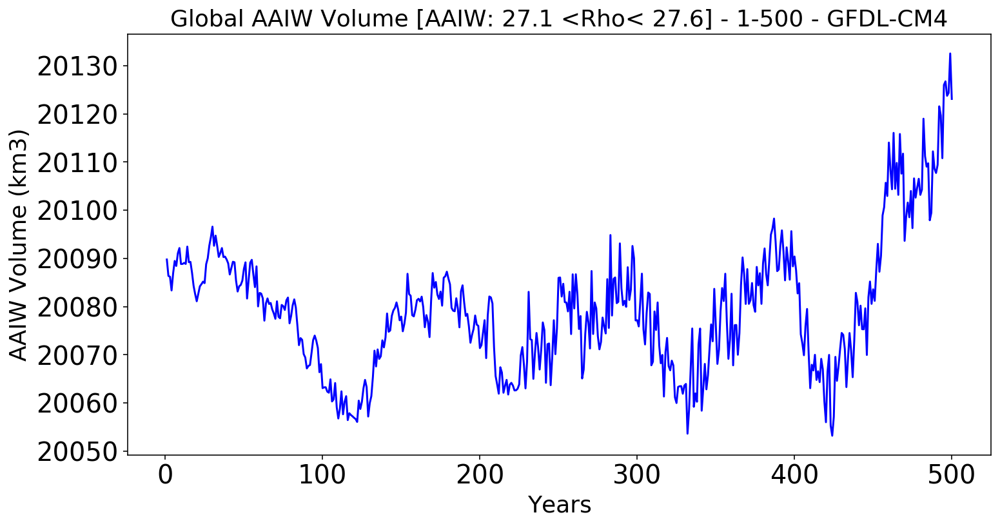

In [14]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
plt.plot(years, AAIW_volume/1e9,'b')
plt.xlabel('Years', fontsize=18)
plt.ylabel('AAIW Volume (km3)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Global AAIW Volume [AAIW: 27.1 <Rho< 27.6] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_AAIW_volume_timeseries_global_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

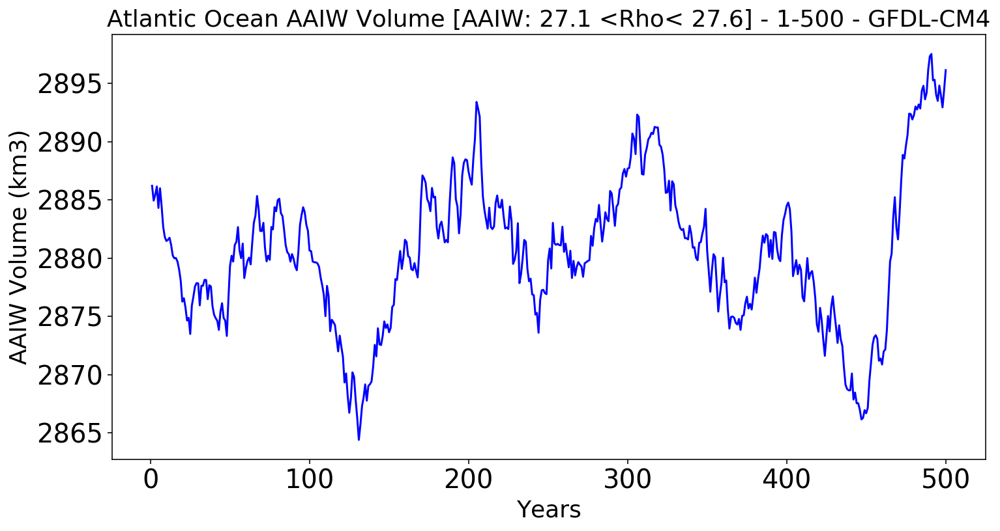

In [15]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
plt.plot(years, AAIW_volume_atl/1e9,'b')
plt.xlabel('Years', fontsize=18)
plt.ylabel('AAIW Volume (km3)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Atlantic Ocean AAIW Volume [AAIW: 27.1 <Rho< 27.6] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_AAIW_volume_timeseries_atlantic_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

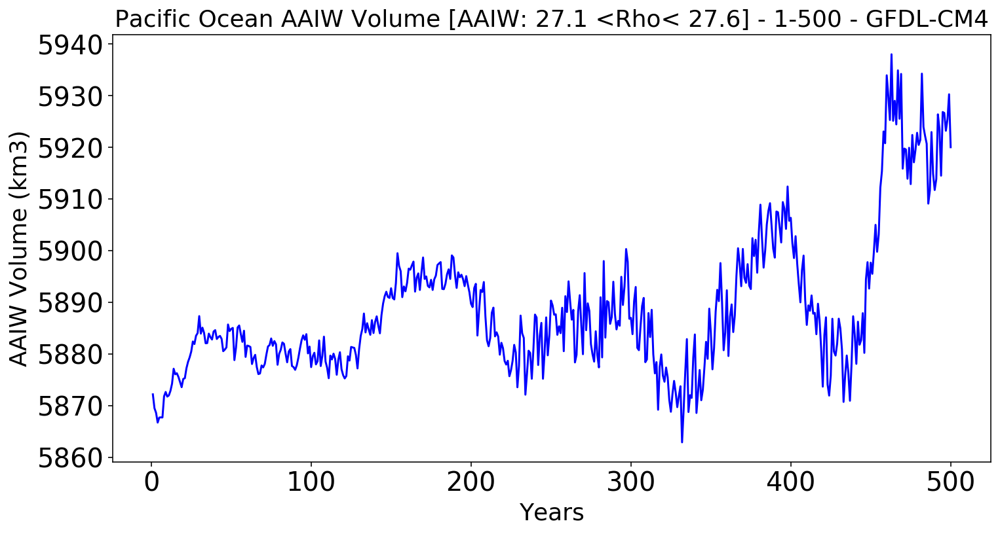

distributed.scheduler - INFO - Register tcp://10.32.80.2:46843
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.80.2:46843
distributed.core - INFO - Starting established connection


In [16]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
plt.plot(years, AAIW_volume_pacfc/1e9,'b')
plt.xlabel('Years', fontsize=18)
plt.ylabel('AAIW Volume (km3)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Pacific Ocean AAIW Volume [AAIW: 27.1 <Rho< 27.6] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_AAIW_volume_timeseries_pacific_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
################################################################
AAIW_volume_rm = runningMeanFast(AAIW_volume, 10)
AAIW_volume_atl_rm = runningMeanFast(AAIW_volume_atl, 10)
AAIW_volume_pacfc_rm = runningMeanFast(AAIW_volume_pacfc, 10)

In [15]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['WS_index']=my_shelf['WS_index']; my_shelf.close()

WS_index_rm = copy.deepcopy(WS_index)

#multiplying by -1 as we have convection when temperature is low(opposite to the index which we calculate)
WS_index_rm=runningMeanFast(WS_index_rm, 10)
WS_index_rm=WS_index_rm*(-1)

############################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_ROSS.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['ROSS_index']=my_shelf['ROSS_index']; my_shelf.close()

ROSS_index_rm = copy.deepcopy(ROSS_index)

#multiplying by -1 as we have convection when temperature is low(opposite to the index which we calculate)
ROSS_index_rm=runningMeanFast(ROSS_index_rm, 10)
ROSS_index_rm=ROSS_index_rm*(-1)

############################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['LAB_index']=my_shelf['LAB_index']; my_shelf.close()

LAB_index_rm = copy.deepcopy(LAB_index)
LAB_index_rm=runningMeanFast(LAB_index_rm, 10)

################################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_trans.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['AMOC_max']=my_shelf['AMOC_max']
globals()['SMOC_min']=my_shelf['SMOC_min']
my_shelf.close()

AMOC_max_50S= AMOC_max[:,40] # AMOC at 50S # Max of streamfunction method
AMOC_max_50S_m=runningMeanFast(AMOC_max_50S, 10)
AMOC_max_30S= AMOC_max[:,60] # AMOC at 30S # Max of streamfunction method
AMOC_max_30S_m=runningMeanFast(AMOC_max_30S, 10)
AMOC_max_50N= AMOC_max[:,140] # AMOC at 50N # Max of streamfunction method
AMOC_max_50N_m=runningMeanFast(AMOC_max_50N, 10)
AMOC_max_30N= AMOC_max[:,120] # AMOC at 30N # Max of streamfunction method
AMOC_max_30N_m=runningMeanFast(AMOC_max_30N, 10)

SMOC_min_30S= SMOC_min[:,60] # SMOC at 30S # Max of streamfunction method
SMOC_min_30S_m=runningMeanFast(SMOC_min_30S, 10)



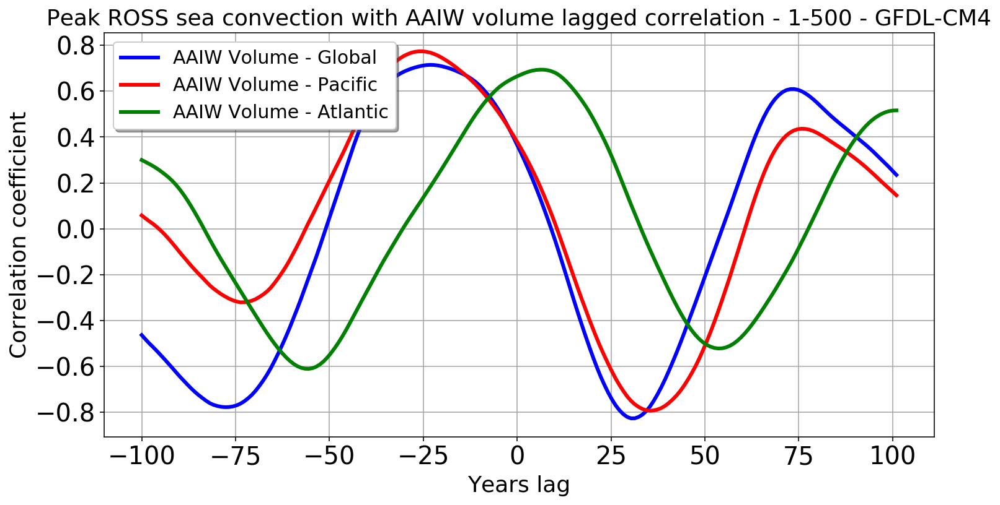

In [18]:
lag_time=100

fig=plt.figure()

lag_cor(ROSS_index_rm[:-9],AAIW_volume_rm[:-9],lag_time,'b','AAIW Volume - Global')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_pacfc_rm[:-9],lag_time,'r','AAIW Volume - Pacific')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_atl_rm[:-9],lag_time,'g','AAIW Volume - Atlantic')
plt.legend()
plt.title('Peak ROSS sea convection with AAIW volume lagged correlation - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_ROSSconvection_AAIW_vol_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

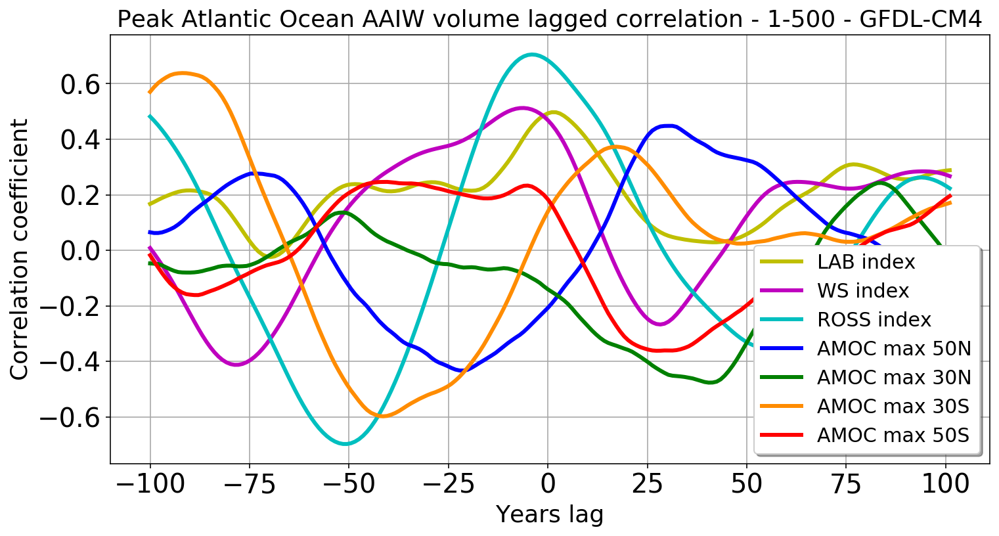

In [20]:
lag_time=100

fig=plt.figure()
lag_cor(AAIW_volume_atl_rm[:-9], LAB_index_rm[:-9], lag_time, 'y', 'LAB index')
lag_cor(AAIW_volume_atl_rm[:-9], WS_index_rm[:-9], lag_time, 'm', 'WS index')
lag_cor(AAIW_volume_atl_rm[:-9], ROSS_index_rm[:-9], lag_time, 'c', 'ROSS index')
lag_cor(AAIW_volume_atl_rm[:-9], AMOC_max_50N_m[:-9], lag_time, 'b', 'AMOC max 50N')
lag_cor(AAIW_volume_atl_rm[:-9], AMOC_max_30N_m[:-9], lag_time, 'g', 'AMOC max 30N')
lag_cor(AAIW_volume_atl_rm[:-9], AMOC_max_30S_m[:-9], lag_time, 'darkorange', 'AMOC max 30S')
lag_cor(AAIW_volume_atl_rm[:-9], AMOC_max_50S_m[:-9], lag_time, 'r', 'AMOC max 50S')
plt.legend()
plt.title('Peak Atlantic Ocean AAIW volume lagged correlation - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_AAIW_atlantic_vol_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

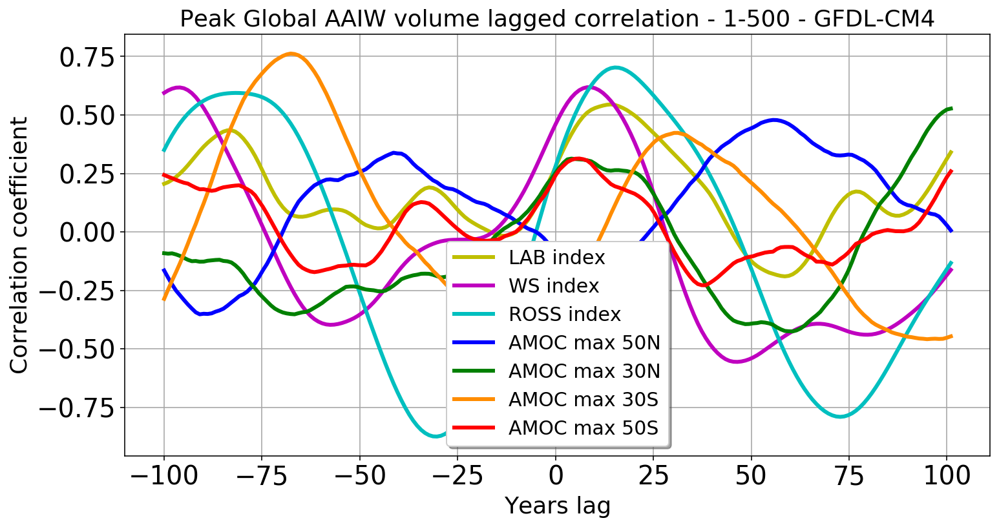

In [21]:
lag_time=100

fig=plt.figure()
lag_cor(AAIW_volume_rm[:-9], LAB_index_rm[:-9], lag_time, 'y', 'LAB index')
lag_cor(AAIW_volume_rm[:-9], WS_index_rm[:-9], lag_time, 'm', 'WS index')
lag_cor(AAIW_volume_rm[:-9], ROSS_index_rm[:-9], lag_time, 'c', 'ROSS index')
lag_cor(AAIW_volume_rm[:-9], AMOC_max_50N_m[:-9], lag_time, 'b', 'AMOC max 50N')
lag_cor(AAIW_volume_rm[:-9], AMOC_max_30N_m[:-9], lag_time, 'g', 'AMOC max 30N')
lag_cor(AAIW_volume_rm[:-9], AMOC_max_30S_m[:-9], lag_time, 'darkorange', 'AMOC max 30S')
lag_cor(AAIW_volume_rm[:-9], AMOC_max_50S_m[:-9], lag_time, 'r', 'AMOC max 50S')
plt.legend()
plt.title('Peak Global AAIW volume lagged correlation - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_AAIW_global_vol_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [13]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']; my_shelf.close()

lat_n=Lat_regrid_2D.shape[0] # Number of Lat elements in the data
lon_n=Lon_regrid_2D.shape[1] # Number of Lon elements in the data
earth_R = 6378 # Earth Radius - Unit is kilometer (km)
GridCell_Areas = np.zeros ((lat_n, lon_n )) # A = 2*pi*R^2 |sin(lat1)-sin(lat2)| |lon1-lon2|/360 = (pi/180)R^2 |lon1-lon2| |sin(lat1)-sin(lat2)| 
for ii in range(1,lat_n-1):
    for jj in range(1,lon_n-1):
        GridCell_Areas [ii,jj] = math.fabs( (earth_R**2) * (math.pi/180) * np.absolute( (Lon_regrid_2D[ii,jj-1]+Lon_regrid_2D[ii,jj])/2  -  (Lon_regrid_2D[ii,jj]+Lon_regrid_2D[ii,jj+1])/2 )  * np.absolute( math.sin(math.radians( ( Lat_regrid_2D[ii-1,jj]+Lat_regrid_2D[ii,jj])/2 )) - math.sin(math.radians( Lat_regrid_2D[ii,jj]+Lat_regrid_2D[ii+1,jj])/2  )) )                  
for ii in range(1,lat_n-1):
    for jj in range(2,lon_n-2):
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj-1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj-1]
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj+1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj+1]
GridCell_Areas[0,:]=GridCell_Areas[1,:]; GridCell_Areas[-1,:]=GridCell_Areas[-2,:]
GridCell_Areas[:,0]=GridCell_Areas[:,1]; GridCell_Areas[:,-1]=GridCell_Areas[:,-2] 
# GridCell_Areas unit = km2

GridCell_volume = np.full([Depths.shape[0],Lat_regrid_2D.shape[0],Lat_regrid_2D.shape[1]],np.nan)
for l in range(GridCell_volume.shape[0]):
    GridCell_volume[l,:,:] = GridCell_Areas * Depths[l]

##################################################################   
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

AAIW_volume_30S=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
    AAIW_volume_30S[t]= np.nansum(np.nansum(GridCell_volume_yr[:,60,:],axis=0),axis=0)

AAIW_volume_atl_30S=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    AAIW_volume_atl_30S[t]= np.nansum(np.nansum(GridCell_volume_yr[:,60,:],axis=0),axis=0)

AAIW_volume_pacfc_30S=np.full([Density_allyears.shape[0]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    AAIW_volume_pacfc_30S[t]= np.nansum(np.nansum(GridCell_volume_yr[:,60,:],axis=0),axis=0)

del Density_allyears

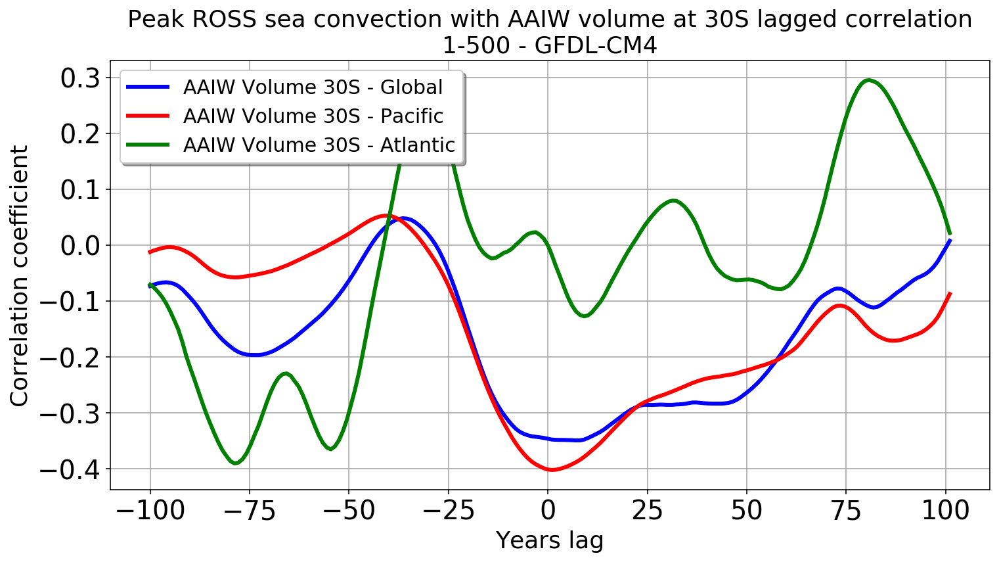

In [17]:
#Add AMOC and SMOC at 30S
#Add ACC
#Sal_max at 30S at Atlantic 
#Sal_min at 30S at Atlantic 
#Sal_max - Sal_min at 30S at Atlantic 


AAIW_volume_30S_rm = runningMeanFast(AAIW_volume_30S, 10)
AAIW_volume_atl_30S_rm = runningMeanFast(AAIW_volume_atl_30S, 10)
AAIW_volume_pacfc_30S_rm = runningMeanFast(AAIW_volume_pacfc_30S, 10)

lag_time=100

fig=plt.figure()

lag_cor(ROSS_index_rm[:-9],AAIW_volume_30S_rm[:-9],lag_time,'b','AAIW Volume 30S - Global')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_pacfc_30S_rm[:-9],lag_time,'r','AAIW Volume 30S - Pacific')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_atl_30S_rm[:-9],lag_time,'g','AAIW Volume 30S - Atlantic')
plt.legend()
plt.title('Peak ROSS sea convection with AAIW volume at 30S lagged correlation\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_ROSSconvection_AAIW_vol_30S_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [18]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Sal_max_atl_30S=[]
Sal_min_atl_30S=[]
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,14:,60,:] # Salinity at 30S removing the top 500m layers
    data_i_2=copy.deepcopy(data_i)
    data_i_2[:,0:180] = data_i[:,180:]
    data_i_2[:,180:] = data_i[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]
    data_i = data_i_2[:,125:200] # Keep Atlantic only
    
    Sal_max_atl_30S.append(np.nanmax(np.nanmax(data_i, axis=0), axis=0))
    Sal_min_atl_30S.append(np.nanmin(np.nanmin(data_i, axis=0), axis=0))

Sal_max_atl_30S = np.asarray(Sal_max_atl_30S)
Sal_min_atl_30S = np.asarray(Sal_min_atl_30S)

del Salinity_allyears

Sal_max_atl_30S_rm = runningMeanFast(Sal_max_atl_30S, 10)
Sal_min_atl_30S_rm = runningMeanFast(Sal_min_atl_30S, 10)

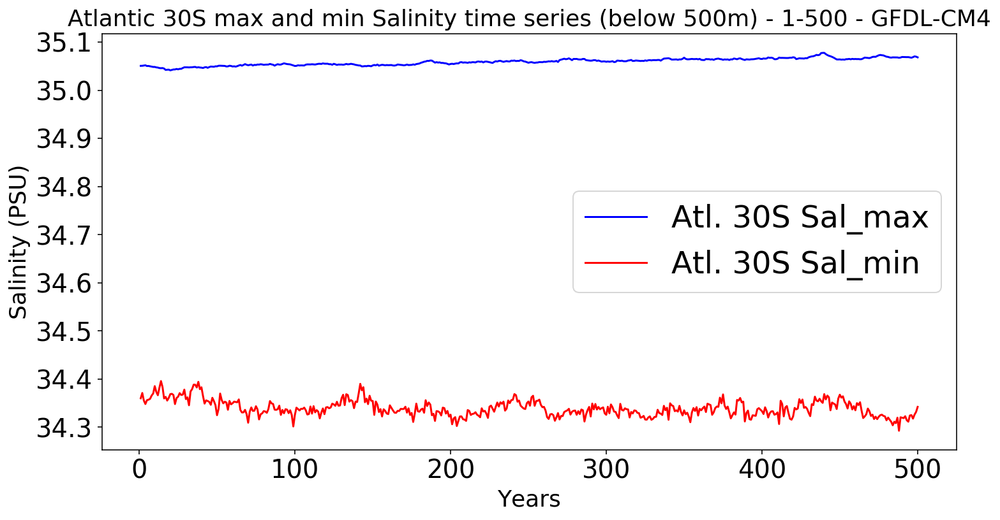

In [27]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
plt.plot(years,Sal_max_atl_30S,'b',label = 'Atl. 30S Sal_max')
plt.plot(years,Sal_min_atl_30S,'r',label = 'Atl. 30S Sal_min')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Salinity (PSU)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Atlantic 30S max and min Salinity time series (below 500m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_atl_30S_sal_maxmin.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

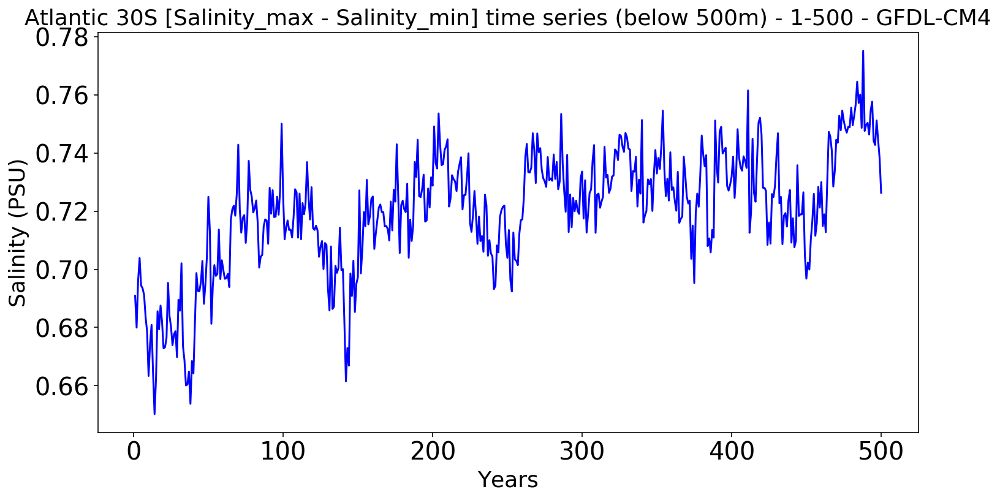

In [29]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
plt.plot(years,Sal_max_atl_30S - Sal_min_atl_30S,'b')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Salinity (PSU)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Atlantic 30S [Salinity_max - Salinity_min] time series (below 500m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_atl_30S_sal_max_minus_min.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

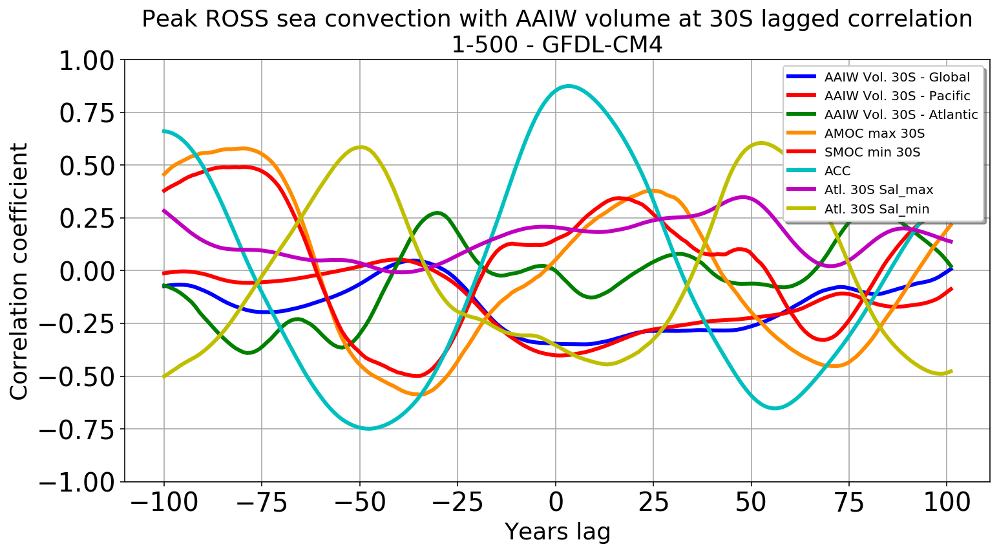

In [32]:
#Sal_max at 30S at Atlantic 
#Sal_min at 30S at Atlantic 
#Sal_max - Sal_min at 30S at Atlantic 

AAIW_volume_30S_rm = runningMeanFast(AAIW_volume_30S, 10)
AAIW_volume_atl_30S_rm = runningMeanFast(AAIW_volume_atl_30S, 10)
AAIW_volume_pacfc_30S_rm = runningMeanFast(AAIW_volume_pacfc_30S, 10)

ACC_time_series = np.load('500yr_ACC_GFDL-CM4.npy')
ACC_time_series=ACC_time_series.reshape(500 ,12)
ACC_time_series = np.nanmean(ACC_time_series, axis=1)
ACC_time_series.shape
ACC_time_series_rm = runningMeanFast(ACC_time_series, 10)

lag_time=100

fig=plt.figure()

lag_cor(ROSS_index_rm[:-9],AAIW_volume_30S_rm[:-9],lag_time,'b','AAIW Vol. 30S - Global')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_pacfc_30S_rm[:-9],lag_time,'r','AAIW Vol. 30S - Pacific')
lag_cor(ROSS_index_rm[:-9],AAIW_volume_atl_30S_rm[:-9],lag_time,'g','AAIW Vol. 30S - Atlantic')
lag_cor(ROSS_index_rm[:-9], AMOC_max_30S_m[:-9], lag_time, 'darkorange', 'AMOC max 30S')
lag_cor(ROSS_index_rm[:-9], SMOC_min_30S_m[:-9], lag_time, 'r', 'SMOC min 30S')
lag_cor(ROSS_index_rm[:-9], ACC_time_series_rm[:-9], lag_time, 'c', 'ACC')
lag_cor(ROSS_index_rm[:-9], Sal_max_atl_30S_rm[:-9], lag_time, 'm', 'Atl. 30S Sal_max')
lag_cor(ROSS_index_rm[:-9], Sal_min_atl_30S_rm[:-9], lag_time, 'y', 'Atl. 30S Sal_min')

plt.legend()
plt.title('Peak ROSS sea convection with AAIW volume at 30S lagged correlation\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 10})
mng = plt.get_current_fig_manager()
plt.ylim(-1,1)
#fig.savefig(dir_figs+str(GCM)+'_lagcor_ROSSconvection_AAIW_vol_30S_2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [35]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']; my_shelf.close()

lat_n=Lat_regrid_2D.shape[0] # Number of Lat elements in the data
lon_n=Lon_regrid_2D.shape[1] # Number of Lon elements in the data
earth_R = 6378 # Earth Radius - Unit is kilometer (km)
GridCell_Areas = np.zeros ((lat_n, lon_n )) # A = 2*pi*R^2 |sin(lat1)-sin(lat2)| |lon1-lon2|/360 = (pi/180)R^2 |lon1-lon2| |sin(lat1)-sin(lat2)| 
for ii in range(1,lat_n-1):
    for jj in range(1,lon_n-1):
        GridCell_Areas [ii,jj] = math.fabs( (earth_R**2) * (math.pi/180) * np.absolute( (Lon_regrid_2D[ii,jj-1]+Lon_regrid_2D[ii,jj])/2  -  (Lon_regrid_2D[ii,jj]+Lon_regrid_2D[ii,jj+1])/2 )  * np.absolute( math.sin(math.radians( ( Lat_regrid_2D[ii-1,jj]+Lat_regrid_2D[ii,jj])/2 )) - math.sin(math.radians( Lat_regrid_2D[ii,jj]+Lat_regrid_2D[ii+1,jj])/2  )) )                  
for ii in range(1,lat_n-1):
    for jj in range(2,lon_n-2):
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj-1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj-1]
        if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj+1]*3:
            GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj+1]
GridCell_Areas[0,:]=GridCell_Areas[1,:]; GridCell_Areas[-1,:]=GridCell_Areas[-2,:]
GridCell_Areas[:,0]=GridCell_Areas[:,1]; GridCell_Areas[:,-1]=GridCell_Areas[:,-2] 
# GridCell_Areas unit = km2

GridCell_volume = np.full([Depths.shape[0],Lat_regrid_2D.shape[0],Lat_regrid_2D.shape[1]],np.nan)
for l in range(GridCell_volume.shape[0]):
    GridCell_volume[l,:,:] = GridCell_Areas * Depths[l]

##################################################################   
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy') # Density_allyears.shape = (500, 35, 181, 360)

AAIW_volume_atl_lat=np.full([Density_allyears.shape[0], Density_allyears.shape[2]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    AAIW_volume_atl_lat[t,:]= np.nansum(np.nansum(GridCell_volume_yr,axis=0),axis=1)

AAIW_volume_pacfc_lat=np.full([Density_allyears.shape[0], Density_allyears.shape[2]],np.nan)
for t in tqdm(range(Density_allyears.shape[0])):
    GridCell_volume_yr = copy.deepcopy(GridCell_volume)
    for l in range(Density_allyears.shape[1]):
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        GridCell_volume_yr[l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        GridCell_volume_yr[l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    AAIW_volume_pacfc_lat[t,:]= np.nansum(np.nansum(GridCell_volume_yr,axis=0),axis=1)

del Density_allyears

distributed.utils_perf - INFO - full garbage collection released 23.79 MB from 88816 reference cycles (threshold: 10.00 MB)


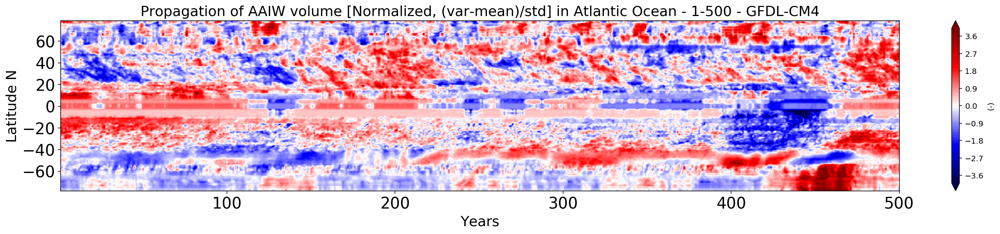

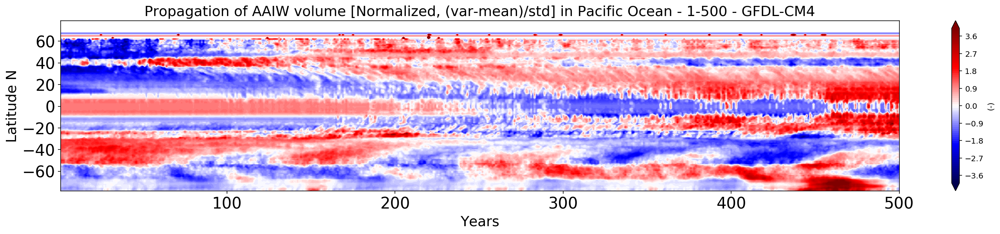

In [36]:
Plot_range=np.linspace(-4,4,81)

Var_plot = AAIW_volume_atl_lat
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of AAIW volume [Normalized, (var-mean)/std] in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

plt.show()

Var_plot = AAIW_volume_pacfc_lat
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of AAIW volume [Normalized, (var-mean)/std] in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_time_lat_pacfc_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [39]:
GCM = GCM_name
import os; import shelve

############################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_ROSS.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['ROSS_index']=my_shelf['ROSS_index']; my_shelf.close()

ROSS_index_rm = copy.deepcopy(ROSS_index)

#multiplying by -1 as we have convection when temperature is low(opposite to the index which we calculate)
ROSS_index_rm=runningMeanFast(ROSS_index_rm, 10)
ROSS_index_rm=ROSS_index_rm*(-1)

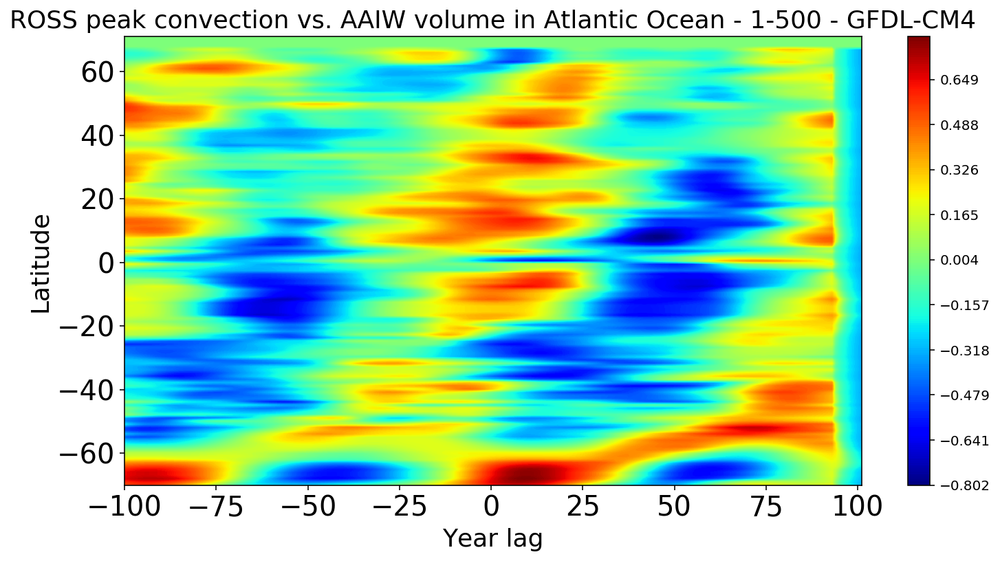

In [44]:
#### Ross plots ####
lag_time=100

fig=plt.figure()
data=[]
for i in range(len(AAIW_volume_atl_lat[0][20:161])):
    stream=runningMeanFast(AAIW_volume_atl_lat[:,i+35], 10)
    r=lag_cor_data(ROSS_index_rm,stream,lag_time)
    data.append(r)
data=np.asarray(data)
x=np.linspace(-lag_time,lag_time+1, 2*lag_time)
y=np.linspace(-70,70+1, 2*70+1)

x,y=np.meshgrid(x,y)
cmap_limit=np.nanmax(np.abs(data))
levels=np.linspace(-cmap_limit,cmap_limit,200)
im=plt.contourf(x,y,data,levels,latlon=True, cmap=plt.cm.jet)
cb = plt.colorbar(im)
plt.xlabel('Year lag', fontsize=18)
plt.ylabel('Latitude', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('ROSS peak convection vs. AAIW volume in Atlantic Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_convec_AAIW_atlantic_ROSS_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

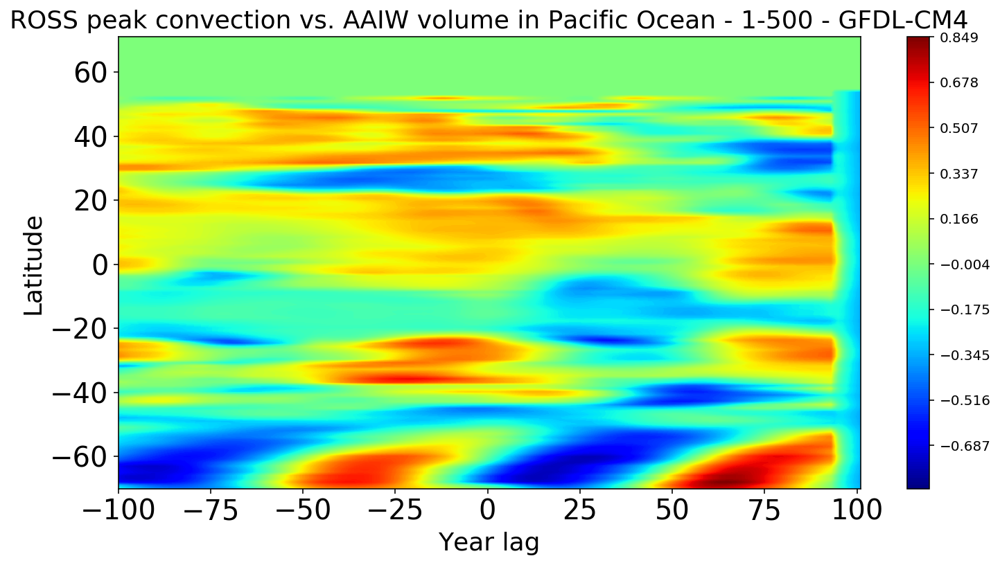

In [45]:
#### Ross plots ####
lag_time=100

fig=plt.figure()
data=[]
for i in range(len(AAIW_volume_pacfc_lat[0][20:161])):
    stream=runningMeanFast(AAIW_volume_pacfc_lat[:,i+35], 10)
    r=lag_cor_data(ROSS_index_rm,stream,lag_time)
    data.append(r)
data=np.asarray(data)
x=np.linspace(-lag_time,lag_time+1, 2*lag_time)
y=np.linspace(-70,70+1, 2*70+1)

x,y=np.meshgrid(x,y)
cmap_limit=np.nanmax(np.abs(data))
levels=np.linspace(-cmap_limit,cmap_limit,200)
im=plt.contourf(x,y,data,levels,latlon=True, cmap=plt.cm.jet)
cb = plt.colorbar(im)
plt.xlabel('Year lag', fontsize=18)
plt.ylabel('Latitude', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('ROSS peak convection vs. AAIW volume in Pacific Ocean - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_convec_AAIW_pacific_ROSS_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [18]:
for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        

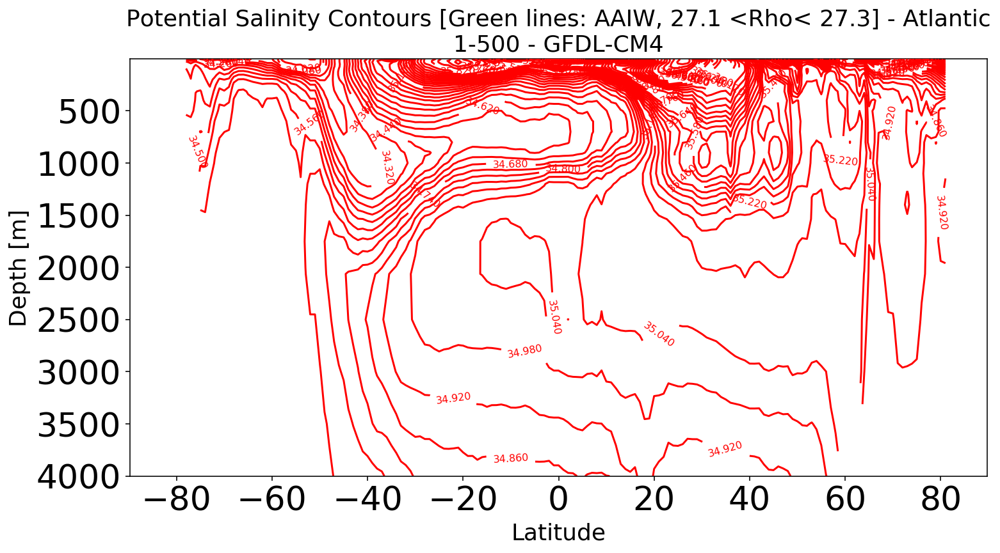

In [18]:
P_Var_x1=Lat_regrid_1D
P_Var_y1=Depths[0:30]
P_Var_z1=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:30,:]
P_xlable='Latitude'  ;P_ylable='Depth [m]'
P_title='Potential Salinity Contours [Green lines: AAIW, 27.1 <Rho< 27.3] - Atlantic\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig = func_plot2Dcontour_1var(P_Var_x1, P_Var_y1, P_Var_z1, P_xlable, P_ylable, P_title, 'r', 80, 'invert_yaxis')


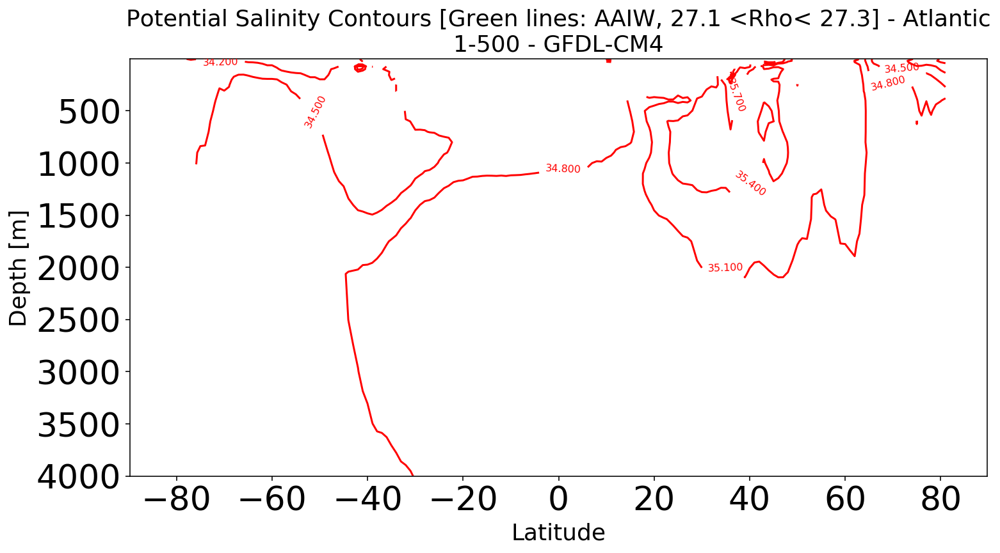

In [19]:
P_Var_x1=Lat_regrid_1D
P_Var_y1=Depths[0:30]
P_Var_z1=np.nanmean(Salinity_allyears,axis=0)
for ii in range(P_Var_z1.shape[0]):
    P_Var_z1[ii,:,:][Ocean_Index!=6]=np.nan # Atlantic Ocean only
P_Var_z1=np.nanmean(P_Var_z1,axis=2)
P_Var_z1=P_Var_z1[0:30,:]
P_xlable='Latitude'  ;P_ylable='Depth [m]'
P_title='Potential Salinity Contours [Green lines: AAIW, 27.1 <Rho< 27.3] - Atlantic\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig = func_plot2Dcontour_1var(P_Var_x1, P_Var_y1, P_Var_z1, P_xlable, P_ylable, P_title, 'r', 80, 'invert_yaxis')


distributed.utils_perf - INFO - full garbage collection released 26.74 MB from 89198 reference cycles (threshold: 10.00 MB)


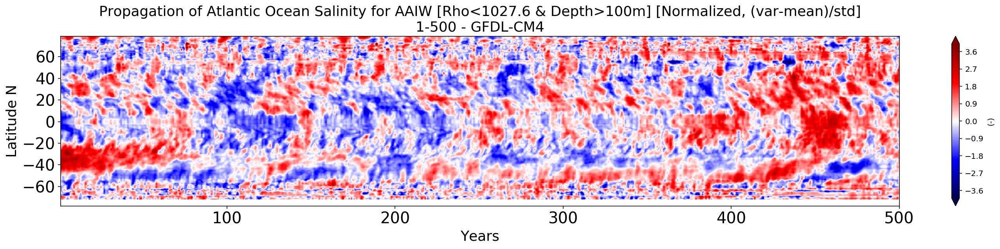

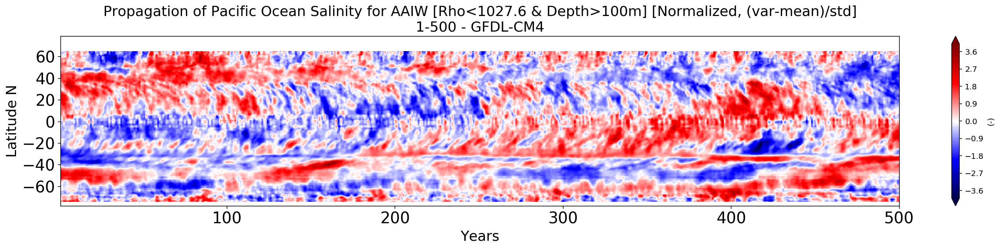

In [24]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        
Salinity_time_lat_atl_AAIW_to_100m=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_AAIW_to_100m.append(np.nanmean(data_i,axis=1))    
Salinity_time_lat_atl_AAIW_to_100m = np.asarray(Salinity_time_lat_atl_AAIW_to_100m)

Salinity_time_lat_pacfc_AAIW_to_100m=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Salinity_time_lat_pacfc_AAIW_to_100m.append(np.nanmean(data_i,axis=1))    
Salinity_time_lat_pacfc_AAIW_to_100m = np.asarray(Salinity_time_lat_pacfc_AAIW_to_100m)

del Salinity_allyears
del Density_allyears
#############################################################################################
#############################################################################################
Plot_range=np.linspace(-4,4,81)
                       
Var_plot = Salinity_time_lat_atl_AAIW_to_100m
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Atlantic Ocean Salinity for AAIW [Rho<1027.6 & Depth>100m] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

Var_plot = Salinity_time_lat_pacfc_AAIW_to_100m
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Pacific Ocean Salinity for AAIW [Rho<1027.6 & Depth>100m] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_pacfc_AAIW_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


distributed.utils_perf - INFO - full garbage collection released 21.42 MB from 89195 reference cycles (threshold: 10.00 MB)


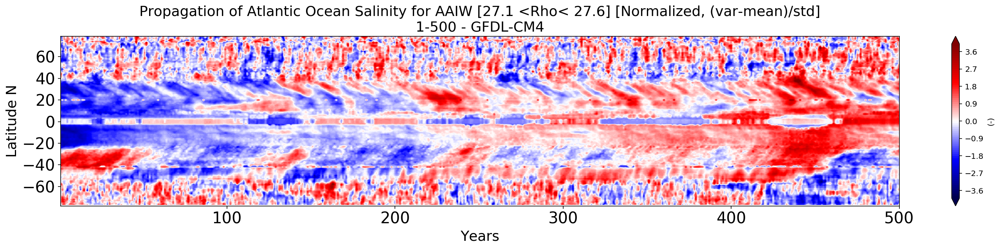

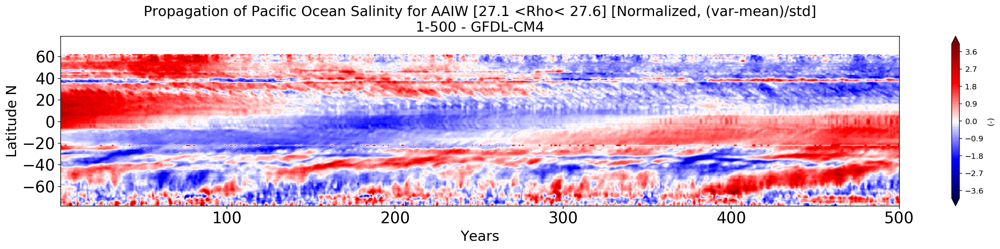

In [25]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][Density_allyears[t,l,:,:] > 1027.6] = np.nan
        Salinity_allyears[t,l,:,:][Density_allyears[t,l,:,:] < 1027.1] = np.nan
        
Salinity_time_lat_atl_AAIW=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,:,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
    Salinity_time_lat_atl_AAIW.append(np.nanmean(data_i,axis=1))    
Salinity_time_lat_atl_AAIW = np.asarray(Salinity_time_lat_atl_AAIW)

Salinity_time_lat_pacfc_AAIW=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,:,:,:]
    data_i = np.nanmean(data_i, axis=0)
    data_i[ Ocean_Index!=2 ] = np.nan # Keep Pacific only
    Salinity_time_lat_pacfc_AAIW.append(np.nanmean(data_i,axis=1))    
Salinity_time_lat_pacfc_AAIW = np.asarray(Salinity_time_lat_pacfc_AAIW)

del Salinity_allyears
del Density_allyears
#############################################################################################
#############################################################################################
Plot_range=np.linspace(-4,4,81)

Var_plot = Salinity_time_lat_atl_AAIW
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Atlantic Ocean Salinity for AAIW [27.1 <Rho< 27.6] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

Var_plot = Salinity_time_lat_pacfc_AAIW
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Pacific Ocean Salinity for AAIW [27.1 <Rho< 27.6] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_pacfc_AAIW_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


distributed.utils_perf - INFO - full garbage collection released 17.79 MB from 54521 reference cycles (threshold: 10.00 MB)


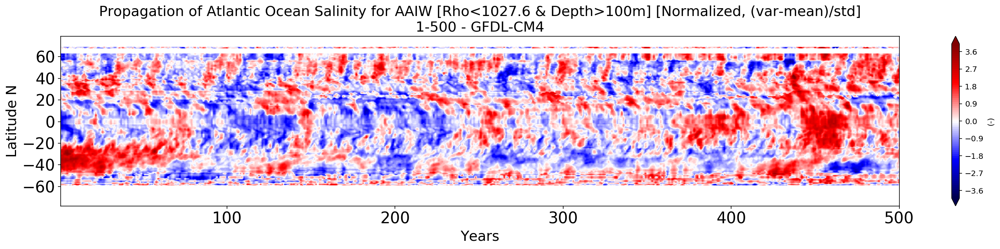

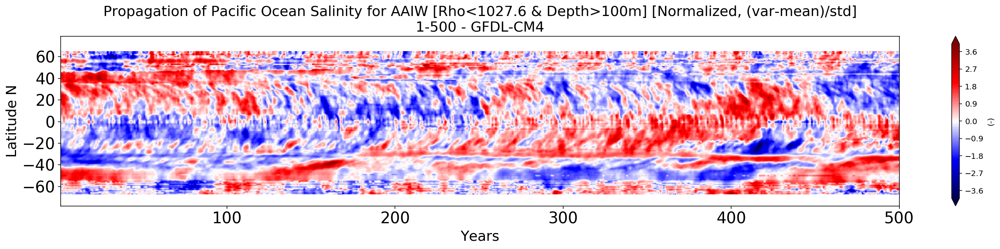

In [26]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
        Density_allyears[t,l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
        
Salinity_time_lat_atl_AAIW_to_100m=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i = np.nanmean(data_i, axis=2) # Averaging over longitude
    data_i_2=Density_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i_2 = np.nanmean(data_i_2, axis=2) # Averaging over longitude
    data_i[data_i_2 > 1027.6] = np.nan
   
    Salinity_time_lat_atl_AAIW_to_100m.append(np.nanmean(data_i,axis=0))    
Salinity_time_lat_atl_AAIW_to_100m = np.asarray(Salinity_time_lat_atl_AAIW_to_100m)

del Salinity_allyears
del Density_allyears

Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
        Density_allyears[t,l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
        
Salinity_time_lat_pacfc_AAIW_to_100m=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i = np.nanmean(data_i, axis=2) # Averaging over longitude
    data_i_2=Density_allyears[t,6:,:,:] # Removing the top 100m layers
    data_i_2 = np.nanmean(data_i_2, axis=2) # Averaging over longitude
    data_i[data_i_2 > 1027.6] = np.nan
   
    Salinity_time_lat_pacfc_AAIW_to_100m.append(np.nanmean(data_i,axis=0))    
Salinity_time_lat_pacfc_AAIW_to_100m = np.asarray(Salinity_time_lat_pacfc_AAIW_to_100m)

del Salinity_allyears
del Density_allyears
#############################################################################################
#############################################################################################
Plot_range=np.linspace(-4,4,81)

Var_plot = Salinity_time_lat_atl_AAIW_to_100m
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Atlantic Ocean Salinity for AAIW [Rho<1027.6 & Depth>100m] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

Var_plot = Salinity_time_lat_pacfc_AAIW_to_100m
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Pacific Ocean Salinity for AAIW [Rho<1027.6 & Depth>100m] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_pacfc_AAIW_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


distributed.utils_perf - INFO - full garbage collection released 14.49 MB from 88722 reference cycles (threshold: 10.00 MB)


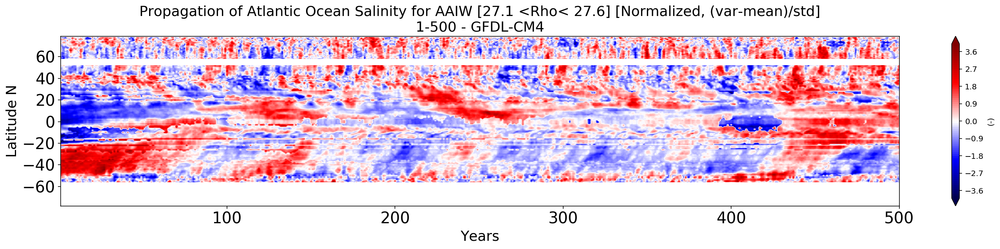

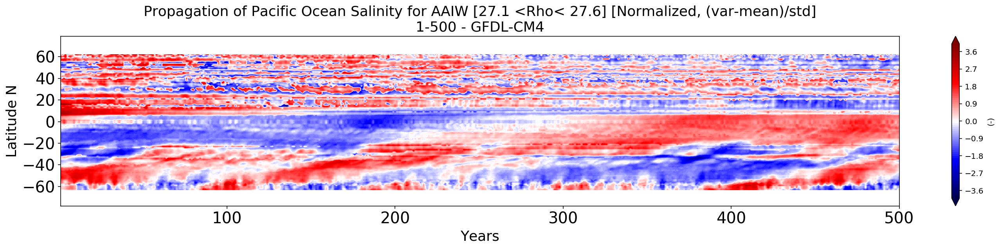

In [27]:
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
        Density_allyears[t,l,:,:][ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
        
Salinity_time_lat_atl_AAIW=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,:,:,:]
    data_i = np.nanmean(data_i, axis=2) # Averaging over longitude
    data_i_2=Density_allyears[t,:,:,:]
    data_i_2 = np.nanmean(data_i_2, axis=2) # Averaging over longitude
    data_i[data_i_2 > 1027.3] = np.nan
    data_i[data_i_2 < 1027.1] = np.nan
   
    Salinity_time_lat_atl_AAIW.append(np.nanmean(data_i,axis=0))    
Salinity_time_lat_atl_AAIW = np.asarray(Salinity_time_lat_atl_AAIW)

del Salinity_allyears
del Density_allyears

Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

for t in tqdm(range(Salinity_allyears.shape[0])):
    for l in range(Salinity_allyears.shape[1]):
        Salinity_allyears[t,l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
        Density_allyears[t,l,:,:][ Ocean_Index!=2 ] = np.nan # Keep Pacific only
        
Salinity_time_lat_pacfc_AAIW=[] 
for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,:,:,:]
    data_i = np.nanmean(data_i, axis=2) # Averaging over longitude
    data_i_2=Density_allyears[t,:,:,:]
    data_i_2 = np.nanmean(data_i_2, axis=2) # Averaging over longitude
    data_i[data_i_2 > 1027.3] = np.nan
    data_i[data_i_2 < 1027.1] = np.nan
   
    Salinity_time_lat_pacfc_AAIW.append(np.nanmean(data_i,axis=0))    
Salinity_time_lat_pacfc_AAIW = np.asarray(Salinity_time_lat_pacfc_AAIW)

del Salinity_allyears
del Density_allyears
#############################################################################################
#############################################################################################
Plot_range=np.linspace(-4,4,81)

Var_plot = Salinity_time_lat_atl_AAIW
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Atlantic Ocean Salinity for AAIW [27.1 <Rho< 27.6] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()

Var_plot = Salinity_time_lat_pacfc_AAIW
aa = np.nanmean(Var_plot,axis=0)
cc = np.std(Var_plot,axis=0)
bb = copy.deepcopy(Var_plot)
dd = copy.deepcopy(Var_plot)
for ii in range(Var_plot.shape[0]):
    bb[ii,:]=aa
    dd[ii,:]=cc

fig=plt.figure(figsize=(24,4))
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Lat_regrid_1D[12:170], np.transpose( (Var_plot[:,12:170]-bb[:,12:170])/dd[:,12:170] ), Plot_range, cmap=plt.cm.seismic, extend='both')
#plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Latitude N', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Propagation of Pacific Ocean Salinity for AAIW [27.1 <Rho< 27.6] [Normalized, (var-mean)/std]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(-)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_salinity_time_lat_atl_pacfc_AAIW_norm.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [14]:
df_plt = df[(df.variable_id == 'vo') & (df.experiment_id == 'piControl')& (df.source_id=='GFDL-CM4')]
#df_plt = df_plt[ df_plt['grid_label'] == 'gr']
run_counts = df_plt.groupby(['source_id', 'experiment_id'])['zstore'].count()
run_counts

source_id  experiment_id
GFDL-CM4   piControl        1
Name: zstore, dtype: int64

In [15]:
uri_vo = df_plt[(df_plt.source_id == GCM_name)].zstore.values[0]
ds_vo = func_load_ds_uri(uri_vo)
#ds_vo

In [16]:
Lon_orig=ds_vo.lon.values
Lat_orig=ds_vo.lat.values

Depths=ds_vo.lev.values
Depths

array([2.5000e+00, 1.0000e+01, 2.0000e+01, 3.2500e+01, 5.1250e+01,
       7.5000e+01, 1.0000e+02, 1.2500e+02, 1.5625e+02, 2.0000e+02,
       2.5000e+02, 3.1250e+02, 4.0000e+02, 5.0000e+02, 6.0000e+02,
       7.0000e+02, 8.0000e+02, 9.0000e+02, 1.0000e+03, 1.1000e+03,
       1.2000e+03, 1.3000e+03, 1.4000e+03, 1.5375e+03, 1.7500e+03,
       2.0625e+03, 2.5000e+03, 3.0000e+03, 3.5000e+03, 4.0000e+03,
       4.5000e+03, 5.0000e+03, 5.5000e+03, 6.0000e+03, 6.5000e+03])

In [56]:
VO_30S_allyears = []
yrs_no = np.int(len(ds_vo.time)/12)
Lon_orig=ds_vo.lon.values
Lat_orig=ds_vo.lat.values

for t in tqdm(range(yrs_no)):
    data_vo_extracted = ds_vo.vo.isel(time= slice(12*t,12*t+12) , y=377 ).values ## y=377: Lat=30.023 S ## data_vo_extracted.shape = (12, 35, 1080, 1440)
    data_vo_extracted = np.nanmean(data_vo_extracted, axis=0)
    
    VO_30S_allyears.append(data_vo_extracted)

VO_30S_allyears = np.asarray(VO_30S_allyears)

np.save('VO_30S_allyears_GFDL-CM4_500yr.npy', VO_30S_allyears)


In [17]:
VO_30S_allyears=np.load('VO_30S_allyears_GFDL-CM4_500yr.npy')

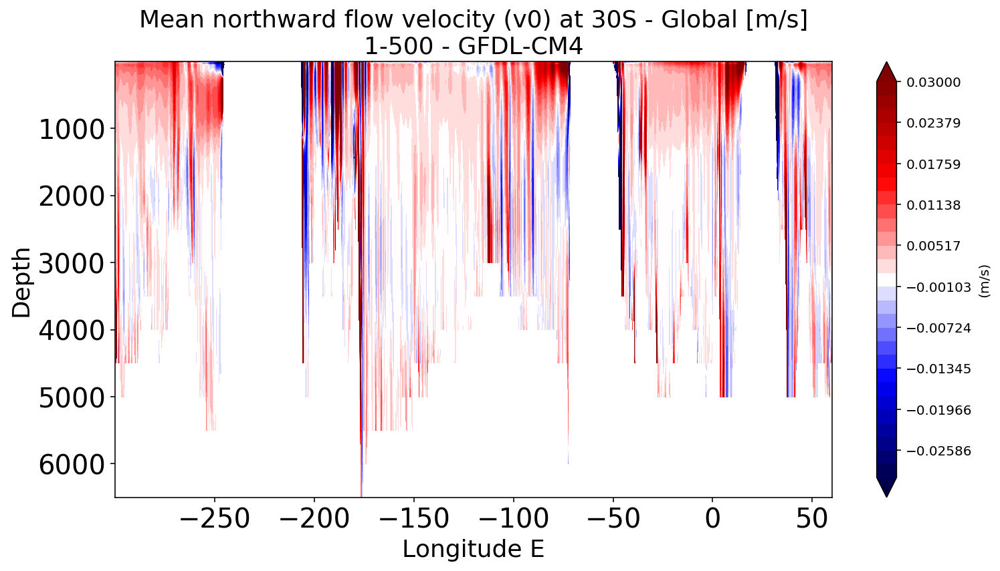

In [71]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,:], Depths, np.nanmean(VO_30S_allyears,axis=0), levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Global [m/s]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_global_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

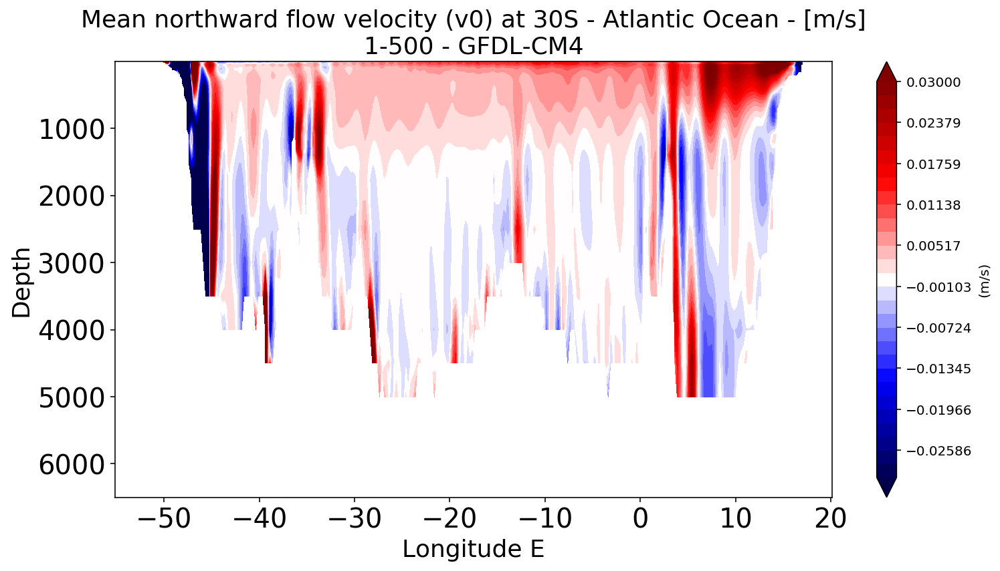

In [72]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,979:1281], Depths, np.nanmean(VO_30S_allyears,axis=0)[:,979:1281], levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Atlantic Ocean - [m/s]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_atlantic_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

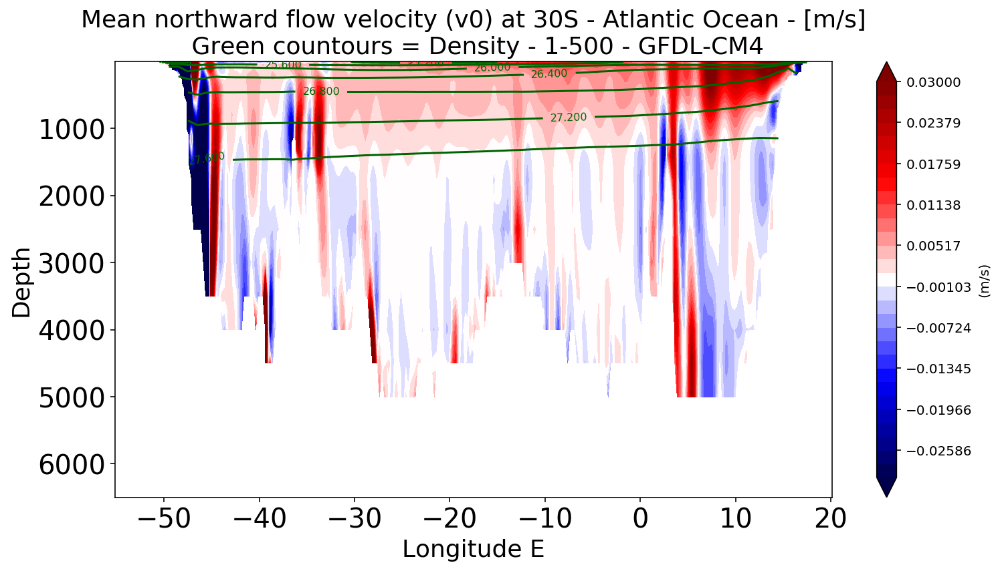

distributed.utils_perf - INFO - full garbage collection released 61.85 MB from 25020 reference cycles (threshold: 10.00 MB)


In [86]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,979:1281], Depths, np.nanmean(VO_30S_allyears,axis=0)[:,979:1281], levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Atlantic Ocean - [m/s]\n Green countours = Density - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')

P_Var_x1=P_Var_x2=Lon_regrid_1D-180
P_Var_z1_0=np.nanmean(np.load('Density_allyears_GFDL-CM4_500yr.npy')[:,:,60,:],axis=0) -1000
P_Var_z1[:,0:180] = P_Var_z1_0[:,180:]
P_Var_z1[:,180:] = P_Var_z1_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]
im2=plt.contour(P_Var_x1[125:200], Depths, P_Var_z1[:,125:200], 10, latlon=True, colors='darkgreen')
plt.clabel(im2, fontsize=8, inline=1)

mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_atlantic_dens_countour_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

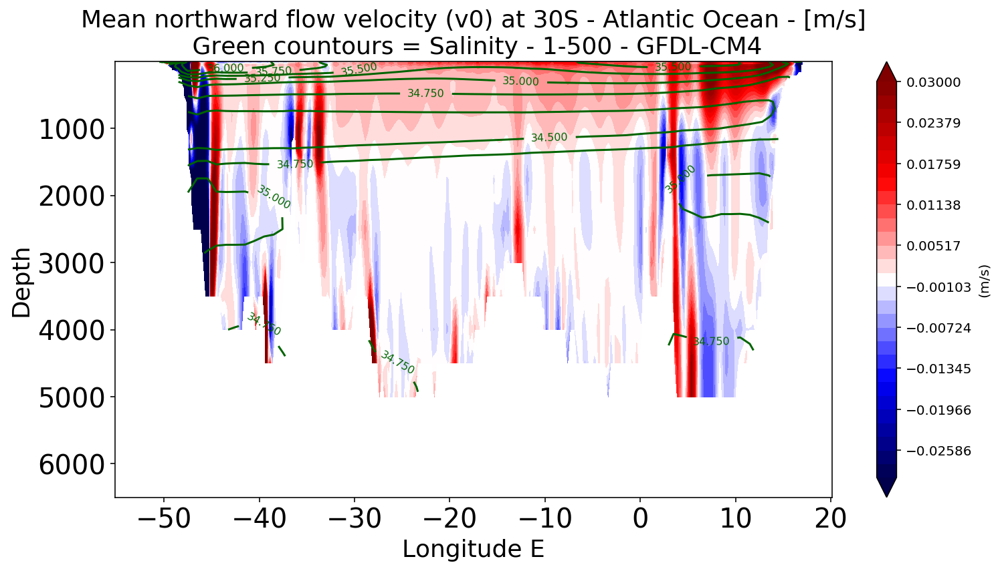

In [85]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,979:1281], Depths, np.nanmean(VO_30S_allyears,axis=0)[:,979:1281], levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Atlantic Ocean - [m/s]\n Green countours = Salinity - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')

P_Var_x1=P_Var_x2=Lon_regrid_1D-180
P_Var_z1_0=np.nanmean(np.load('Salinity_allyears_GFDL-CM4_500yr.npy')[:,:,60,:],axis=0)
P_Var_z1[:,0:180] = P_Var_z1_0[:,180:]
P_Var_z1[:,180:] = P_Var_z1_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]
im2=plt.contour(P_Var_x1[125:200], Depths, P_Var_z1[:,125:200], 10, latlon=True, colors='darkgreen')
plt.clabel(im2, fontsize=8, inline=1)

mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_atlantic_salin_countour_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [90]:
VO_30S_allyears.shape

(500, 35, 1440)

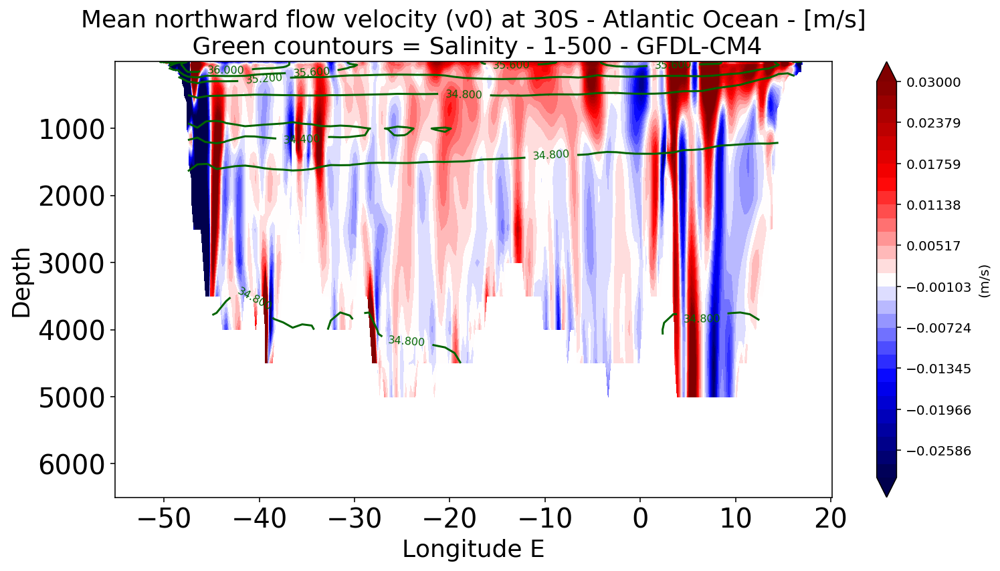

distributed.scheduler - INFO - Remove worker tcp://10.32.85.17:37229
distributed.core - INFO - Removing comms to tcp://10.32.85.17:37229
distributed.scheduler - INFO - Lost all workers


In [91]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,979:1281], Depths, VO_30S_allyears[0,:,979:1281], levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Atlantic Ocean - [m/s]\n Green countours = Salinity - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')

P_Var_x1=P_Var_x2=Lon_regrid_1D-180
P_Var_z1_0=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')[0,:,60,:]
P_Var_z1=copy.deepcopy(P_Var_z1_0)
P_Var_z1[:,0:180] = P_Var_z1_0[:,180:]
P_Var_z1[:,180:] = P_Var_z1_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]
im2=plt.contour(P_Var_x1[125:200], Depths, P_Var_z1[:,125:200], 10, latlon=True, colors='darkgreen')
plt.clabel(im2, fontsize=8, inline=1)

mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_atlantic_salin_countour_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

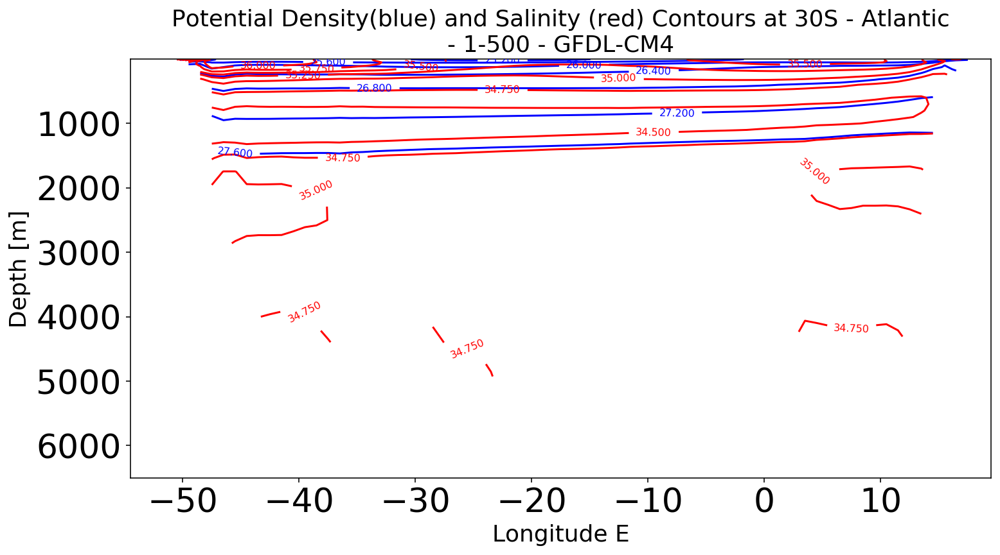

In [73]:
P_Var_x1=P_Var_x2=Lon_regrid_1D-180
P_Var_y1=P_Var_y2=Depths

P_Var_z1_0=np.nanmean(np.load('Density_allyears_GFDL-CM4_500yr.npy')[:,:,60,:],axis=0) -1000
P_Var_z1=copy.deepcopy(P_Var_z1_0)
P_Var_z1[:,0:180] = P_Var_z1_0[:,180:]
P_Var_z1[:,180:] = P_Var_z1_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]

P_Var_z2_0=np.nanmean(np.load('Salinity_allyears_GFDL-CM4_500yr.npy')[:,:,60,:],axis=0)
P_Var_z2=copy.deepcopy(P_Var_z2_0)
P_Var_z2[:,0:180] = P_Var_z2_0[:,180:]
P_Var_z2[:,180:] = P_Var_z2_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]

P_title='Potential Density(blue) and Salinity (red) Contours at 30S - Atlantic\n- '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
P_xlable='Longitude E'  ;P_ylable='Depth [m]'
fig = func_plot2Dcontour_2var(P_Var_x1[125:200], P_Var_y1, P_Var_z1[:,125:200], P_Var_x2[125:200], P_Var_y2, P_Var_z2[:,125:200], P_xlable, P_ylable, P_title, 'b', 'r', 10, 'invert_yaxis')

#fig.savefig(dir_figs+str(GCM)+'_Density_Salinity_Atlantic_30S_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
Density_sigma2_allyears = []
yrs_no = np.int(len(ds_thetao.time)/12)
Lon_orig=ds_thetao.lon.values
Lat_orig=ds_thetao.lat.values

#import seawater as sw
import gsw
for t in tqdm(range(100)):
    data_thetao_extracted = ds_thetao.thetao.isel(time= slice(12*t,12*t+12) ).values
    data_so_extracted = ds_so.so.isel(time= slice(12*t,12*t+12) ).values
    #data_dens=sw.dens0(data_so_extracted, data_thetao_extracted)
    data_dens=gsw.density.sigma2(data_so_extracted, data_thetao_extracted)
    data_dens = np.nanmean(data_dens, axis=0)
    data_i = func_regrid(data_dens, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Density_sigma2_allyears.append(data_i)

Density_sigma2_allyears = np.asarray(Density_sigma2_allyears)

np.save('Density_sigma2_allyears_GFDL-CM4_100yr.npy', Density_sigma2_allyears)

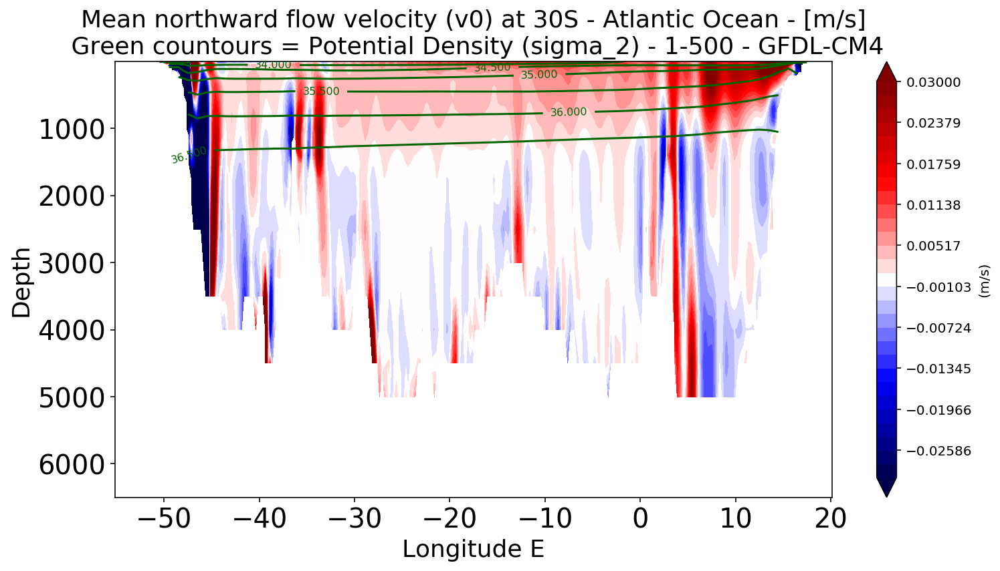

In [22]:
levels=np.linspace(-0.03,0.03,30)
fig=plt.figure()
im=plt.contourf(Lon_orig[377,979:1281], Depths, np.nanmean(VO_30S_allyears,axis=0)[:,979:1281], levels, cmap=plt.cm.seismic, extend = 'both')
plt.gca().invert_yaxis()
plt.xlabel('Longitude E', fontsize=18)
plt.ylabel('Depth', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Mean northward flow velocity (v0) at 30S - Atlantic Ocean - [m/s]\n Green countours = Potential Density (sigma_2) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(m/s)')

P_Var_x1=P_Var_x2=Lon_regrid_1D-180
P_Var_z1_0=np.nanmean(np.load('Density_sigma2_allyears_GFDL-CM4_100yr.npy')[:,:,60,:],axis=0)
P_Var_z1=copy.deepcopy(P_Var_z1_0)
P_Var_z1[:,0:180] = P_Var_z1_0[:,180:]
P_Var_z1[:,180:] = P_Var_z1_0[:,0:180] # Converting longitude from [0 : 360] to [-180 : 180]
im2=plt.contour(P_Var_x1[125:200], Depths, P_Var_z1[:,125:200], 10, latlon=True, colors='darkgreen')
plt.clabel(im2, fontsize=8, inline=1)

mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_Flow_Velocity_vo_30S_atlantic_dens_sigma2_countour_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

Text(0.5, 1.0, 'Average MLD [m] (Labrador Sea) - 1-500 - GFDL-CM4')

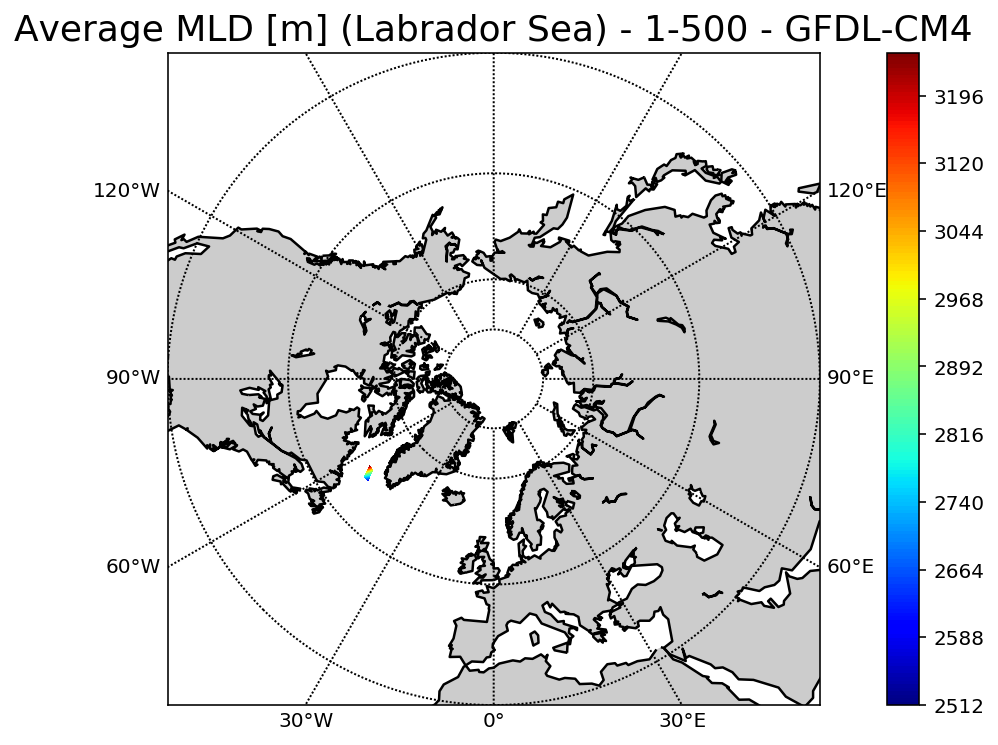

In [25]:
aaa=copy.deepcopy(MLD_average_LAB)
aaa[aaa < 2500] = np.nan

fig=plt.figure()
# if hemis_no==0:
#     m = Basemap( projection='spstere',lon_0=0,boundinglat=-30)
# else:
#     m = Basemap( projection='npstere',lon_0=0,boundinglat=30)
m = Basemap( projection='npstere',lon_0=0,boundinglat=30)
m.drawcoastlines(linewidth=1.25)
m.fillcontinents(color='0.8')
#m.drawmapboundary(fill_color='#000099')
m.drawparallels(np.arange(-90,90,20), labels=[1,1,0,1])
m.drawmeridians(np.arange(0,360,30), labels=[1,1,0,1])
#lon[lon > 180] -= 360
im=m.contourf(lon_mld_LAB,lat_mld_LAB,aaa,200,latlon=True, cmap=plt.cm.jet)
plt.colorbar(im)
#m.scatter(lon_mld_LAB[LAB_indeces_lonlat],lat_mld_LAB[LAB_indeces_lonlat],2,latlon=True)
plt.title('Average MLD [m] (Labrador Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
#fig.savefig(dir_figs+str(GCM)+'_average_MLD_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [18]:
def func_MLD(dset_thetao, dset_so, month_no, hemis_no):
    import seawater as sw
    
    yrs_no = np.int(len(ds_thetao.time)/12)
    Depths=ds_thetao.lev.values

    if hemis_no==0:
        depth_MLD_tr=2000 # Weddell Sea - [30E-60W]
    elif hemis_no==1:
        depth_MLD_tr=3000 # Labrador Sea  - [60W-30W]
    elif hemis_no==2:
        depth_MLD_tr=2000 # Norwegian Sea
    elif hemis_no==3:
        depth_MLD_tr=1000 # Labrador Sea - Extended [60W-40W]  
    elif hemis_no==4:
        depth_MLD_tr=2000 # Ross Sea  - [160E-230E]           
    else:
        depth_MLD_tr=2000
    deep_conv_area=[]
    
    Lon_orig=ds_thetao.lon.values
    Lat_orig=ds_thetao.lat.values 
    if np.ndim(Lon_orig)==1: # If the GCM grid is not curvlinear
        Lon_orig,Lat_orig=np.meshgrid(Lon_orig, Lat_orig)    
        
    lat_n=Lat_orig.shape[0] # Number of Lat elements in the data
    lon_n=Lon_orig.shape[1] # Number of Lon elements in the data
    earth_R = 6378e3 # Earth Radius - Unit is kilometer (km)
    GridCell_Areas = np.zeros ((lat_n, lon_n )) # A = 2*pi*R^2 |sin(lat1)-sin(lat2)| |lon1-lon2|/360 = (pi/180)R^2 |lon1-lon2| |sin(lat1)-sin(lat2)| 
    for ii in range(1,lat_n-1):
        for jj in range(1,lon_n-1):
            GridCell_Areas [ii,jj] = math.fabs( (earth_R**2) * (math.pi/180) * np.absolute( (Lon_orig[ii,jj-1]+Lon_orig[ii,jj])/2  -  (Lon_orig[ii,jj]+Lon_orig[ii,jj+1])/2 )  * np.absolute( math.sin(math.radians( ( Lat_orig[ii-1,jj]+Lat_orig[ii,jj])/2 )) - math.sin(math.radians( Lat_orig[ii,jj]+Lat_orig[ii+1,jj])/2  )) )                  
    for ii in range(1,lat_n-1):
        for jj in range(2,lon_n-2):
            if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj-1]*3:
                GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj-1]
            if GridCell_Areas [ii,jj] > GridCell_Areas [ii,jj+1]*3:
                GridCell_Areas [ii,jj]=GridCell_Areas [ii,jj+1]
    GridCell_Areas[0,:]=GridCell_Areas[1,:]; GridCell_Areas[-1,:]=GridCell_Areas[-2,:]
    GridCell_Areas[:,0]=GridCell_Areas[:,1]; GridCell_Areas[:,-1]=GridCell_Areas[:,-2]
    areacello=GridCell_Areas      
    
    lat_n_regrid=90
    lon_n_regrid=180
    Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(lat_n_regrid, lon_n_regrid, -90, 90, 0, 360)
    lon, lat = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)
    areacello = func_regrid(areacello, Lat_orig, Lon_orig, lat, lon)
    
    # ds_so.so.isel(lev=slice(0,10))   # slice(start, end, step)
    
    data_plot=np.full([yrs_no,len(lon),len(lon[0])], np.nan)    
    
    for t in tqdm(range(yrs_no)):
        #print('MLD calc - Year: ', t+1)
        data_thetao_extracted = ds_thetao.thetao.isel(time= 12*t+month_no-1 ).values
        data_so_extracted = ds_so.so.isel(time= 12*t+month_no-1 ).values
        data_dens=sw.dens0(data_so_extracted, data_thetao_extracted)
        depth10m_shalow=0
        depth10m_deep=0
        depth_array=np.asarray(Depths)
        
        for k in range(len(Depths)):
            if Depths[k]<=10:
                depth10m_shalow=k
        for k in range(len(Depths)):        
            if Depths[k]>=10:
                depth10m_deep+=k
                break
                
        interpol_x = [Depths[depth10m_shalow], Depths[depth10m_deep]]
        data_i=data_dens
        data_i = func_regrid(data_dens, Lat_orig, Lon_orig, lat, lon)
        data_i[data_i>100000]=np.nan
        
        if (int(hemis_no)==int(0)):# Weddell Sea
            [ii,jj] = np.where(lat<=-50)###indeces####
        elif (int(hemis_no)==int(1)):# Labrador Sea  - [60W-30W]
            [ii,jj] = np.where(lat>=50)###indeces####
        elif (int(hemis_no)==int(2)):# Norwegian Sea
            [ii,jj] = np.where(lat>=58)###indeces####
        elif (int(hemis_no)==int(3)):# Labrador Sea  - [60W-40W]  
            [ii,jj] = np.where(lat>=50)###indeces####   
        elif (int(hemis_no)==int(4)):# Ross Sea  - [160E-230E]   
            [ii,jj] = np.where(lat<=-50)###indeces####             
        else:
            print(hemis_no)
            print('invalid input for hemisphere option')
            break                

        area=0
        for k in range(len(ii)):
            if not(str(data_i[0,ii[k],jj[k]])=='nan'):
                dummy=100
                interpol_dens = [data_i[depth10m_shalow,ii[k],jj[k]], data_i[depth10m_deep,ii[k],jj[k]]]
                p_10m_dens = np.interp(10, interpol_x, interpol_dens)
                for d in range(len(data_i)):
                    if not(str(data_i[0,ii[k],jj[k]])=='nan'):
                        p_dens = data_i[d,ii[k],jj[k]]
                        if abs(p_dens-p_10m_dens-0.03)<dummy:
                            dummy=abs(p_dens-p_10m_dens-0.03)
                            MLD=d
                if MLD==0:
                    MLD+=1
                    p_dens_interpol = [data_i[MLD-1,ii[k],jj[k]]-p_10m_dens,data_i[MLD,ii[k],jj[k]]-p_10m_dens,data_i[MLD+1,ii[k],jj[k]]-p_10m_dens]
                    depth_levels = [depth_array[MLD-1],depth_array[MLD],depth_array[MLD+1]]
                ##elif MLD==49:
                elif MLD==len(data_i)-1: # If MLD is the last layer                   
                    MLD-=1
                    p_dens_interpol = [data_i[MLD-1,ii[k],jj[k]]-p_10m_dens,data_i[MLD,ii[k],jj[k]]-p_10m_dens,data_i[MLD+1,ii[k],jj[k]]-p_10m_dens]
                    depth_levels = [depth_array[MLD-1],depth_array[MLD],depth_array[MLD+1]]
                else:
                    p_dens_interpol = [data_i[MLD-1,ii[k],jj[k]]-p_10m_dens,data_i[MLD,ii[k],jj[k]]-p_10m_dens,data_i[MLD+1,ii[k],jj[k]]-p_10m_dens]
                    depth_levels = [depth_array[MLD-1],depth_array[MLD],depth_array[MLD+1]]
                interpol_z=np.interp(0.03,p_dens_interpol,depth_levels)
                if interpol_z>=depth_MLD_tr:
                #y1+=float(interpol_z)
                    area+=areacello[ii[k],jj[k]]
                    data_plot[t,ii[k],jj[k]]=float(interpol_z)     
        deep_conv_area.append(area)
    deep_conv_area=np.asarray(deep_conv_area)   
    
    average_MLD=np.nanmean(data_plot,axis=0)
    if hemis_no==0: # SH, Weddell Sea
        indeces = np.where(np.logical_or((lon<=30) & (average_MLD>depth_MLD_tr), (lon>=300) &(average_MLD>depth_MLD_tr)))
    elif hemis_no==1: # NH, Labrador Sea  - [60W-30W]
        indeces = np.where(np.logical_and((lon>=30) & (average_MLD>depth_MLD_tr), (lon<=330) &(average_MLD>depth_MLD_tr)))
    elif hemis_no==2: # NH, Norwegian Sea
        indeces = np.where(np.logical_or((lon<=30) & (average_MLD>depth_MLD_tr), (lon>=345) &(average_MLD>depth_MLD_tr)))
    elif hemis_no==3: # NH, Labrador Sea  - [60W-40W]
        indeces = np.where(np.logical_and((lon>=30) & (average_MLD>depth_MLD_tr), (lon<=320) &(average_MLD>depth_MLD_tr)))
    elif hemis_no==4: # NH, Ross Sea  - [160E-230E] 
        indeces = np.where(np.logical_and((lon>=160) & (average_MLD>depth_MLD_tr), (lon<=230) &(average_MLD>depth_MLD_tr)))        
    else: ### This should never be the case though ###
        indeces = np.where(np.logical_and((lon>=30) & (average_MLD>depth_MLD_tr), (lon<=330) &(average_MLD>depth_MLD_tr)))        
        
    return deep_conv_area, data_plot, lon, lat, indeces     
    

In [19]:
def func_time_depth_plot(dset_thetao, indeces, conv_index_depth):

    Depths=ds_thetao.lev.values
    yrs_no = np.int(len(ds_thetao.time)/12)
    Lon_orig=ds_thetao.lon.values
    Lat_orig=ds_thetao.lat.values    
    
    [ii,jj]=indeces
    region=[]
    
    lat_n_regrid=90
    lon_n_regrid=180
    Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(lat_n_regrid, lon_n_regrid, -90, 90, 0, 360)
    lon, lat = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)     
    
    for t in tqdm(range(yrs_no)):
        data = ds_thetao.thetao.isel(time= slice(12*t,12*t+11) ).values
        data=np.asarray(data)
        #data[data>100000]=np.nan
        data=np.nanmean(data,axis=0)
        data=np.squeeze(data)
        data_i = func_regrid(data, Lat_orig, Lon_orig, lat, lon)
        data_i=data_i[:,ii,jj]
        
        #print('time_depth_plot calc - Year: ', t+1)
        region.append(np.nanmean(data_i,axis=1))

    depth_index_start=0
    depth_index_end=0
    if conv_index_depth==0:
        depth_index_start=0
        depth_index_end=1
    else:
        for i in range(len(Depths[:])):
            if Depths[i]<=conv_index_depth:
                depth_index_start=i
        for i in range(len(Depths[:])):
            if Depths[i]<=conv_index_depth:
                depth_index_end=i
    if depth_index_end==0:
        depth_index_end+=1        
        
        
    print(depth_index_start)
    region=np.asarray(region)
    convection_index=region[:,depth_index_start]
    return region,convection_index

In [21]:
#### Labrador Sea Caclulations - Deep MLD (>3000m) ####
month_no=3 # month of the year
hemis_no=1 # 0 = Weddell Sea, 1 = Labrador Sea, 2 = Norwegian Sea, 4 = Ross Sea
conv_index_depth_lab=500

Conv_area_timeseries_LAB, MLD_years_LAB, lon_mld_LAB, lat_mld_LAB, LAB_indeces_lonlat = func_MLD(ds_thetao, ds_so, month_no, hemis_no)
MLD_average_LAB=np.nanmean(MLD_years_LAB,axis=0)

LAB_index_time_depth, LAB_index=func_time_depth_plot(ds_thetao, LAB_indeces_lonlat, conv_index_depth_lab) # LAB_index is the convection indeces at 500m depth
LAB_index_norm=(LAB_index-np.nanmean(LAB_index))/np.std(LAB_index) # Normalized Convection Index

LAB_index_norm_rm = runningMeanFast(LAB_index_norm, 10)#if data is not smoothed
LAB_index_norm_rm=LAB_index_norm_rm[:-9]


In [ ]:
# ###############################################################################
# var_list_short=['MLD_average_LAB', 'MLD_years_LAB', 'LAB_indeces_lonlat', 'LAB_index', 'LAB_index_norm', 'LAB_index_norm_rm', 
#        'LAB_index_time_depth', 'conv_index_depth_lab', 'Conv_area_timeseries_LAB', 'lat_mld_LAB', 'lon_mld_LAB' ]

# ###############################################################################
# ###########                 Saving Results                #####################
# import os
# import shelve

# dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
# filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data

# ### To save
# my_shelf = shelve.open(filename_out,'n') # 'n' for new

# for key in var_list_short:
#     try:
#         my_shelf[key] = globals()[key]
#     except TypeError:
#         print('ERROR shelving: {0}'.format(key))
# my_shelf.close()

In [22]:
#############################################################################
################        To restore:        ##################################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()
############################################

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']; my_shelf.close()

Text(0.5, 1.0, 'Average MLD [m] (Labrador Sea - MLD>3000m) - 1-500 - GFDL-CM4')

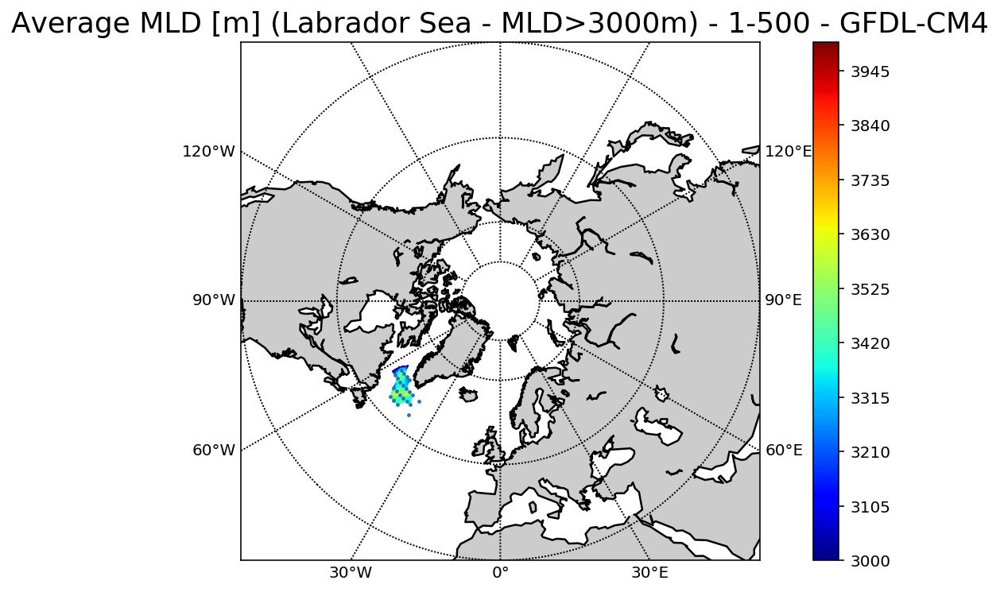

In [14]:
fig=plt.figure()
# if hemis_no==0:
#     m = Basemap( projection='spstere',lon_0=0,boundinglat=-30)
# else:
#     m = Basemap( projection='npstere',lon_0=0,boundinglat=30)
m = Basemap( projection='npstere',lon_0=0,boundinglat=30)
m.drawcoastlines(linewidth=1.25)
m.fillcontinents(color='0.8')
#m.drawmapboundary(fill_color='#000099')
m.drawparallels(np.arange(-90,90,20), labels=[1,1,0,1])
m.drawmeridians(np.arange(0,360,30), labels=[1,1,0,1])
#lon[lon > 180] -= 360
im=m.contourf(lon_mld_LAB,lat_mld_LAB,MLD_average_LAB,200,latlon=True, cmap=plt.cm.jet)
plt.colorbar(im)
m.scatter(lon_mld_LAB[LAB_indeces_lonlat],lat_mld_LAB[LAB_indeces_lonlat],2,latlon=True)
plt.title('Average MLD [m] (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
#fig.savefig(dir_figs+str(GCM)+'_average_MLD_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

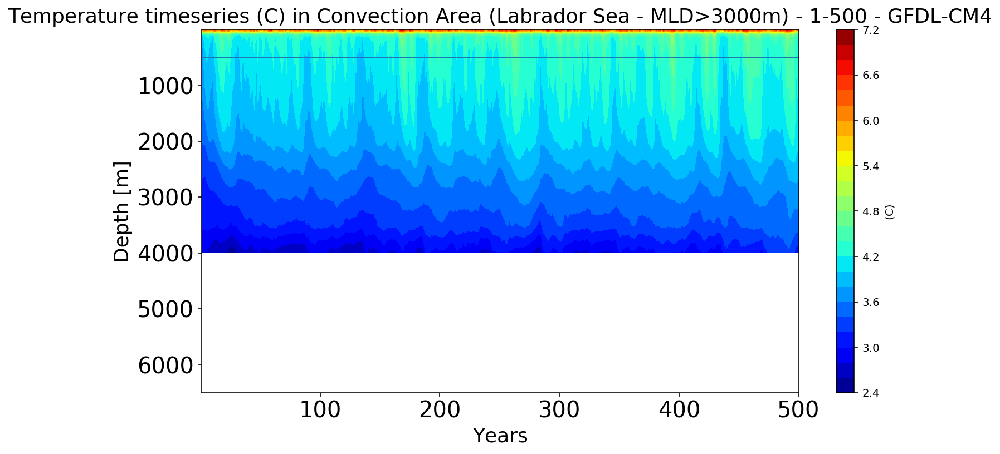

In [24]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths, np.transpose(LAB_index_time_depth), 30, cmap=plt.cm.jet) # contour(X,Y,Z,N) - N shows the number of contour levels
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Temperature timeseries (C) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(C)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_index_time_depth_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

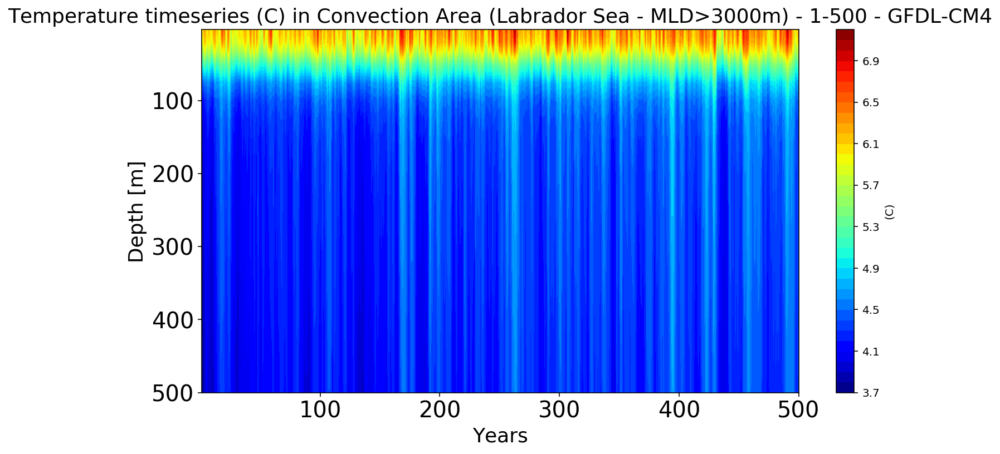

In [25]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_index_time_depth[:,0:14]), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Temperature timeseries (C) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(C)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_index_time_depth_surface_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

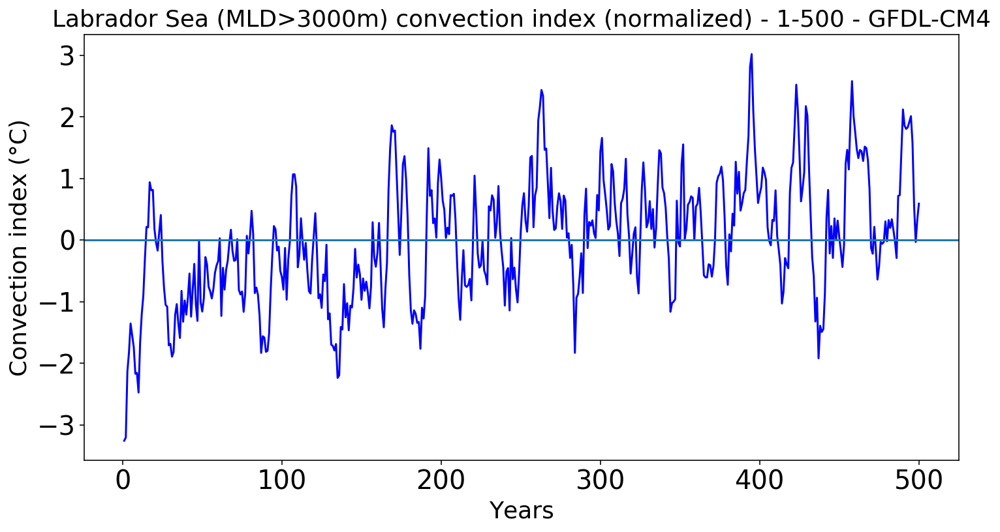

In [26]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_index_norm,'b')
l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Convection index (°C)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Labrador Sea (MLD>3000m) convection index (normalized) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [15]:
#####################################################################
Density_allyears=np.load('Density_allyears_GFDL-CM4_500yr.npy')

In [16]:
[ii,jj]=LAB_indeces_lonlat
LAB_Density_time_depth=[] 

for t in tqdm(range(Density_allyears.shape[0])):
    data_i=Density_allyears[t,:,ii,jj]
    LAB_Density_time_depth.append(np.nanmean(data_i,axis=0))
    
LAB_Density_time_depth = np.asarray(LAB_Density_time_depth)

In [17]:
Density_allyears_winter_NH=np.load('Density_allyears_winter_NH_GFDL-CM4_500yr.npy')

In [18]:
[ii,jj]=LAB_indeces_lonlat
LAB_Density_time_depth_winter=[] 

for t in tqdm(range(Density_allyears_winter_NH.shape[0])):
    data_i=Density_allyears_winter_NH[t,:,ii,jj]
    LAB_Density_time_depth_winter.append(np.nanmean(data_i,axis=0))
    
LAB_Density_time_depth_winter = np.asarray(LAB_Density_time_depth_winter)

LAB_index_density=LAB_Density_time_depth_winter[:,4]
LAB_index_density_norm=(LAB_index_density-np.nanmean(LAB_index_density))/np.std(LAB_index_density) # Normalized Convection Index

LAB_index_density_norm_rm = runningMeanFast(LAB_index_density_norm, 10)#if data is not smoothed
LAB_index_density_norm_rm=LAB_index_density_norm_rm[:-9]

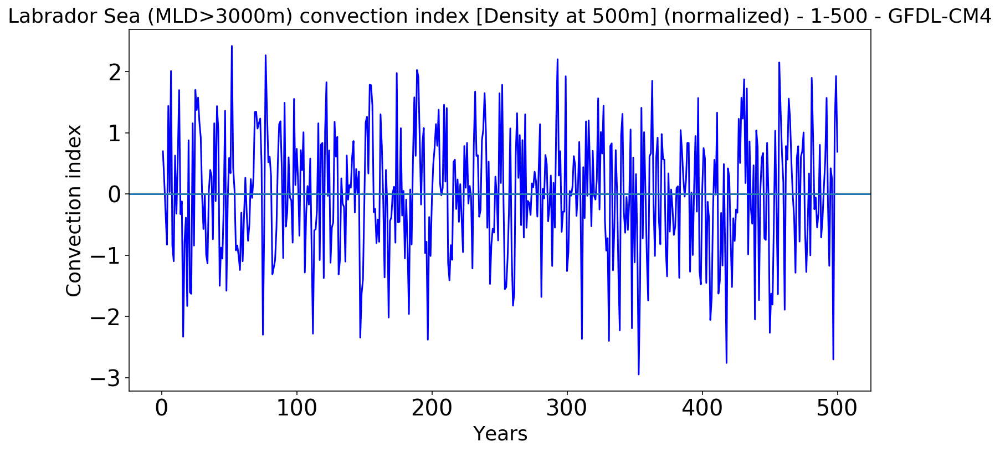

In [20]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_index_density_norm,'b')
l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Convection index', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Labrador Sea (MLD>3000m) convection index [Density at 500m] (normalized) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_density_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

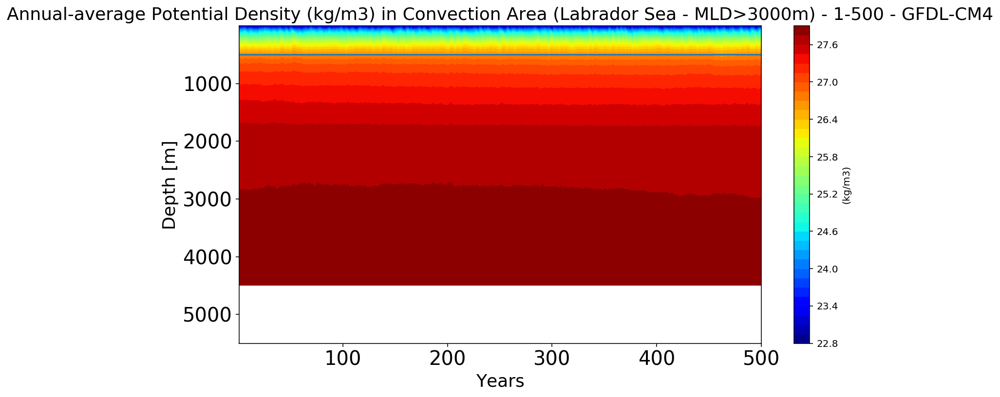

In [23]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth[:,0:33]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density (kg/m3) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_time_depth_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

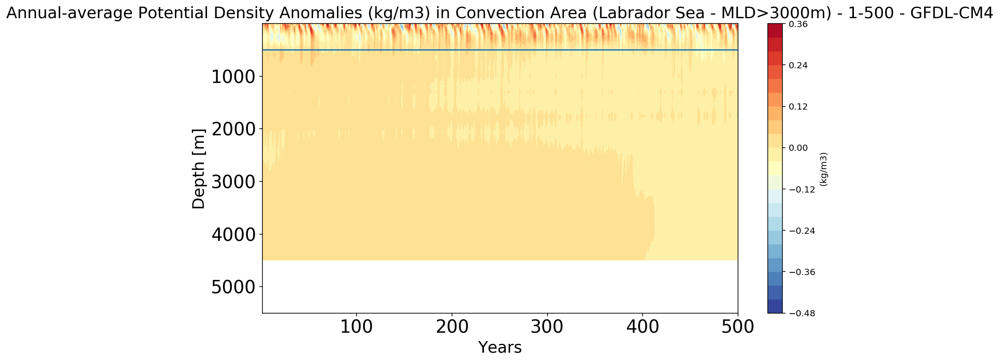

In [24]:
aa = np.nanmean(LAB_Density_time_depth,axis=0)
bb = copy.deepcopy(LAB_Density_time_depth)
for ii in range(LAB_Density_time_depth.shape[0]):
    bb[ii,:]=aa

fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:33], np.transpose(LAB_Density_time_depth[:,0:33]-bb[:,0:33]), 20, cmap=plt.cm.RdYlBu_r)
plt.gca().invert_yaxis()
l = plt.axhline(y=conv_index_depth_lab)
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density Anomalies (kg/m3) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_anomaly_time_depth_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

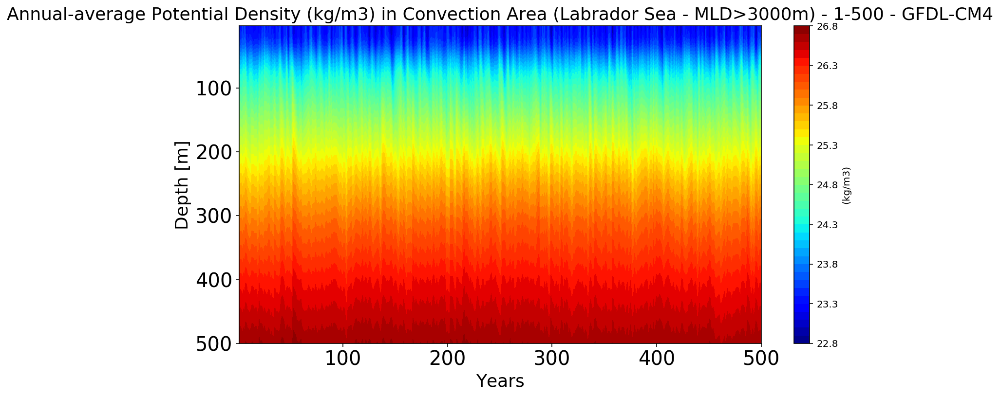

In [25]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_Density_time_depth[:,0:14]-1000), 40, cmap=plt.cm.jet)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density (kg/m3) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_time_depth_surface_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

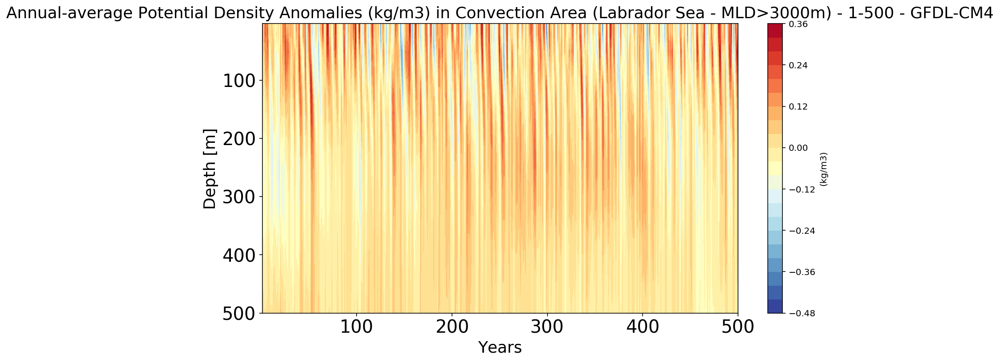

distributed.scheduler - INFO - Remove worker tcp://10.32.4.5:37131
distributed.core - INFO - Removing comms to tcp://10.32.4.5:37131
distributed.scheduler - INFO - Lost all workers
distributed.scheduler - INFO - Register tcp://10.32.4.2:40583
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.4.2:40583
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Remove worker tcp://10.32.4.2:40583
distributed.core - INFO - Removing comms to tcp://10.32.4.2:40583
distributed.scheduler - INFO - Lost all workers


In [26]:
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
im = plt.contourf(years, Depths[0:14], np.transpose(LAB_Density_time_depth[:,0:14]-bb[:,0:14]), 20, cmap=plt.cm.RdYlBu_r)
plt.gca().invert_yaxis()
plt.xlabel('Years', fontsize=18)
plt.ylabel('Depth [m]', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('Annual-average Potential Density Anomalies (kg/m3) in Convection Area (Labrador Sea - MLD>3000m) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
cbar = plt.colorbar(im, extend='max')
#cbar = m.colorbar(im,"right", size="3%", pad="2%", extend='max') # extend='both' will extend the colorbar in both sides (upper side and down side)
cbar.set_label('(kg/m3)')
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full
#fig.savefig(dir_figs+str(GCM)+'_density_annual_anomaly_time_depth_surface_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [36]:
LAB_Density_0_1000 = np.nanmean(LAB_Density_time_depth[:,0:7], axis=1)
LAB_Density_1500_2000 = np.nanmean(LAB_Density_time_depth[:,8:10], axis=1)

In [28]:
Depths

array([2.5000e+00, 1.0000e+01, 2.0000e+01, 3.2500e+01, 5.1250e+01,
       7.5000e+01, 1.0000e+02, 1.2500e+02, 1.5625e+02, 2.0000e+02,
       2.5000e+02, 3.1250e+02, 4.0000e+02, 5.0000e+02, 6.0000e+02,
       7.0000e+02, 8.0000e+02, 9.0000e+02, 1.0000e+03, 1.1000e+03,
       1.2000e+03, 1.3000e+03, 1.4000e+03, 1.5375e+03, 1.7500e+03,
       2.0625e+03, 2.5000e+03, 3.0000e+03, 3.5000e+03, 4.0000e+03,
       4.5000e+03, 5.0000e+03, 5.5000e+03, 6.0000e+03, 6.5000e+03])

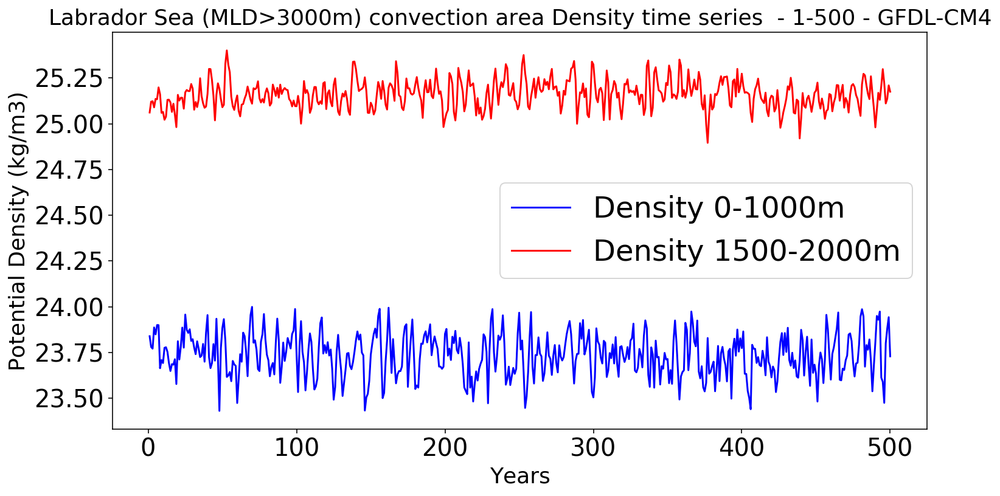

In [42]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_Density_0_1000-1000,'b',label = 'Density 0-1000m')
plt.plot(years,LAB_Density_1500_2000-1000,'r',label = 'Density 1500-2000m')
#l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Potential Density (kg/m3)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Labrador Sea (MLD>3000m) convection area Density time series  - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

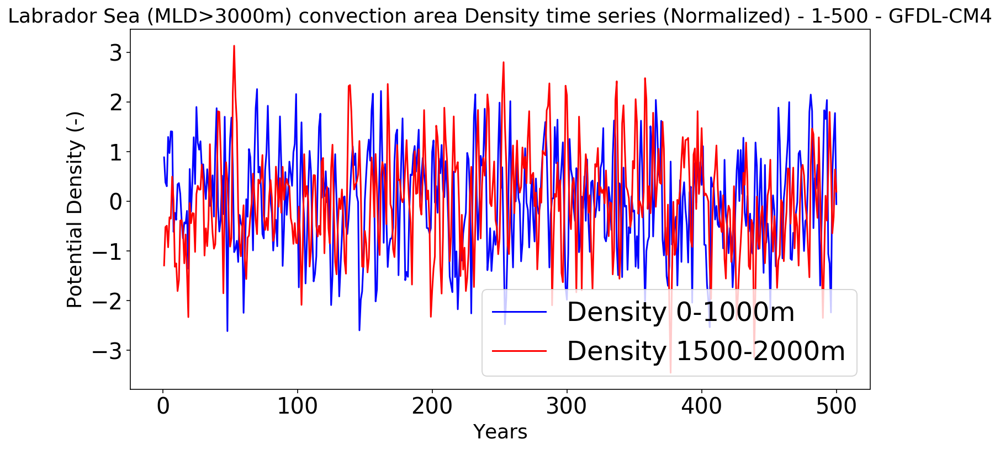

In [45]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,(LAB_Density_0_1000-np.nanmean(LAB_Density_0_1000))/np.std(LAB_Density_0_1000),'b',label = 'Density 0-1000m')
plt.plot(years,(LAB_Density_1500_2000-np.nanmean(LAB_Density_1500_2000))/np.std(LAB_Density_1500_2000),'r',label = 'Density 1500-2000m')
#l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Potential Density (-)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Labrador Sea (MLD>3000m) convection area Density time series (Normalized) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [18]:
Salinity_allyears = []
yrs_no = np.int(len(ds_so.time)/12)
Lon_orig=ds_so.lon.values
Lat_orig=ds_so.lat.values

for t in tqdm(range(yrs_no)):
    data_so_extracted = ds_so.so.isel(time= slice(12*t,12*t+12) ).values
    data_so_extracted = np.nanmean(data_so_extracted, axis=0)
    data_i = func_regrid(data_so_extracted, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Salinity_allyears.append(data_i)

Salinity_allyears = np.asarray(Salinity_allyears)

np.save('Salinity_allyears_GFDL-CM4_500yr.npy', Salinity_allyears)

#########################################################################################

Temp_allyears = []
yrs_no = np.int(len(ds_thetao.time)/12)
Lon_orig=ds_thetao.lon.values
Lat_orig=ds_thetao.lat.values

for t in tqdm(range(yrs_no)):
    data_thetao_extracted = ds_thetao.thetao.isel(time= slice(12*t,12*t+12) ).values
    data_thetao_extracted = np.nanmean(data_thetao_extracted, axis=0)
    data_i = func_regrid(data_thetao_extracted, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Temp_allyears.append(data_i)

Temp_allyears = np.asarray(Temp_allyears)

np.save('Temp_allyears_GFDL-CM4_500yr.npy', Temp_allyears)


distributed.scheduler - INFO - Retire worker names (0,)
distributed.deploy.adaptive - INFO - Retiring workers [0]
distributed.scheduler - INFO - Remove worker tcp://10.32.15.37:34857
distributed.core - INFO - Removing comms to tcp://10.32.15.37:34857
distributed.scheduler - INFO - Lost all workers
distributed.scheduler - INFO - Register tcp://10.32.15.38:41757
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.15.38:41757
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Retire worker names (1,)
distributed.deploy.adaptive - INFO - Retiring workers [1]
distributed.scheduler - INFO - Remove worker tcp://10.32.15.38:41757
distributed.core - INFO - Removing comms to tcp://10.32.15.38:41757
distributed.scheduler - INFO - Lost all workers
distributed.scheduler - INFO - Register tcp://10.32.15.39:37173
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.15.39:37173
distributed.core - INFO - Starting establi

distributed.core - INFO - Event loop was unresponsive in Scheduler for 21.36s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.


In [14]:
#####################################################################
Temp_allyears=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

In [15]:
#####################################################################
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

In [22]:
[ii,jj]=LAB_indeces_lonlat
LAB_Temp_time_depth=[] 

for t in tqdm(range(Temp_allyears.shape[0])):
    data_i=Temp_allyears[t,:,ii,jj]
    LAB_Temp_time_depth.append(np.nanmean(data_i,axis=0))
    
LAB_Temp_time_depth = np.asarray(LAB_Temp_time_depth)

In [28]:
[ii,jj]=LAB_indeces_lonlat
LAB_Salinity_time_depth=[] 

for t in tqdm(range(Salinity_allyears.shape[0])):
    data_i=Salinity_allyears[t,:,ii,jj]
    LAB_Salinity_time_depth.append(np.nanmean(data_i,axis=0))
    
LAB_Salinity_time_depth = np.asarray(LAB_Salinity_time_depth)

In [29]:
LAB_Temp_0_1000 = np.nanmean(LAB_Temp_time_depth[:,0:7], axis=1)
LAB_Temp_1500_2000 = np.nanmean(LAB_Temp_time_depth[:,8:10], axis=1)

In [30]:
LAB_Salinity_0_1000 = np.nanmean(LAB_Salinity_time_depth[:,0:7], axis=1)
LAB_Salinity_1500_2000 = np.nanmean(LAB_Salinity_time_depth[:,8:10], axis=1)

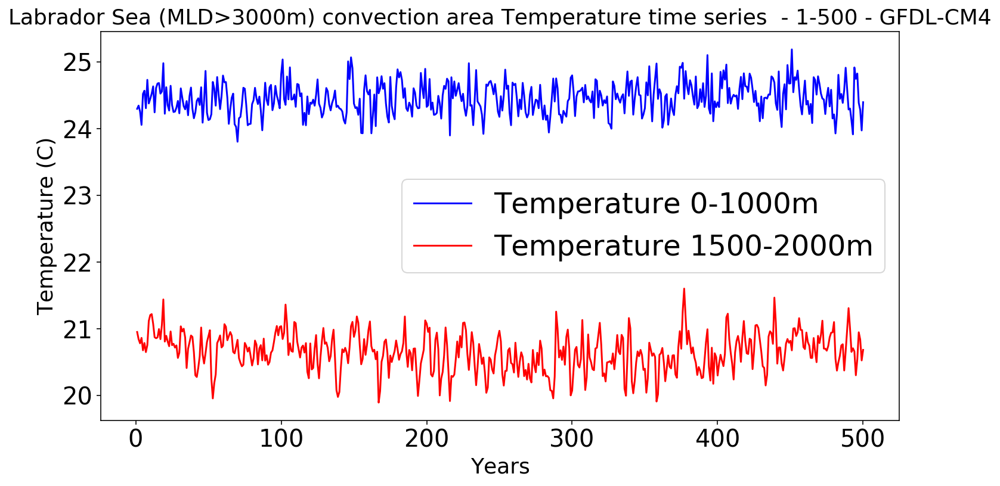

In [25]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_Temp_0_1000,'b',label = 'Temperature 0-1000m')
plt.plot(years,LAB_Temp_1500_2000,'r',label = 'Temperature 1500-2000m')
#l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Temperature (C)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Labrador Sea (MLD>3000m) convection area Temperature time series  - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

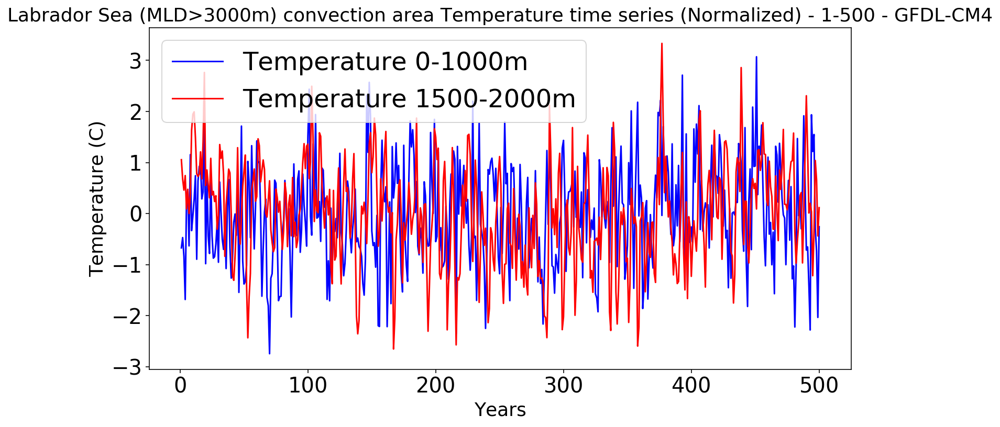

In [26]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,(LAB_Temp_0_1000-np.nanmean(LAB_Temp_0_1000))/np.std(LAB_Temp_0_1000),'b',label = 'Temperature 0-1000m')
plt.plot(years,(LAB_Temp_1500_2000-np.nanmean(LAB_Temp_1500_2000))/np.std(LAB_Temp_1500_2000),'r',label = 'Temperature 1500-2000m')
#l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Temperature (C)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Labrador Sea (MLD>3000m) convection area Temperature time series (Normalized) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

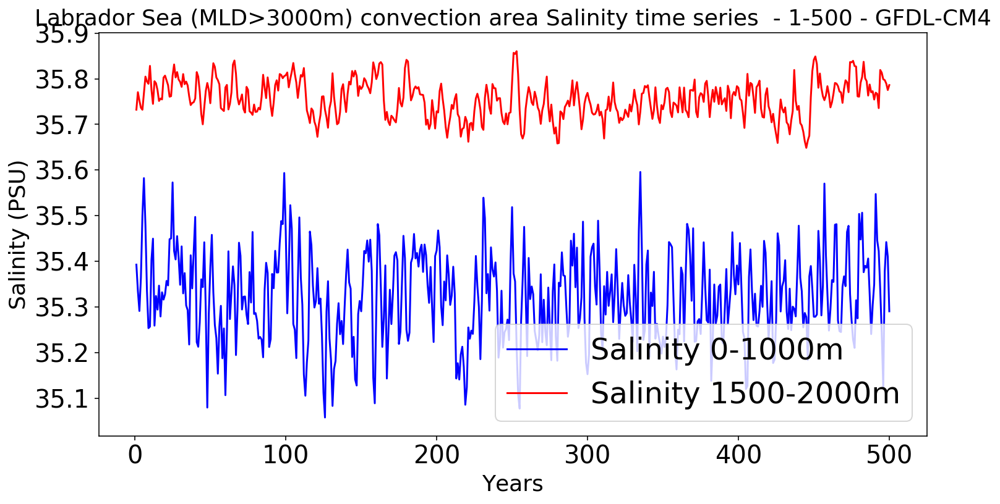

In [31]:
###########################################
### Convection Index Time Series Plots ####
fig=plt.figure()
years=np.linspace(year_start,year_end,year_end-year_start+1)
#print (years,area)
plt.plot(years,LAB_Salinity_0_1000,'b',label = 'Salinity 0-1000m')
plt.plot(years,LAB_Salinity_1500_2000,'r',label = 'Salinity 1500-2000m')
#l = plt.axhline(y=0)
#plt.plot(years[st2],deep_conv_area_WS[st2],'r')
plt.xlabel('Years', fontsize=18)
plt.ylabel('Salinity (PSU)', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(prop={'size': 24}, loc='best', fancybox=True, framealpha=0.8)
plt.title('Labrador Sea (MLD>3000m) convection area Salinity time series  - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#mng.window.showMaximized() # Maximizes the plot window to save figures in full    
#fig.savefig(dir_figs+str(GCM)+'_convec_index_LAB_MLD3000.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
###############################################################################
###############################################################################

In [15]:
GCM = GCM_name

import os
import shelve
dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)

filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_trans.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['AMOC_max']=my_shelf['AMOC_max']
my_shelf.close()

filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['Depths']=my_shelf['Depths']
my_shelf.close()


In [60]:
AMOC_max_50N= AMOC_max[:,140] # AMOC at 50N # Max of streamfunction method
AMOC_max_50N_m=runningMeanFast(AMOC_max_50N, 10)

AMOC_max_20N= AMOC_max[:,110] # AMOC at 20N # Max of streamfunction method
AMOC_max_20N_m=runningMeanFast(AMOC_max_20N, 10)

In [55]:
#####################################################################
Salinity_allyears=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_allyears_atl_surf = Salinity_allyears[:,0,:,:]
for ii in range(Salinity_allyears_atl_surf.shape[0]):
    Salinity_allyears_atl_surf[ii,:,:] [ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
Salinity_allyears_atl_surf = np.nanmean(Salinity_allyears_atl_surf, axis=2)

Salinity_allyears_atl_2500m = Salinity_allyears[:,26,:,:]
for ii in range(Salinity_allyears_atl_2500m.shape[0]):
    Salinity_allyears_atl_2500m[ii,:,:] [ Ocean_Index!=6 ] = np.nan # Keep Atlantic only
Salinity_allyears_atl_2500m = np.nanmean(Salinity_allyears_atl_2500m, axis=2)

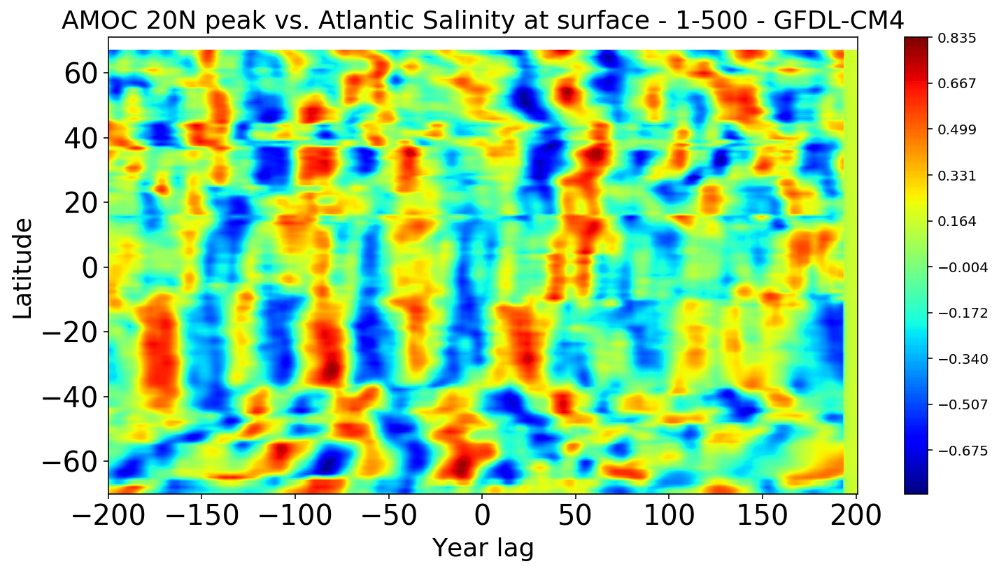

In [58]:
lag_time=200

fig=plt.figure()
data=[]
for i in range(len(Salinity_allyears_atl_surf[0][20:161])):
    stream=runningMeanFast(Salinity_allyears_atl_surf[:,i+35], 10)
    r=lag_cor_data(AMOC_max_20N_m,stream,lag_time)
    data.append(r)
data=np.asarray(data)
x=np.linspace(-lag_time,lag_time+1, 2*lag_time)
y=np.linspace(-70,70+1, 2*70+1)

x,y=np.meshgrid(x,y)
cmap_limit=np.nanmax(np.abs(data))
levels=np.linspace(-cmap_limit,cmap_limit,200)
im=plt.contourf(x,y,data,levels,latlon=True, cmap=plt.cm.jet)
cb = plt.colorbar(im)
plt.xlabel('Year lag', fontsize=18)
plt.ylabel('Latitude', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('AMOC 20N peak vs. Atlantic Salinity at surface - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_convec_Atl_Salinity_surf_AMOC20N_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

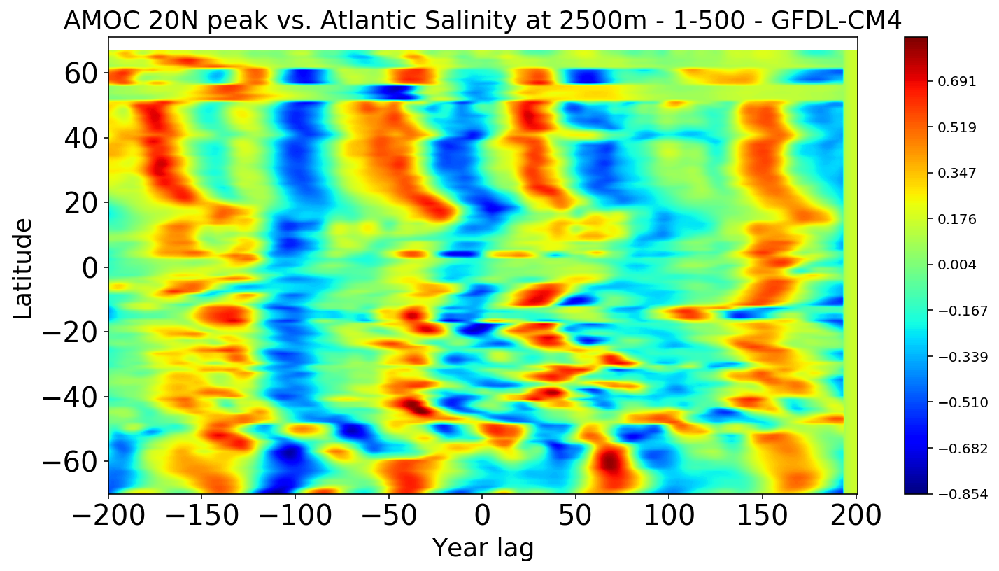

In [59]:
lag_time=200

fig=plt.figure()
data=[]
for i in range(len(Salinity_allyears_atl_2500m[0][20:161])):
    stream=runningMeanFast(Salinity_allyears_atl_2500m[:,i+35], 10)
    r=lag_cor_data(AMOC_max_20N_m,stream,lag_time)
    data.append(r)
data=np.asarray(data)
x=np.linspace(-lag_time,lag_time+1, 2*lag_time)
y=np.linspace(-70,70+1, 2*70+1)

x,y=np.meshgrid(x,y)
cmap_limit=np.nanmax(np.abs(data))
levels=np.linspace(-cmap_limit,cmap_limit,200)
im=plt.contourf(x,y,data,levels,latlon=True, cmap=plt.cm.jet)
cb = plt.colorbar(im)
plt.xlabel('Year lag', fontsize=18)
plt.ylabel('Latitude', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('AMOC 20N peak vs. Atlantic Salinity at 2500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_convec_Atl_Salinity_2500m_AMOC20N_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

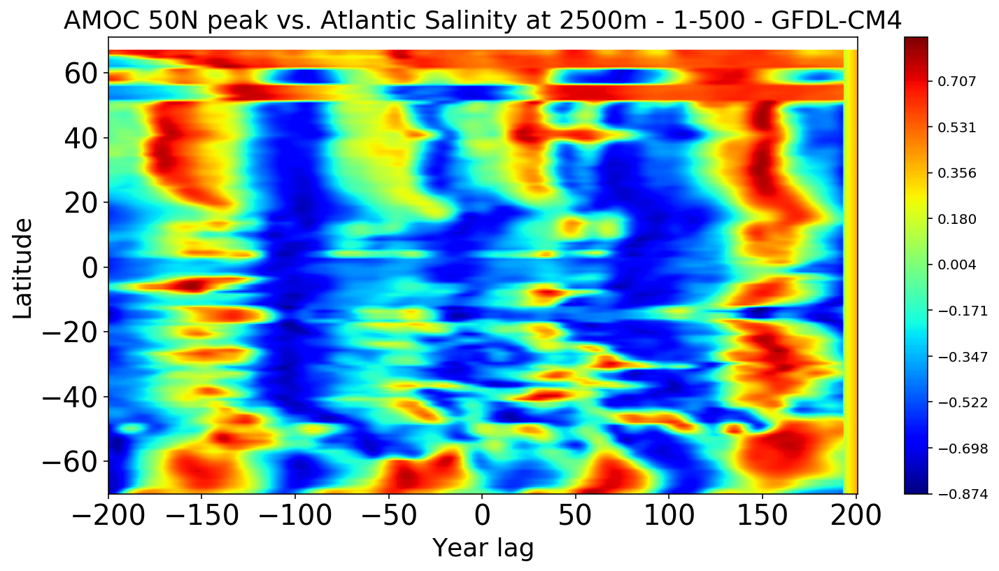

In [62]:
lag_time=200

fig=plt.figure()
data=[]
for i in range(len(Salinity_allyears_atl_2500m[0][20:161])):
    stream=runningMeanFast(Salinity_allyears_atl_2500m[:,i+35], 10)
    r=lag_cor_data(AMOC_max_50N_m,stream,lag_time)
    data.append(r)
data=np.asarray(data)
x=np.linspace(-lag_time,lag_time+1, 2*lag_time)
y=np.linspace(-70,70+1, 2*70+1)

x,y=np.meshgrid(x,y)
cmap_limit=np.nanmax(np.abs(data))
levels=np.linspace(-cmap_limit,cmap_limit,200)
im=plt.contourf(x,y,data,levels,latlon=True, cmap=plt.cm.jet)
cb = plt.colorbar(im)
plt.xlabel('Year lag', fontsize=18)
plt.ylabel('Latitude', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.title('AMOC 50N peak vs. Atlantic Salinity at 2500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_convec_Atl_Salinity_2500m_AMOC50N_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [13]:
GCM = GCM_name
import os; import shelve
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['LAB_index']=my_shelf['LAB_index']; my_shelf.close()

LAB_index_rm = copy.deepcopy(LAB_index)
LAB_index_rm=runningMeanFast(LAB_index_rm, 10)

distributed.scheduler - INFO - Register tcp://10.32.17.2:35325
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.17.2:35325
distributed.core - INFO - Starting established connection


In [18]:
#####################################################################
Salinity_allyears_surf_LAB_B1=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_allyears_surf_LAB_B1=Salinity_allyears_surf_LAB_B1[:,0,140:156,295:320]
Salinity_allyears_surf_LAB_B1=np.nanmean(Salinity_allyears_surf_LAB_B1,axis=2)
Salinity_allyears_surf_LAB_B1=np.nanmean(Salinity_allyears_surf_LAB_B1,axis=1)
Salinity_allyears_surf_LAB_B1_m=runningMeanFast(Salinity_allyears_surf_LAB_B1, 10)

In [19]:
#####################################################################
Density_allyears_surf_LAB_B1=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_allyears_surf_LAB_B1=Density_allyears_surf_LAB_B1[:,0,140:156,295:320]
Density_allyears_surf_LAB_B1=np.nanmean(Density_allyears_surf_LAB_B1,axis=2)
Density_allyears_surf_LAB_B1=np.nanmean(Density_allyears_surf_LAB_B1,axis=1)
Density_allyears_surf_LAB_B1_m=runningMeanFast(Density_allyears_surf_LAB_B1, 10)

In [20]:
#####################################################################
Temp_allyears_surf_LAB_B1=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_allyears_surf_LAB_B1=Temp_allyears_surf_LAB_B1[:,0,140:156,295:320]
Temp_allyears_surf_LAB_B1=np.nanmean(Temp_allyears_surf_LAB_B1,axis=2)
Temp_allyears_surf_LAB_B1=np.nanmean(Temp_allyears_surf_LAB_B1,axis=1)
Temp_allyears_surf_LAB_B1_m=runningMeanFast(Temp_allyears_surf_LAB_B1, 10)

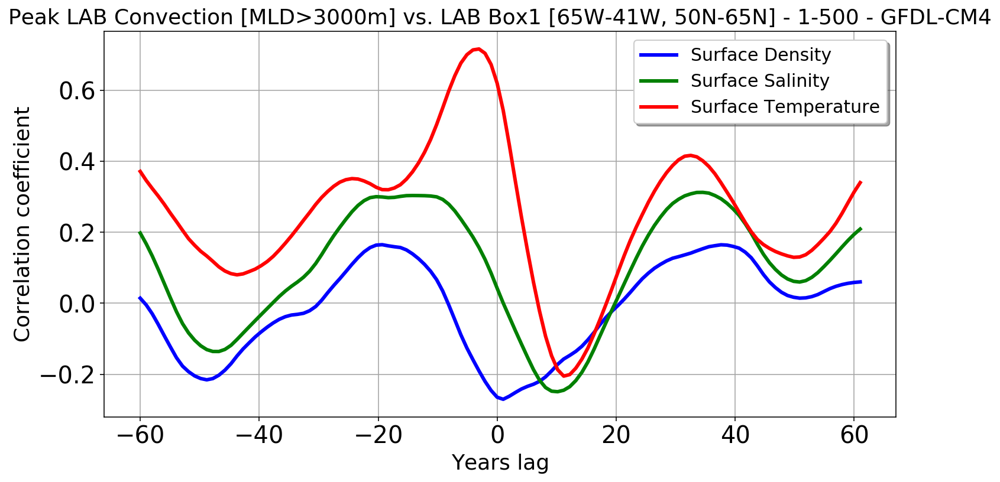

In [32]:
lag_time=60

fig=plt.figure()

lag_cor(LAB_index_rm[:-9],Density_allyears_surf_LAB_B1_m[:-9],lag_time,'b','Surface Density')
lag_cor(LAB_index_rm[:-9],Salinity_allyears_surf_LAB_B1_m[:-9],lag_time,'g','Surface Salinity')
lag_cor(LAB_index_rm[:-9],Temp_allyears_surf_LAB_B1_m[:-9],lag_time,'r','Surface Temperature')
plt.legend()
plt.title('Peak LAB Convection [MLD>3000m] vs. LAB Box1 [65W-41W, 50N-65N] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_LABconvection_DST_surf_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [22]:
#####################################################################
Salinity_allyears_500m_LAB_B1=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_allyears_500m_LAB_B1=Salinity_allyears_500m_LAB_B1[:,13,140:156,295:320]
Salinity_allyears_500m_LAB_B1=np.nanmean(Salinity_allyears_500m_LAB_B1,axis=2)
Salinity_allyears_500m_LAB_B1=np.nanmean(Salinity_allyears_500m_LAB_B1,axis=1)
Salinity_allyears_500m_LAB_B1_m=runningMeanFast(Salinity_allyears_500m_LAB_B1, 10)

In [23]:
#####################################################################
Density_allyears_500m_LAB_B1=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_allyears_500m_LAB_B1=Density_allyears_500m_LAB_B1[:,13,140:156,295:320]
Density_allyears_500m_LAB_B1=np.nanmean(Density_allyears_500m_LAB_B1,axis=2)
Density_allyears_500m_LAB_B1=np.nanmean(Density_allyears_500m_LAB_B1,axis=1)
Density_allyears_500m_LAB_B1_m=runningMeanFast(Density_allyears_500m_LAB_B1, 10)

In [24]:
#####################################################################
Temp_allyears_500m_LAB_B1=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_allyears_500m_LAB_B1=Temp_allyears_500m_LAB_B1[:,13,140:156,295:320]
Temp_allyears_500m_LAB_B1=np.nanmean(Temp_allyears_500m_LAB_B1,axis=2)
Temp_allyears_500m_LAB_B1=np.nanmean(Temp_allyears_500m_LAB_B1,axis=1)
Temp_allyears_500m_LAB_B1_m=runningMeanFast(Temp_allyears_500m_LAB_B1, 10)

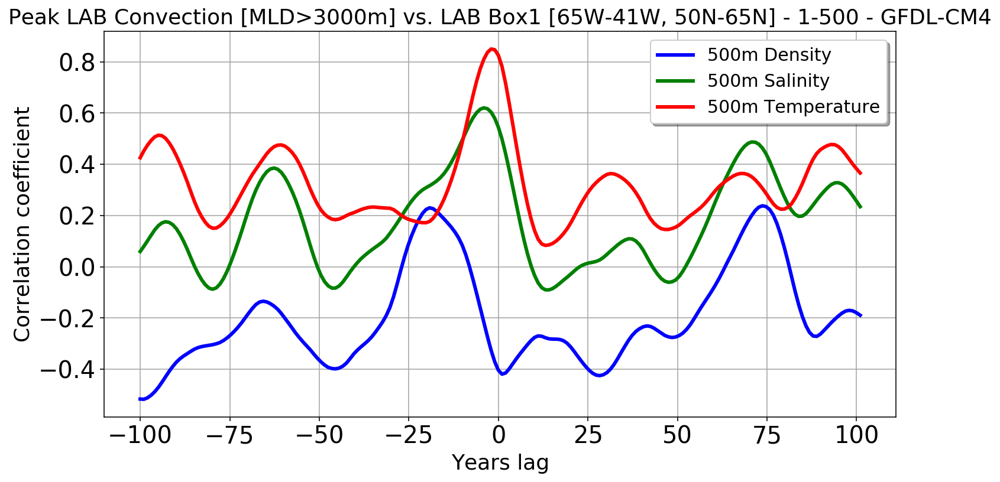

In [25]:
lag_time=100

fig=plt.figure()

lag_cor(LAB_index_rm[:-9],Density_allyears_500m_LAB_B1_m[:-9],lag_time,'b','500m Density')
lag_cor(LAB_index_rm[:-9],Salinity_allyears_500m_LAB_B1_m[:-9],lag_time,'g','500m Salinity')
lag_cor(LAB_index_rm[:-9],Temp_allyears_500m_LAB_B1_m[:-9],lag_time,'r','500m Temperature')
plt.legend()
plt.title('Peak LAB Convection [MLD>3000m] vs. LAB Box1 [65W-41W, 50N-65N] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_LABconvection_DST_500m_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [28]:
#####################################################################
Salinity_allyears_2500m_LAB_B1=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_allyears_2500m_LAB_B1=Salinity_allyears_2500m_LAB_B1[:,26,140:156,295:320]
Salinity_allyears_2500m_LAB_B1=np.nanmean(Salinity_allyears_2500m_LAB_B1,axis=2)
Salinity_allyears_2500m_LAB_B1=np.nanmean(Salinity_allyears_2500m_LAB_B1,axis=1)
Salinity_allyears_2500m_LAB_B1_m=runningMeanFast(Salinity_allyears_2500m_LAB_B1, 10)

In [29]:
#####################################################################
Density_allyears_2500m_LAB_B1=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_allyears_2500m_LAB_B1=Density_allyears_2500m_LAB_B1[:,26,140:156,295:320]
Density_allyears_2500m_LAB_B1=np.nanmean(Density_allyears_2500m_LAB_B1,axis=2)
Density_allyears_2500m_LAB_B1=np.nanmean(Density_allyears_2500m_LAB_B1,axis=1)
Density_allyears_2500m_LAB_B1_m=runningMeanFast(Density_allyears_2500m_LAB_B1, 10)

In [30]:
#####################################################################
Temp_allyears_2500m_LAB_B1=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_allyears_2500m_LAB_B1=Temp_allyears_2500m_LAB_B1[:,26,140:156,295:320]
Temp_allyears_2500m_LAB_B1=np.nanmean(Temp_allyears_2500m_LAB_B1,axis=2)
Temp_allyears_2500m_LAB_B1=np.nanmean(Temp_allyears_2500m_LAB_B1,axis=1)
Temp_allyears_2500m_LAB_B1_m=runningMeanFast(Temp_allyears_2500m_LAB_B1, 10)

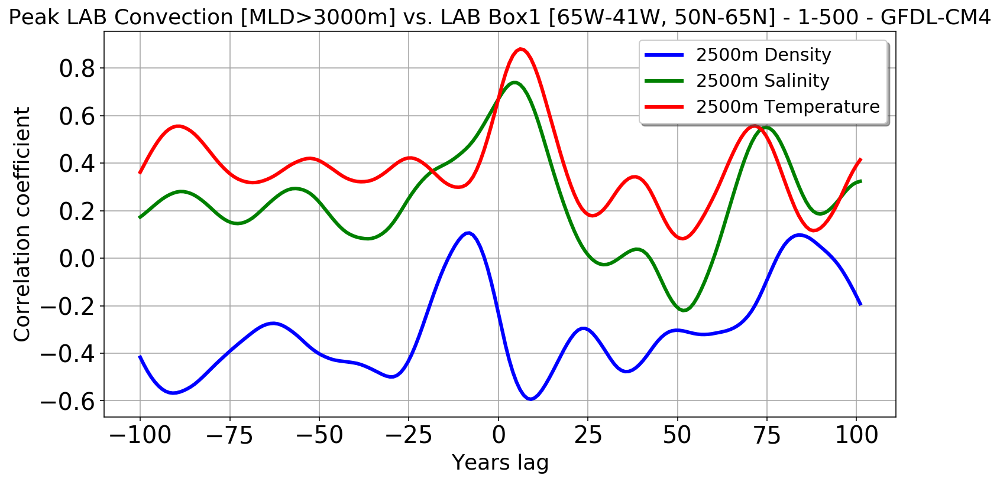

In [34]:
lag_time=100

fig=plt.figure()

lag_cor(LAB_index_rm[:-9],Density_allyears_2500m_LAB_B1_m[:-9],lag_time,'b','2500m Density')
lag_cor(LAB_index_rm[:-9],Salinity_allyears_2500m_LAB_B1_m[:-9],lag_time,'g','2500m Salinity')
lag_cor(LAB_index_rm[:-9],Temp_allyears_2500m_LAB_B1_m[:-9],lag_time,'r','2500m Temperature')
plt.legend()
plt.title('Peak LAB Convection [MLD>3000m] vs. LAB Box1 [65W-41W, 50N-65N] - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_LABconvection_DST_2500m_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [ ]:
#########################################################################################

In [18]:
month_no=9 # month of the year
hemis_no=0 # 0 = Weddell Sea, 1 = Labrador Sea, 2 = Norwegian Sea, 4 = Ross Sea

Density_allyears_winter_SH = []
yrs_no = np.int(len(ds_thetao.time)/12)
Lon_orig=ds_thetao.lon.values
Lat_orig=ds_thetao.lat.values

import seawater as sw
for t in tqdm(range(yrs_no)):
    data_thetao_extracted = ds_thetao.thetao.isel(time= 12*t+month_no-1 ).values
    data_so_extracted = ds_so.so.isel(time= 12*t+month_no-1 ).values
    data_dens=sw.dens0(data_so_extracted, data_thetao_extracted)
    #data_dens = np.nanmean(data_dens, axis=0)
    data_i = func_regrid(data_dens, Lat_orig, Lon_orig, Lat_regrid_2D, Lon_regrid_2D)
    data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
    
    Density_allyears_winter_SH.append(data_i)

Density_allyears_winter_SH = np.asarray(Density_allyears_winter_SH)

np.save('Density_allyears_winter_SH_GFDL-CM4_500yr.npy', Density_allyears_winter_SH)

distributed.core - INFO - Event loop was unresponsive in Scheduler for 24.83s.  This is often caused by long-running GIL-holding functions or moving large chunks of data. This can cause timeouts and instability.


In [20]:
#####################################################################
Density_ave_winter_surf_SO=np.load('Density_allyears_winter_SH_GFDL-CM4_500yr.npy')

Density_ave_winter_surf_SO=Density_ave_winter_surf_SO[:,0,0:41,:] # 90S-50S
Density_ave_winter_surf_SO=np.nanmean(Density_ave_winter_surf_SO,axis=0)

#####################################################################
Density_ave_winter_1500m_SO=np.load('Density_allyears_winter_SH_GFDL-CM4_500yr.npy')

Density_ave_winter_1500m_SO=Density_ave_winter_1500m_SO[:,22:24,0:41,:] # 90S-50S
Density_ave_winter_1500m_SO=np.nanmean(Density_ave_winter_1500m_SO,axis=0)

Density_ave_winter_1500m_SO = ( (Density_ave_winter_1500m_SO[1,:,:]*(1500-1400) + Density_ave_winter_1500m_SO[0,:,:]*(1537.5-1500) ) / (1537.5-1400) )
# Interpolating between Depth[23]=1537.5 and Depth[22]=1400 to calculate density at depth 1500m


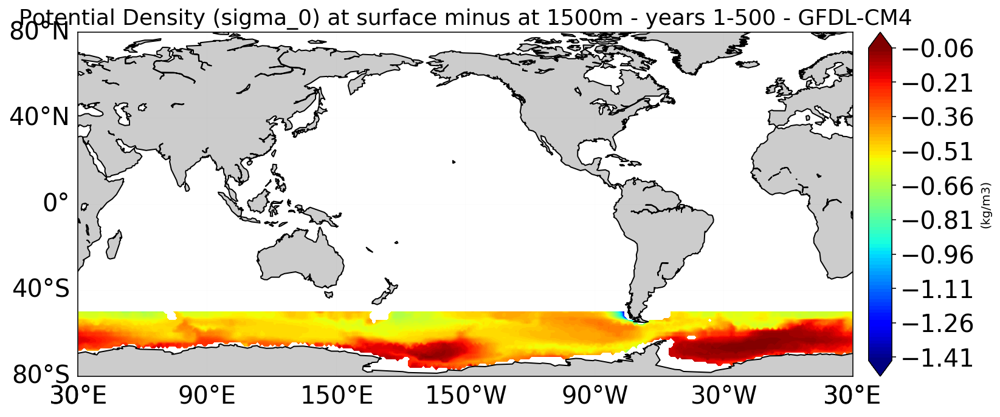

In [24]:
Plot_Var = Density_ave_winter_surf_SO - Density_ave_winter_1500m_SO
#Plot_Var[ Ocean_Land_mask==0 ]=np.nan # masking over land, so grid cells that fall on land area (value=0) will be deleted
cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99.999999)))
Plot_range=101
Plot_unit='(kg/m3)'; Plot_title= 'Potential Density (sigma_0) at surface minus at 1500m - years '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var, Lon_regrid_2D[0:41,:], Lat_regrid_2D[0:41,:], Plot_range, Plot_title, Plot_unit, plt.cm.jet, 'cyl', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+str(GCM)+'_SO_winter_Density_surf_minus_1500m_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

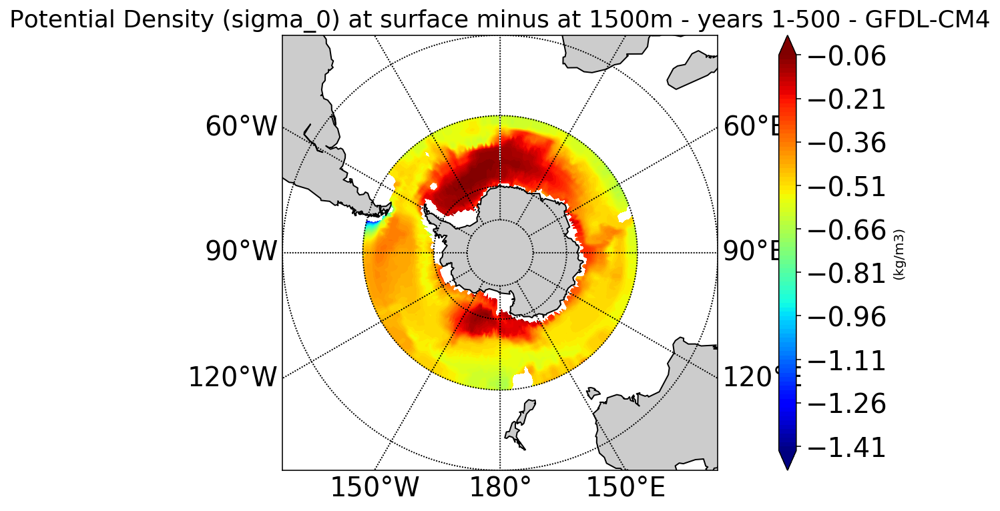

In [25]:
Plot_Var = Density_ave_winter_surf_SO - Density_ave_winter_1500m_SO
#Plot_Var[ Ocean_Land_mask==0 ]=np.nan # masking over land, so grid cells that fall on land area (value=0) will be deleted
cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99.999999)))
Plot_range=101
Plot_unit='(kg/m3)'; Plot_title= 'Potential Density (sigma_0) at surface minus at 1500m - years '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var, Lon_regrid_2D[0:41,:], Lat_regrid_2D[0:41,:], Plot_range, Plot_title, Plot_unit, plt.cm.jet, 'spstere', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+str(GCM)+'_SO_winter_Density_surf_minus_1500m_2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [89]:
Density_ave_1500m_SO2 = ( (Density_ave_1500m_SO[1,:,:]*(1500-1400) + Density_ave_1500m_SO[0,:,:]*(1537.5-1500) ) / (1537.5-1400) )

In [68]:
Salinity_ave_1500m_SO.shape

(41, 360)

In [ ]:
###################################
Density_allyears=np.load('Density_allyears_GFDL-ESM2G_500yr.npy')

Density_allyears_WS = copy.deepcopy(Density_allyears[:,:,20:35,320:]) # [40W-0W,70S-55S]
Density_allyears_WS_ave = np.nanmean( np.nanmean (Density_allyears_WS, axis=3), axis=2)

Delta_rho_WS = ( (Density_allyears_WS_ave[:,30]*53.04 + Density_allyears_WS_ave[:,29]*24.17 ) / (53.04+24.17) ) - Density_allyears_WS_ave[:,0]
 # Interpolating between Depth[30]=524.17 and Depth[29]=446.94 to calculate density at depth 500m
Delta_rho_WS_CoeffVar = np.std(Delta_rho_WS) / np.nanmean(Delta_rho_WS)


In [55]:
Depths[22], Depths[23]

(1400.0, 1537.5)

In [12]:
###############################################################################
###############################################################################
###############################################################################
########                 Barotropic Streamfunction                  ###########
###############################################################################
###############################################################################
###############################################################################

In [13]:
df_plt = df[(df.variable_id == 'vo') & (df.experiment_id == 'piControl')& (df.source_id=='GFDL-CM4')]
#df_plt = df_plt[ df_plt['grid_label'] == 'gr']
run_counts = df_plt.groupby(['source_id', 'experiment_id'])['zstore'].count()
run_counts

source_id  experiment_id
GFDL-CM4   piControl        1
Name: zstore, dtype: int64

In [14]:
uri_vo = df_plt[(df_plt.source_id == GCM_name)].zstore.values[0]
ds_vo = func_load_ds_uri(uri_vo)
#ds_vo

In [15]:
def func_barotropicstream_Vy_DxIntegrated(ds_vo, Lat_refrence_H, Lat_refrence_L):
        
    Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(180, 360, -90, 90, 0, 360)
    Lon_regrid_2D, Lat_regrid_2D = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)
    Ocean_Land_mask = func_oceanlandmask(Lat_regrid_2D, Lon_regrid_2D) # 1= ocean, 0= land
    Ocean_Index = func_oceanindex (Lat_regrid_2D, Lon_regrid_2D) # [0=land] [2=Pacific] [3=Indian Ocean] [6=Atlantic] [10=Arctic] [8=Baffin Bay (west of Greenland)] [9=Norwegian Sea (east of Greenland)] [11=Hudson Bay (Canada)] 
    Ocean_Index[Ocean_Index==8]=6; Ocean_Index[Ocean_Index==9]=6; # Converting the left and right seas of Greenland to Atlantic

    lon, lat = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)
        
    depths=ds_vo.lev.values
    ### these are upper and lower depths of each cell in an ocean grid
    depths_b=ds_vo.lev_bnds.values
    ### calculate the depth of each cell in an ocean grid
    depths_r=depths_b[:,1]-depths_b[:,0]
    ### find timeindeces
    yrs_no = np.int(len(ds_vo.time)/12)
    
    Lon_orig=ds_vo.lon.values
    Lat_orig=ds_vo.lat.values    

    Lon_orig = np.array(Lon_orig).copy() # To solve the issue with imuutability of the variable (ValueError: assignment destination is read-only)
    Lat_orig = np.array(Lat_orig).copy()    
    
    ################################################

    transport_depth_lon_sum_allyears=[] # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup], for all years

    ### we averaging velocities over the year for monthly data
    for t in tqdm(range(yrs_no)):
        data_vo_extracted=ds_vo.vo.isel(time= slice(12*t,12*t+12) ).values
        data=np.squeeze(data_vo_extracted)
        data=np.mean(data, axis=0)
        
        data_i = func_regrid(data, Lat_orig, Lon_orig, lat, lon)
        data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan
        
        if t==0: 
            data_depth=np.full([len(lon),len(lon[0])], np.nan)
            data_depth_ranges=np.full([len(data_i),len(data_i[0]),len(data_i[0][0])], np.nan)

        [ii,jj] = np.where(np.logical_and((lat<=Lat_refrence_H) , (lat>=Lat_refrence_L)))  
        for k in range(len(ii)):
            #### I calculate the depth by looking how many nans is in the depth column
            if sum(~np.isnan(data_i[:,ii[k],jj[k]]))>0:
                if t==0:
                    data_depth[ii[k],jj[k]]=depths[sum(~np.isnan(data_i[:,ii[k],jj[k]]))-1]
                    for l in range(sum(~np.isnan(data_i[:,ii[k],jj[k]]))):
                        data_depth_ranges[l,ii[k],jj[k]]=depths_r[l]
        

        #### multiplying by depth
        transport_depth=data_i*data_depth_ranges # V_y * dZ [Unit: m/s * m ]
        #### calculating integral over dz
        transport_depth=np.nansum(transport_depth,axis=0) # SUM(V_y * dZ) over depth [Unit: m2/s ]  
        #### multiplying by latitude (dY)
        transport_depth_lon = transport_depth *(np.cos(np.deg2rad(lat))*111321) # SUM(V_y * dZ * dX) [Unit: m/s * m * m]
        transport_depth_lon = transport_depth_lon /1000000 # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup]
        
        transport_depth_lon_atl=copy.deepcopy(transport_depth_lon) # Atlantic Ocean Only
        transport_depth_lon_atl [ Ocean_Index!=6 ] = np.nan
        
        transport_depth_lon_pac=copy.deepcopy(transport_depth_lon) # Pacific Ocean Only
        transport_depth_lon_pac [ Ocean_Index!=2 ] = np.nan       
        
        transport_depth_lon_ind=copy.deepcopy(transport_depth_lon) # Indian Ocean Only
        transport_depth_lon_ind [ Ocean_Index!=3 ] = np.nan              
        
        transport_depth_lon_atl_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
        transport_counter=np.zeros((transport_depth.shape[0]))
        #transport_depth_lat_sum[0,:]=transport_depth[0,:]
        for jj in range(40, -100,-1):
            help_transport = transport_depth_lon_atl[:,jj];  help_transport[ np.isnan(help_transport) ] =0
            transport_counter = transport_counter + help_transport
            transport_depth_lon_atl_sum[:,jj]=transport_counter

        transport_depth_lon_pac_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
        transport_counter=np.zeros((transport_depth.shape[0]))
        #transport_depth_lat_sum[0,:]=transport_depth[0,:]
        for jj in range(-70, -270,-1):
            help_transport = transport_depth_lon_pac[:,jj];  help_transport[ np.isnan(help_transport) ] =0
            transport_counter = transport_counter + help_transport
            transport_depth_lon_pac_sum[:,jj]=transport_counter

        transport_depth_lon_ind_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
        transport_counter=np.zeros((transport_depth.shape[0]))
        #transport_depth_lat_sum[0,:]=transport_depth[0,:]
        for jj in range(-250, -330,-1):
            help_transport = transport_depth_lon_ind[:,jj];  help_transport[ np.isnan(help_transport) ] =0
            transport_counter = transport_counter + help_transport
            transport_depth_lon_ind_sum[:,jj]=transport_counter
       
        transport_depth_lon_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
        for ii in range (0,transport_depth.shape[0]):
            for jj in range (0,transport_depth.shape[1]):
                if Ocean_Index[ii,jj]==6:
                    transport_depth_lon_sum[ii,jj]=transport_depth_lon_atl_sum[ii,jj]
                if Ocean_Index[ii,jj]==2:
                    transport_depth_lon_sum[ii,jj]=transport_depth_lon_pac_sum[ii,jj]
                if Ocean_Index[ii,jj]==3:
                    transport_depth_lon_sum[ii,jj]=transport_depth_lon_ind_sum[ii,jj]                   

        transport_depth_lon_sum_allyears.append(transport_depth_lon_sum) # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup], for all years
    
        #transport_final.append(transport)
    transport_depth_lon_sum_allyears=np.asarray(transport_depth_lon_sum_allyears)


    return transport_depth_lon_sum_allyears
#%%


In [16]:
# #######################################################################################
# ### Use this section to calculate for every 50years instead of straight up 500years ###
# #######################################################################################


# Lat_refrence_H = 90 # Higher bound of lat
# Lat_refrence_L = 0 # Lower bound of lat

# Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(180, 360, -90, 90, 0, 360)
# Lon_regrid_2D, Lat_regrid_2D = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)
# Ocean_Land_mask = func_oceanlandmask(Lat_regrid_2D, Lon_regrid_2D) # 1= ocean, 0= land
# Ocean_Index = func_oceanindex (Lat_regrid_2D, Lon_regrid_2D) # [0=land] [2=Pacific] [3=Indian Ocean] [6=Atlantic] [10=Arctic] [8=Baffin Bay (west of Greenland)] [9=Norwegian Sea (east of Greenland)] [11=Hudson Bay (Canada)] 
# Ocean_Index[Ocean_Index==8]=6; Ocean_Index[Ocean_Index==9]=6; # Converting the left and right seas of Greenland to Atlantic

# lon, lat = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)

# depths=ds_vo.lev.values
# ### these are upper and lower depths of each cell in an ocean grid
# depths_b=ds_vo.lev_bnds.values
# ### calculate the depth of each cell in an ocean grid
# depths_r=depths_b[:,1]-depths_b[:,0]
# ### find timeindeces
# yrs_no = np.int(len(ds_vo.time)/12)

# Lon_orig=ds_vo.lon.values
# Lat_orig=ds_vo.lat.values    

# Lon_orig = np.array(Lon_orig).copy() # To solve the issue with imuutability of the variable (ValueError: assignment destination is read-only)
# Lat_orig = np.array(Lat_orig).copy()    

# ################################################

# for xx in range(0,10):

#     transport_depth_lon_sum_allyears=[] # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup], for all years

#     for t in tqdm(range(xx*50, (xx+1)*50)):
#         data_vo_extracted=ds_vo.vo.isel(time= slice(12*t,12*t+12) ).values
#         data=np.squeeze(data_vo_extracted)
#         data=np.mean(data, axis=0)

#         data_i = func_regrid(data, Lat_orig, Lon_orig, lat, lon)
#         data_i[np.abs(data_i)>1e16]=np.nan # converting 1e+20 to nan

#         if t==xx*50: 
#             data_depth=np.full([len(lon),len(lon[0])], np.nan)
#             data_depth_ranges=np.full([len(data_i),len(data_i[0]),len(data_i[0][0])], np.nan)

#         [ii,jj] = np.where(np.logical_and((lat<=Lat_refrence_H) , (lat>=Lat_refrence_L)))  
#         for k in range(len(ii)):
#             #### I calculate the depth by looking how many nans is in the depth column
#             if sum(~np.isnan(data_i[:,ii[k],jj[k]]))>0:
#                 if t==xx*50:
#                     data_depth[ii[k],jj[k]]=depths[sum(~np.isnan(data_i[:,ii[k],jj[k]]))-1]
#                     for l in range(sum(~np.isnan(data_i[:,ii[k],jj[k]]))):
#                         data_depth_ranges[l,ii[k],jj[k]]=depths_r[l]


#         #### multiplying by depth
#         transport_depth=data_i*data_depth_ranges # V_y * dZ [Unit: m/s * m ]
#         #### calculating integral over dz
#         transport_depth=np.nansum(transport_depth,axis=0) # SUM(V_y * dZ) over depth [Unit: m2/s ]  
#         #### multiplying by latitude (dY)
#         transport_depth_lon = transport_depth *(np.cos(np.deg2rad(lat))*111321) # SUM(V_y * dZ * dX) [Unit: m/s * m * m]
#         transport_depth_lon = transport_depth_lon /1000000 # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup]

#         transport_depth_lon_atl=copy.deepcopy(transport_depth_lon) # Atlantic Ocean Only
#         transport_depth_lon_atl [ Ocean_Index!=6 ] = np.nan

#         transport_depth_lon_pac=copy.deepcopy(transport_depth_lon) # Pacific Ocean Only
#         transport_depth_lon_pac [ Ocean_Index!=2 ] = np.nan       

#         transport_depth_lon_ind=copy.deepcopy(transport_depth_lon) # Indian Ocean Only
#         transport_depth_lon_ind [ Ocean_Index!=3 ] = np.nan              

#         transport_depth_lon_atl_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
#         transport_counter=np.zeros((transport_depth.shape[0]))
#         #transport_depth_lat_sum[0,:]=transport_depth[0,:]
#         for jj in range(40, -100,-1):
#             help_transport = transport_depth_lon_atl[:,jj];  help_transport[ np.isnan(help_transport) ] =0
#             transport_counter = transport_counter + help_transport
#             transport_depth_lon_atl_sum[:,jj]=transport_counter

#         transport_depth_lon_pac_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
#         transport_counter=np.zeros((transport_depth.shape[0]))
#         #transport_depth_lat_sum[0,:]=transport_depth[0,:]
#         for jj in range(-70, -270,-1):
#             help_transport = transport_depth_lon_pac[:,jj];  help_transport[ np.isnan(help_transport) ] =0
#             transport_counter = transport_counter + help_transport
#             transport_depth_lon_pac_sum[:,jj]=transport_counter

#         transport_depth_lon_ind_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
#         transport_counter=np.zeros((transport_depth.shape[0]))
#         #transport_depth_lat_sum[0,:]=transport_depth[0,:]
#         for jj in range(-250, -330,-1):
#             help_transport = transport_depth_lon_ind[:,jj];  help_transport[ np.isnan(help_transport) ] =0
#             transport_counter = transport_counter + help_transport
#             transport_depth_lon_ind_sum[:,jj]=transport_counter

#         transport_depth_lon_sum=np.zeros((transport_depth.shape[0], transport_depth.shape[1]))
#         for ii in range (0,transport_depth.shape[0]):
#             for jj in range (0,transport_depth.shape[1]):
#                 if Ocean_Index[ii,jj]==6:
#                     transport_depth_lon_sum[ii,jj]=transport_depth_lon_atl_sum[ii,jj]
#                 if Ocean_Index[ii,jj]==2:
#                     transport_depth_lon_sum[ii,jj]=transport_depth_lon_pac_sum[ii,jj]
#                 if Ocean_Index[ii,jj]==3:
#                     transport_depth_lon_sum[ii,jj]=transport_depth_lon_ind_sum[ii,jj]                   

#         transport_depth_lon_sum = np.asarray(transport_depth_lon_sum)
#         transport_depth_lon_sum_allyears.append(transport_depth_lon_sum) # SUM(V_y * dZ * dX) [Unit: m3/s * 1e-6 = Sverdrup], for all years

#     np.save('X_transport_depth_lon_sum_allyears_'+str(xx*50)+'.npy', transport_depth_lon_sum_allyears)
    

In [20]:
# Stream_function_Barotropic_NAtl_VyDx_allyears = []

# for xx in range(0,10):
    
#     Var_main = []

#     var = np.load('X_transport_depth_lon_sum_allyears_'+str(xx*50)+'.npy')

#     for tt in range(0,50):
#         Var_main.append(var[tt,:,:])
    
#     Stream_function_Barotropic_NAtl_VyDx_allyears.append(Var_main)
        
# Stream_function_Barotropic_NAtl_VyDx_allyears = np.asarray(Stream_function_Barotropic_NAtl_VyDx_allyears)

# Stream_function_Barotropic_NAtl_VyDx_allyears = Stream_function_Barotropic_NAtl_VyDx_allyears.reshape(500, 181, 360)

# np.save('Stream_function_Barotropic_NAtl_VyDx_allyears_GFDL-CM4_500yr.npy',Stream_function_Barotropic_NAtl_VyDx_allyears)

In [14]:
Lat_refrence_H = 90 # Higher bound of lat
Lat_refrence_L = 0 # Lower bound of lat
Stream_function_Barotropic_NAtl_VyDx_allyears = func_barotropicstream_Vy_DxIntegrated(ds_vo, Lat_refrence_H, Lat_refrence_L)
Stream_function_Barotropic_NAtl_VyDx_ave = np.nanmean (Stream_function_Barotropic_NAtl_VyDx_allyears, axis=0)

np.save('Stream_function_Barotropic_NAtl_VyDx_allyears_GFDL-CM4_500yr.npy',Stream_function_Barotropic_NAtl_VyDx_allyears)
#Stream_function_Barotropic_NAtl_VyDx_allyears=np.load('Stream_function_Barotropic_NAtl_VyDx_allyears_GFDL-ESM2G_500yr.npy')
################################################################


In [18]:
Stream_function_Barotropic_NAtl_VyDx_allyears=np.load('Stream_function_Barotropic_NAtl_VyDx_allyears_GFDL-CM4_500yr.npy')

In [16]:
Stream_function_Barotropic_NAtl_VyDx_ave = np.nanmean (Stream_function_Barotropic_NAtl_VyDx_allyears, axis=0)

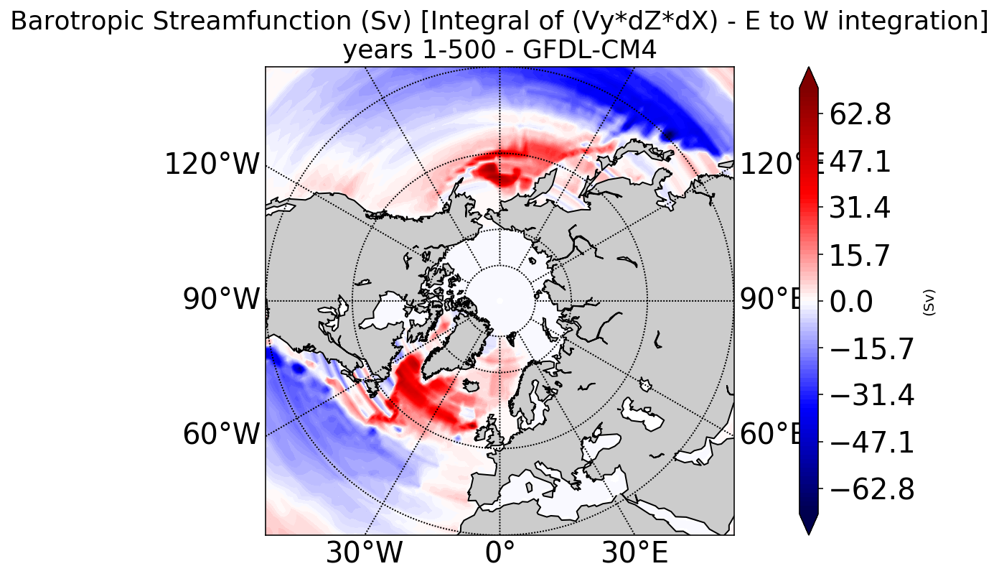

In [17]:
Plot_Var = copy.deepcopy(Stream_function_Barotropic_NAtl_VyDx_ave)
Plot_Var[ Ocean_Land_mask==0 ]=np.nan # masking over land, so grid cells that fall on land area (value=0) will be deleted
cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99.999999)))
Plot_range=np.linspace(-cmap_limit,cmap_limit,101) ### Or:  Plot_range=100
Plot_unit='(Sv)'; Plot_title= 'Barotropic Streamfunction (Sv) [Integral of (Vy*dZ*dX) - E to W integration]\nyears '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var[95:180,:], Lon_regrid_2D[95:180,:], Lat_regrid_2D[95:180,:], Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'npstere', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+str(GCM)+'_Stream_function_NAtl_barotropic_ave_3.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

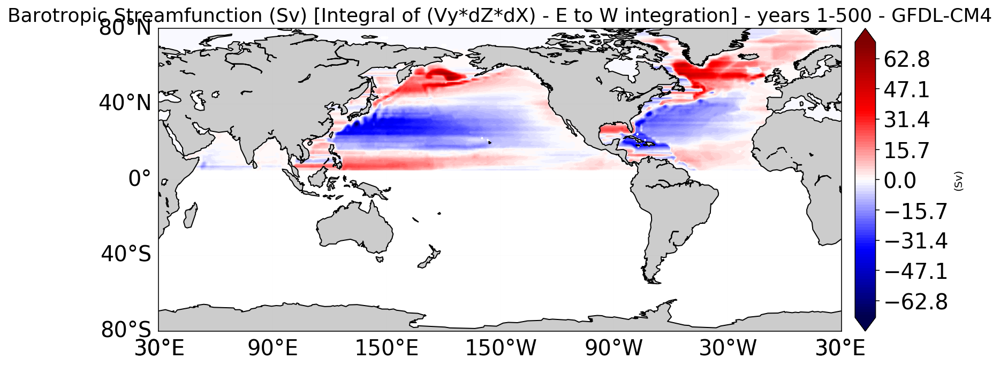

In [31]:
Plot_Var = copy.deepcopy(Stream_function_Barotropic_NAtl_VyDx_ave)
Plot_Var[ Ocean_Land_mask==0 ]=np.nan # masking over land, so grid cells that fall on land area (value=0) will be deleted
cmap_limit=np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99.999999)))
Plot_range=np.linspace(-cmap_limit,cmap_limit,101) ### Or:  Plot_range=100
Plot_unit='(Sv)'; Plot_title= 'Barotropic Streamfunction (Sv) [Integral of (Vy*dZ*dX) - E to W integration] - years '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var[95:180,:], Lon_regrid_2D[95:180,:], Lat_regrid_2D[95:180,:], Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+str(GCM)+'_Stream_function_NAtl_barotropic_ave_4.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [24]:
########                   Gyre Strength Time Series                ###########

Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max = np.nanmax (Stream_function_Barotropic_NAtl_VyDx_allyears [:,140:156,295:320] , axis =2)
Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max = np.nanmax (Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max , axis =1)
Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm = copy.deepcopy(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max)
Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm = runningMeanFast(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm, 10)#if data is not smoothed

Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_norm=(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max-np.nanmean(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max))/np.std(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max)

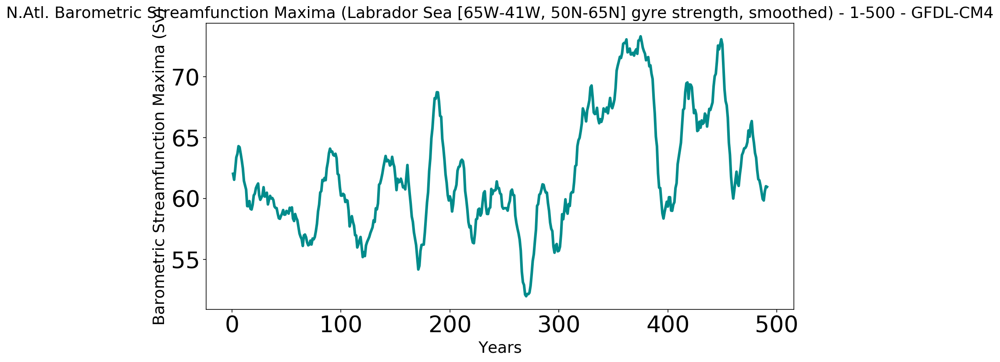

In [34]:
years=np.linspace(year_start,year_end,year_end-year_start+1)
P_Var_x=years[:-9]
P_Var_y=Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9]
P_xlable='Years'
P_ylable='Barometric Streamfunction Maxima (Sv)'
P_title='N.Atl. Barometric Streamfunction Maxima (Labrador Sea [65W-41W, 50N-65N] gyre strength, smoothed) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig = func_plotline_1var(P_Var_x, P_Var_y, P_xlable, P_ylable, P_title, 'darkcyan', '-')
#fig.savefig(dir_figs+str(GCM)+'_Stream_function_LAB_B1_barotropic_max.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [15]:
GCM = GCM_name
import os; import shelve

filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['WS_index']=my_shelf['WS_index']; my_shelf.close()

WS_index_rm = copy.deepcopy(WS_index)

#multiplying by -1 as we have convection when temperature is low(opposite to the index which we calculate)
WS_index_rm=runningMeanFast(WS_index_rm, 10)
WS_index_rm=WS_index_rm*(-1)

############################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_ROSS.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['ROSS_index']=my_shelf['ROSS_index']; my_shelf.close()

ROSS_index_rm = copy.deepcopy(ROSS_index)

#multiplying by -1 as we have convection when temperature is low(opposite to the index which we calculate)
ROSS_index_rm=runningMeanFast(ROSS_index_rm, 10)
ROSS_index_rm=ROSS_index_rm*(-1)

############################################################
filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['LAB_index']=my_shelf['LAB_index']; my_shelf.close()

LAB_index_rm = copy.deepcopy(LAB_index)
LAB_index_rm=runningMeanFast(LAB_index_rm, 10)
#################################################################


filename_out = (os.getcwd() + '/AllResults_'+GCM+'_500yr_trans.out') # Directory to save processed data
my_shelf = shelve.open(filename_out)
globals()['AMOC_max']=my_shelf['AMOC_max']
my_shelf.close()

AMOC_max_50S= AMOC_max[:,40] # AMOC at 50S # Max of streamfunction method
AMOC_max_50S_m=runningMeanFast(AMOC_max_50S, 10)
AMOC_max_30S= AMOC_max[:,60] # AMOC at 30S # Max of streamfunction method
AMOC_max_30S_m=runningMeanFast(AMOC_max_30S, 10)
AMOC_max_50N= AMOC_max[:,140] # AMOC at 50N # Max of streamfunction method
AMOC_max_50N_m=runningMeanFast(AMOC_max_50N, 10)
AMOC_max_30N= AMOC_max[:,120] # AMOC at 30N # Max of streamfunction method
AMOC_max_30N_m=runningMeanFast(AMOC_max_30N, 10)

WS_index_norm=(WS_index-np.nanmean(WS_index))/np.std(WS_index) # Normalized Convection Index
ROSS_index_norm=(ROSS_index-np.nanmean(ROSS_index))/np.std(ROSS_index) # Normalized Convection Index
LAB_index_norm=(LAB_index-np.nanmean(LAB_index))/np.std(LAB_index) # Normalized Convection Index

AMOC_max_50S_norm=(AMOC_max_50S-np.nanmean(AMOC_max_50S))/np.std(AMOC_max_50S) # Normalized AMOC timeseries
AMOC_max_30S_norm=(AMOC_max_30S-np.nanmean(AMOC_max_30S))/np.std(AMOC_max_30S) # Normalized AMOC timeseries
AMOC_max_50N_norm=(AMOC_max_50N-np.nanmean(AMOC_max_50N))/np.std(AMOC_max_50N) # Normalized AMOC timeseries
AMOC_max_30N_norm=(AMOC_max_30N-np.nanmean(AMOC_max_30N))/np.std(AMOC_max_30N) # Normalized AMOC timeseries


In [16]:
#### Compute and plot lagged regression plot####
def func_plot_lagcor_sig(P_Var_x, P_Var_y, lag, P_title, P_color, P_legend, P_legend_loc, P_v_i):
#%% Example :
    
#fig=plt.figure()
#func_plot_lagcor_sig(WS_index_surface_rm[:-9], LAB_index_rm[:-9], 40, P_title, 'y', 'LAB index (Temp at 500m depth)', 'best', '-')
#func_plot_lagcor_sig(WS_index_surface_rm[:-9], Winds_40S60S_0W30W_m[:-9], 40, P_title, 'g', 'Zonal Winds [40S60S, 0W30W]', 'best', '-')
#func_plot_lagcor_sig(WS_index_surface_rm[:-9], AMOC_max_50S_m[:-9], 40, P_title, 'b', 'AMOC max 50S', 'best', '-')
#func_plot_lagcor_sig(WS_index_surface_rm[:-9], AMOC_max_30S_m[:-9], 40, P_title, 'r', 'AMOC max 30S', 'best', '-')
#plt.ylim(-0.7,0.7)
#fig.savefig(dir_figs+'name.png', format='png', dpi=300, transparent=True, bbox_inches='tight')
###  P_v_i='yes' shows the P-value plot of the corrolation
### P_legend_loc = 'best' or 'lower left' or 'right' or 'center' or ...
#%%    
    R_val=[]
    P_val=[]
    from scipy import stats
    for i in range(2*lag):
        slope, intercept, r_value, p_value, std_err = stats.linregress(P_Var_x[lag:len(P_Var_x)-lag], P_Var_y[i:len(P_Var_y)-2*lag+i])
        R_val.append(r_value)
        P_val.append(p_value)
    xx=np.linspace(-lag,lag+1, 2*lag)
    plt.grid(True,which="both",ls="-", color='0.65')
    plt.plot(xx, R_val, P_color, label=P_legend, linewidth=3.0)
    if P_v_i=='yes':
        plt.plot(xx, P_val, P_color, ls='--')#, label='Significance (P-value)')
    plt.xlabel('Years lag', fontsize=18)
    plt.ylabel('Correlation coefficient (R)', fontsize=18)
    plt.title(P_title, fontsize=18)
    plt.xticks(fontsize = 20); plt.yticks(fontsize = 24)
    plt.legend()
    #plt.show()
    plt.legend(prop={'size': 15}, loc=P_legend_loc, fancybox=True, framealpha=0.8)
    l = plt.axhline(y=0, color='k')
    mng = plt.get_current_fig_manager()
    #mng.window.showMaximized() # Maximizes the plot window to save figures in full

    #return fig

(-0.7, 0.7)

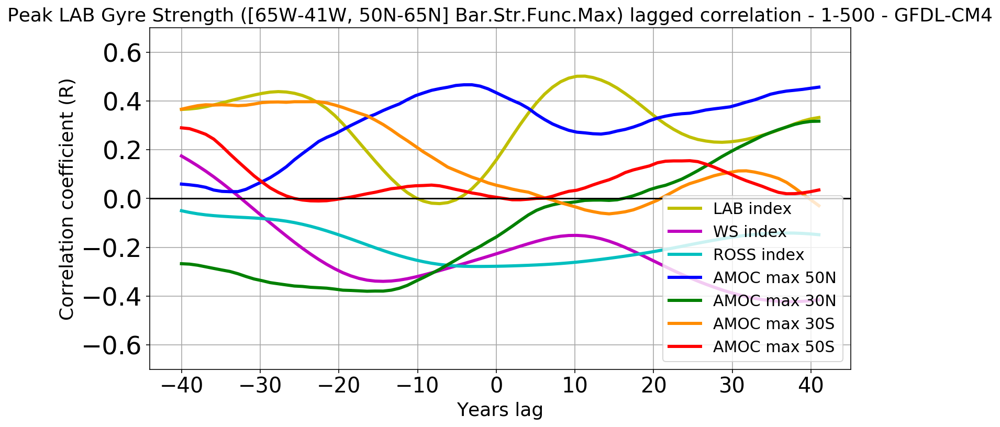

In [20]:
P_title='Peak LAB Gyre Strength ([65W-41W, 50N-65N] Bar.Str.Func.Max) lagged correlation - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure()
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], LAB_index_rm[:-9], 40, P_title, 'y', 'LAB index', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], WS_index_rm[:-9], 40, P_title, 'm', 'WS index', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], ROSS_index_rm[:-9], 40, P_title, 'c', 'ROSS index', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], AMOC_max_50N_m[:-9], 40, P_title, 'b', 'AMOC max 50N', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], AMOC_max_30N_m[:-9], 40, P_title, 'g', 'AMOC max 30N', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], AMOC_max_30S_m[:-9], 40, P_title, 'darkorange', 'AMOC max 30S', 'best', '-')
func_plot_lagcor_sig(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9], AMOC_max_50S_m[:-9], 40, P_title, 'r', 'AMOC max 50S', 'best', '-')
plt.ylim(-0.7,0.7)
#fig.savefig(dir_figs+str(GCM)+'_lagcor_LAB_BarStr_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


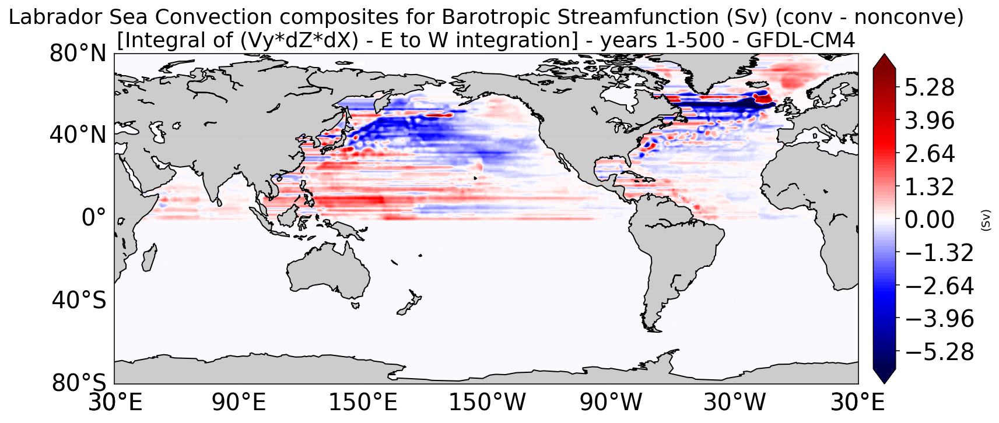

In [48]:
########            Barotropic Streamfunction Composites            ###########

R_ii_LAB = np.where(LAB_index_norm_rm <-0.5)
R_jj_LAB = np.where(LAB_index_norm_rm >0.5)

Stream_function_Barotropic_NAtl_VyDx_lab_c=Stream_function_Barotropic_NAtl_VyDx_allyears[R_ii_LAB]
Stream_function_Barotropic_NAtl_VyDx_lab_n=Stream_function_Barotropic_NAtl_VyDx_allyears[R_jj_LAB]

composite_Stream_function_Barotropic_NAtl_LAB=np.subtract( np.nanmean(Stream_function_Barotropic_NAtl_VyDx_lab_c,axis=0) , np.nanmean(Stream_function_Barotropic_NAtl_VyDx_lab_n,axis=0))

Plot_Var = composite_Stream_function_Barotropic_NAtl_LAB
Plot_Var[ Ocean_Land_mask==0 ]=np.nan # masking over land, so grid cells that fall on land area (value=0) will be deleted
cmap_limit=6  #np.nanmax(np.abs( np.nanpercentile(Plot_Var, 99.999999999999)))
Plot_range=np.linspace(-cmap_limit,cmap_limit,101) ### Or:  Plot_range=100
Plot_unit='(Sv)'; Plot_title= 'Labrador Sea Convection composites for Barotropic Streamfunction (Sv) (conv - nonconve)\n[Integral of (Vy*dZ*dX) - E to W integration] - years '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig, m = func_plotmap_contourf(Plot_Var, Lon_regrid_2D, Lat_regrid_2D, Plot_range, Plot_title, Plot_unit, plt.cm.seismic, 'cyl', 210., 80., -80., 'fill')
#fig.savefig(dir_figs+str(GCM)+'_Stream_function_NAtl_barotropic_composites_LAB.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [26]:
#####################################################################
Salinity_allyears_500m_LAB_B1=np.load('Salinity_allyears_GFDL-CM4_500yr.npy')

Salinity_allyears_500m_LAB_B1=Salinity_allyears_500m_LAB_B1[:,13,140:156,295:320]
Salinity_allyears_500m_LAB_B1=np.nanmean(Salinity_allyears_500m_LAB_B1,axis=2)
Salinity_allyears_500m_LAB_B1=np.nanmean(Salinity_allyears_500m_LAB_B1,axis=1)
Salinity_allyears_500m_LAB_B1_m=runningMeanFast(Salinity_allyears_500m_LAB_B1, 10)

#####################################################################
Density_allyears_500m_LAB_B1=np.load('Density_allyears_GFDL-CM4_500yr.npy')

Density_allyears_500m_LAB_B1=Density_allyears_500m_LAB_B1[:,13,140:156,295:320]
Density_allyears_500m_LAB_B1=np.nanmean(Density_allyears_500m_LAB_B1,axis=2)
Density_allyears_500m_LAB_B1=np.nanmean(Density_allyears_500m_LAB_B1,axis=1)
Density_allyears_500m_LAB_B1_m=runningMeanFast(Density_allyears_500m_LAB_B1, 10)

#####################################################################
Temp_allyears_500m_LAB_B1=np.load('Temp_allyears_GFDL-CM4_500yr.npy')

Temp_allyears_500m_LAB_B1=Temp_allyears_500m_LAB_B1[:,13,140:156,295:320]
Temp_allyears_500m_LAB_B1=np.nanmean(Temp_allyears_500m_LAB_B1,axis=2)
Temp_allyears_500m_LAB_B1=np.nanmean(Temp_allyears_500m_LAB_B1,axis=1)
Temp_allyears_500m_LAB_B1_m=runningMeanFast(Temp_allyears_500m_LAB_B1, 10)

###############################################################################
Salinity_allyears_500m_LAB_B1_norm=(Salinity_allyears_500m_LAB_B1-np.nanmean(Salinity_allyears_500m_LAB_B1))/np.std(Salinity_allyears_500m_LAB_B1)
Density_allyears_500m_LAB_B1_norm=(Density_allyears_500m_LAB_B1-np.nanmean(Density_allyears_500m_LAB_B1))/np.std(Density_allyears_500m_LAB_B1)
Temp_allyears_500m_LAB_B1_norm=(Temp_allyears_500m_LAB_B1-np.nanmean(Temp_allyears_500m_LAB_B1))/np.std(Temp_allyears_500m_LAB_B1)


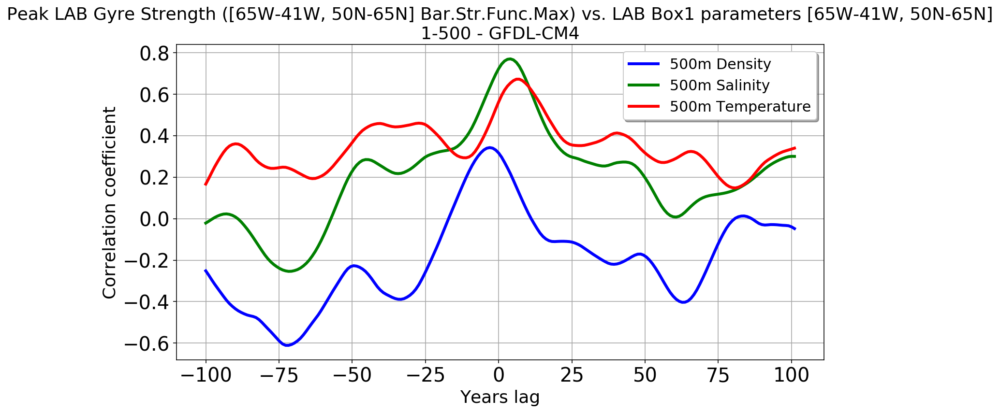

In [48]:
lag_time=100

fig=plt.figure()

lag_cor(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9],Density_allyears_500m_LAB_B1_m[:-9],lag_time,'b','500m Density')
lag_cor(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9],Salinity_allyears_500m_LAB_B1_m[:-9],lag_time,'g','500m Salinity')
lag_cor(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_rm[:-9],Temp_allyears_500m_LAB_B1_m[:-9],lag_time,'r','500m Temperature')
plt.legend()
plt.title('Peak LAB Gyre Strength ([65W-41W, 50N-65N] Bar.Str.Func.Max) vs. LAB Box1 parameters [65W-41W, 50N-65N]\n'+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years lag', fontsize=18)
plt.ylabel('Correlation coefficient', fontsize=18)
plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
plt.legend(shadow=True, prop={'size': 15})
mng = plt.get_current_fig_manager()
#fig.savefig(dir_figs+str(GCM)+'_lagcor_LAB_BarStr_DST_500m_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [21]:
#### Compute and plot PSD using welch method####
def plot_PSD_welch_conf(P_Var, P_fq, P_c_probability, P_rho, P_smooth, P_title, P_color, P_legend, P_legend_loc):

    from scipy.stats import chi2    
    from scipy import signal

    ff,PSD = signal.welch(P_Var,P_fq) # ff= Array of sample frequencies  ,  PSD = Pxx, Power spectral density or power spectrum of x (which is P_Var)
    X_var=np.linspace(1,len(P_Var)/2+1,len(P_Var)/2+1)
    X_var=ff**(-1); X_var=X_var
    
    if P_rho=='yes':
        Rho = np.nansum( (P_Var[:-1] - np.nanmean(P_Var,axis=0)) * (P_Var[1:] - np.nanmean(P_Var,axis=0)) ,axis=0) / np.nansum( (P_Var[:-1] - np.nanmean(P_Var,axis=0)) * (P_Var[:-1] - np.nanmean(P_Var,axis=0)) ,axis=0)
    elif type(P_rho)==float:
        Rho=P_rho # Rho is the memory parameter
    
    if type(P_smooth)==float or type(P_smooth)==int:
        P_smooth=np.int(P_smooth)
        v = 2*P_smooth # P is the number of estimates in welch function and also the degree of freedom.
        
        sm= np.int( (P_smooth-1)/2)
        P_smooth = np.int( (sm*2)+1 ) # P_smoothhs to be even number for centered smoothing; in case odd number was given, it's changed to an even number by subtracting 1
        PSD_m=copy.deepcopy(PSD) ## Smoothing the variable
        for ii in range(sm,PSD.shape[0]-sm+1):
            PSD_m[ii]=np.nanmean(PSD[ii-sm:ii+sm])
        
        PSD_m=PSD_m[sm:-sm]
        X_var_m=X_var[sm:-sm]
        P_legend=P_legend+' ('+str(np.int(P_smooth))+'yr smoothed)'
        
    else:
        v=2

        PSD_m=copy.deepcopy(PSD)
        X_var_m=copy.deepcopy(X_var)
        
    if type(P_c_probability)==float:
        if P_c_probability < 0.5:
            P_c_probability=1-P_c_probability # In case the P_c_probability is input 0.05 instead of 0.95 for example
        alfa = 1 - P_c_probability

    if P_rho=='yes' or type(P_rho)==float or type(P_rho)==int:
        if type(P_c_probability)!=float: # In case the P_c_probability is not given since confidence interval calculation is not necessary, but red noise significance line is needed
            alfa=0.05
            
        F_x_v = (1-Rho**2) / (1 + Rho**2 - 2*Rho*np.cos(2*np.pi*ff ) )  #  F_x_v is the power spectraum   
        F_x_v_star=np.float( np.real( np.nanmean(PSD,axis=0) / np.nanmean(F_x_v,axis=0) ) ) * F_x_v 
        Pr_alpha = (1/v) * F_x_v_star * np.float( chi2.ppf([1 - alfa], v) )
    
    plt.grid(True,which="both",ls="-", color='0.65')
    plt.loglog(X_var_m,PSD_m, color=P_color, label=P_legend)
    plt.legend(loc='best')
    plt.xlabel('Period (years)', fontsize=18)
    plt.ylabel('Spectral Density', fontsize=18) 
    plt.xticks(fontsize = 20); plt.yticks(fontsize = 20)
    #plt.gca().invert_xaxis()
    if type(P_c_probability)==float:
        Chi = chi2.ppf([1 - alfa / 2, alfa / 2], v)
        
        PSDc_lower = PSD_m * ( v / Chi[0] )
        PSDc_upper = PSD_m * ( v / Chi[1] ) 
        plt.loglog(X_var_m,PSDc_lower, color='g', ls='--', label=str(np.int( (1 - alfa) *100))+'% confidence intervals')
        plt.loglog(X_var_m,PSDc_upper, color='g', ls='--')
    if P_rho=='yes' or type(P_rho)==float or type(P_rho)==int:
        plt.loglog(X_var,Pr_alpha , color='b', ls='--', label=str(np.int( (1 - alfa) *100))+'% Red Noise Significance Level')
    plt.legend(prop={'size': 20}, loc=P_legend_loc, fancybox=True, framealpha=0.8)
    plt.title(P_title, fontsize=18) 
    #plt.show()
    mng = plt.get_current_fig_manager()
    #mng.window.showMaximized() # Maximizes the plot window to save figures in full
    return ff,PSD


(1e-10, 3000.0)

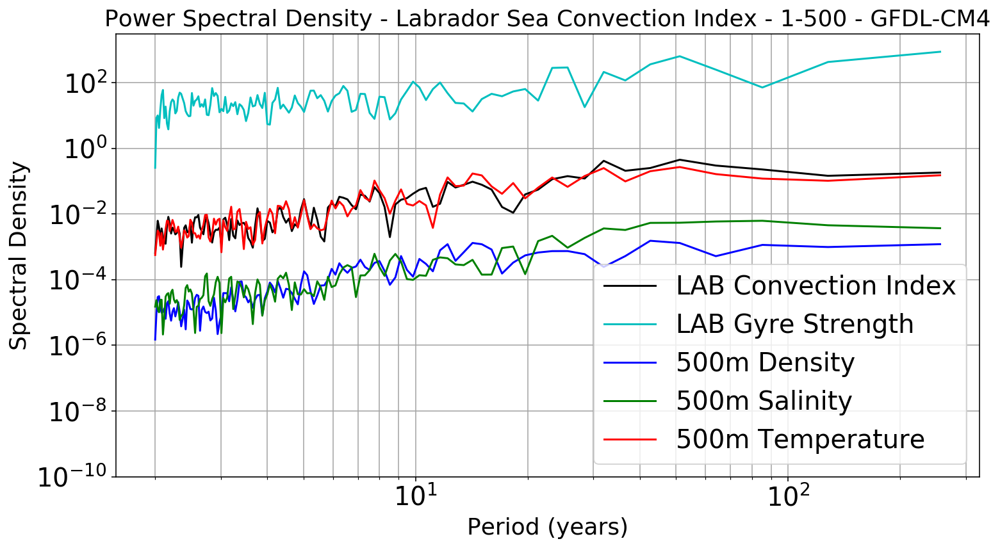

In [27]:
P_title='Power Spectral Density - Labrador Sea Convection Index - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(LAB_index, 1, '-', '-', '-', P_title, 'k', 'LAB Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max, 1, '-', '-', '-', P_title, 'c', 'LAB Gyre Strength', 'lower right')
ff,PSD=plot_PSD_welch_conf(Density_allyears_500m_LAB_B1, 1, '-', '-', '-', P_title, 'b', '500m Density', 'lower right')
ff,PSD=plot_PSD_welch_conf(Salinity_allyears_500m_LAB_B1, 1, '-', '-', '-', P_title, 'g', '500m Salinity', 'lower right')
ff,PSD=plot_PSD_welch_conf(Temp_allyears_500m_LAB_B1, 1, '-', '-', '-', P_title, 'r', '500m Temperature', 'lower right')
plt.ylim(1e-10,3e3) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_LAB_Gyre_DST_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


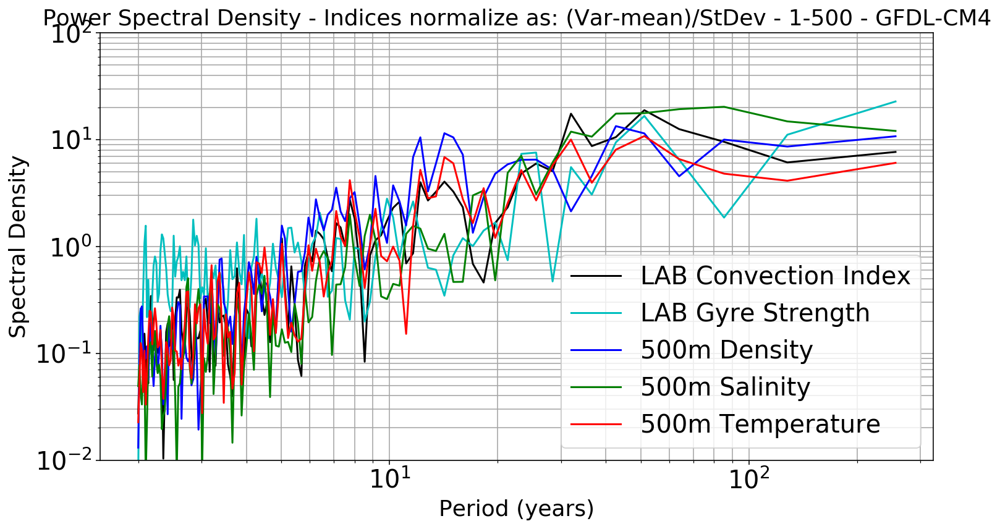

In [38]:
P_title='Power Spectral Density - Indices normalize as: (Var-mean)/StDev - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(LAB_index_norm, 1, '-', '-', '-', P_title, 'k', 'LAB Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_norm, 1, '-', '-', '-', P_title, 'c', 'LAB Gyre Strength', 'lower right')
ff,PSD=plot_PSD_welch_conf(Density_allyears_500m_LAB_B1_norm, 1, '-', '-', '-', P_title, 'b', '500m Density', 'lower right')
ff,PSD=plot_PSD_welch_conf(Salinity_allyears_500m_LAB_B1_norm, 1, '-', '-', '-', P_title, 'g', '500m Salinity', 'lower right')
ff,PSD=plot_PSD_welch_conf(Temp_allyears_500m_LAB_B1_norm, 1, '-', '-', '-', P_title, 'r', '500m Temperature', 'lower right')
plt.ylim(1e-2,1e2) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_LAB_Gyre_DST_Norm_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


(0.0001, 1000.0)

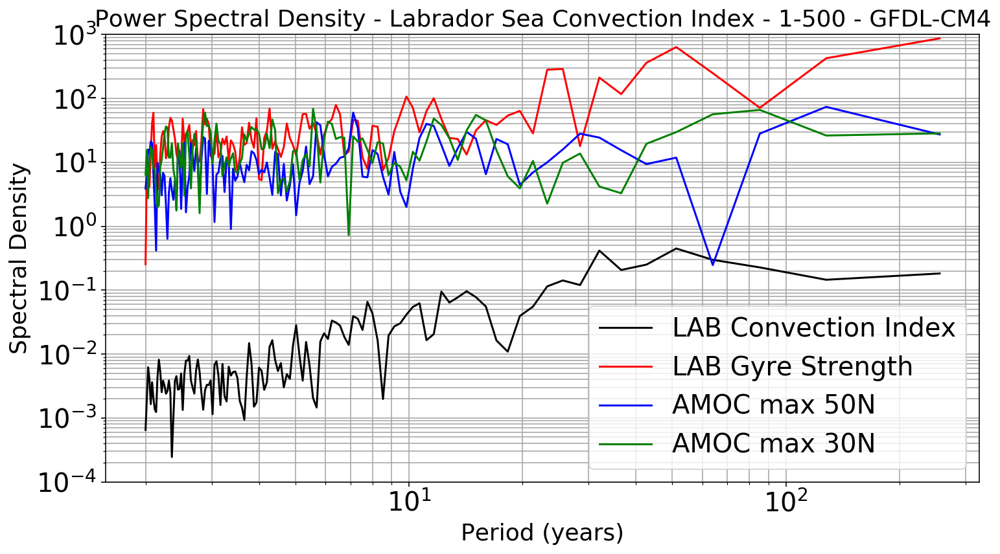

In [31]:
P_title='Power Spectral Density - Labrador Sea Convection Index - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(LAB_index, 1, '-', '-', '-', P_title, 'k', 'LAB Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max, 1, '-', '-', '-', P_title, 'r', 'LAB Gyre Strength', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50N, 1, '-', '-', '-', P_title, 'b', 'AMOC max 50N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30N, 1, '-', '-', '-', P_title, 'g', 'AMOC max 30N', 'lower right')
plt.ylim(1e-4,1e3) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_LAB_Gyre_AMOC_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


(0.001, 100.0)

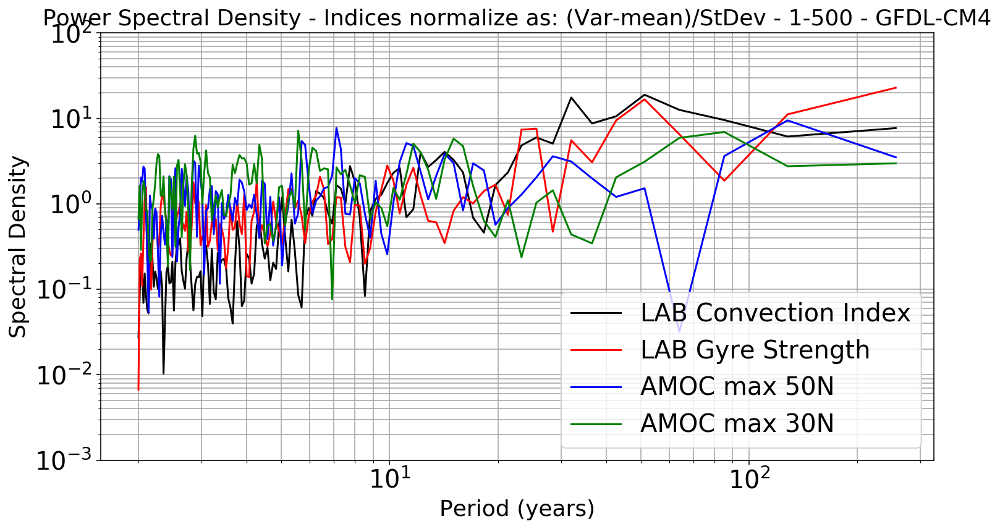

In [32]:
P_title='Power Spectral Density - Indices normalize as: (Var-mean)/StDev - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(LAB_index_norm, 1, '-', '-', '-', P_title, 'k', 'LAB Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(Stream_function_Barotropic_NAtl_VyDx_allyears_LAB_B1_max_norm, 1, '-', '-', '-', P_title, 'r', 'LAB Gyre Strength', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50N_norm, 1, '-', '-', '-', P_title, 'b', 'AMOC max 50N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30N_norm, 1, '-', '-', '-', P_title, 'g', 'AMOC max 30N', 'lower right')
plt.ylim(1e-3,1e2) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_LAB_Gyre_AMOC_Norm_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


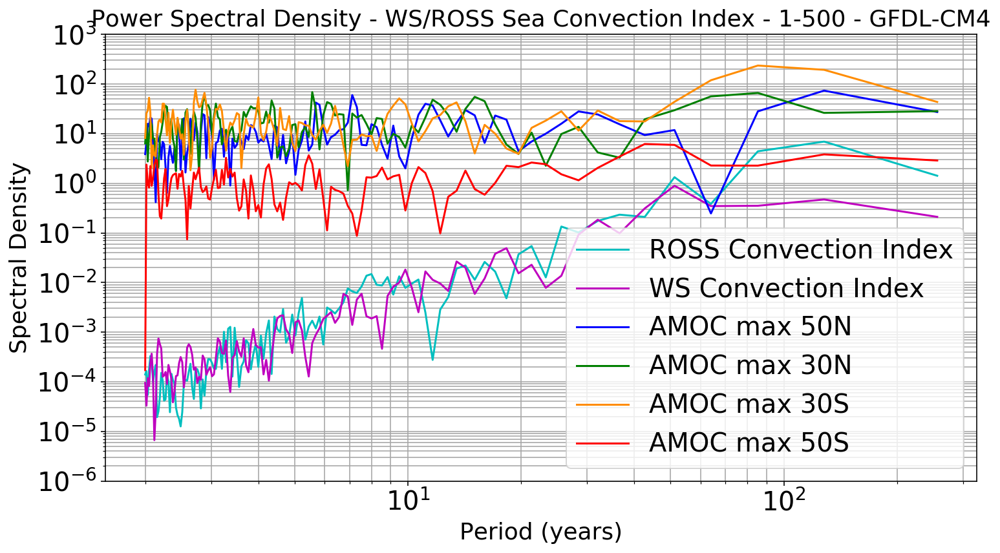

In [40]:
P_title='Power Spectral Density - WS/ROSS Sea Convection Index - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(ROSS_index, 1, '-', '-', '-', P_title, 'c', 'ROSS Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(WS_index, 1, '-', '-', '-', P_title, 'm', 'WS Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50N, 1, '-', '-', '-', P_title, 'b', 'AMOC max 50N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30N, 1, '-', '-', '-', P_title, 'g', 'AMOC max 30N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30S, 1, '-', '-', '-', P_title, 'darkorange', 'AMOC max 30S', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50S, 1, '-', '-', '-', P_title, 'r', 'AMOC max 50S', 'lower right')
plt.ylim(1e-6,1e3) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_WS_ROSS_AMOC_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


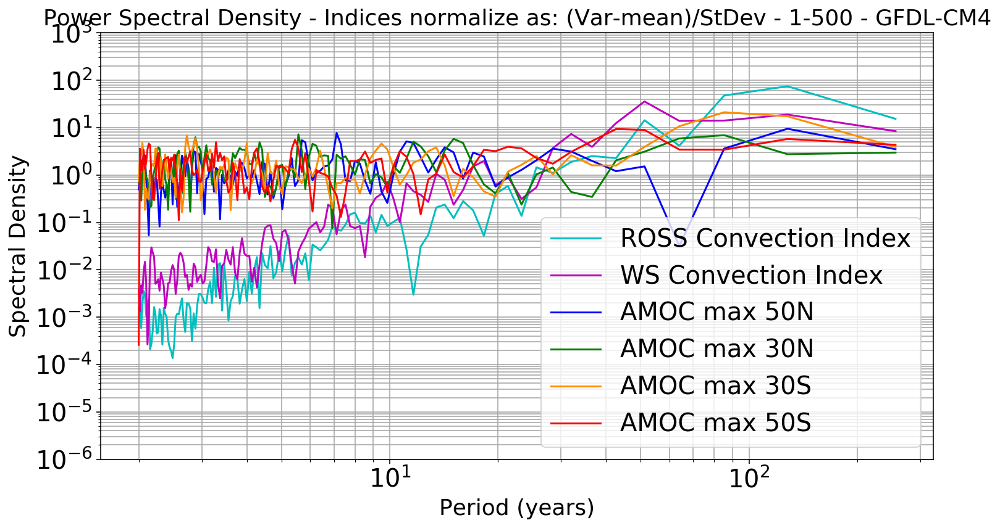

In [42]:
P_title='Power Spectral Density - Indices normalize as: (Var-mean)/StDev - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig=plt.figure(); ax = fig.add_axes([0.12,0.1,0.78,0.8]) # ax [left, bottom, width, height]
ff,PSD=plot_PSD_welch_conf(ROSS_index_norm, 1, '-', '-', '-', P_title, 'c', 'ROSS Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(WS_index_norm, 1, '-', '-', '-', P_title, 'm', 'WS Convection Index', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50N_norm, 1, '-', '-', '-', P_title, 'b', 'AMOC max 50N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30N_norm, 1, '-', '-', '-', P_title, 'g', 'AMOC max 30N', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_30S_norm, 1, '-', '-', '-', P_title, 'darkorange', 'AMOC max 30S', 'lower right')
ff,PSD=plot_PSD_welch_conf(AMOC_max_50S_norm, 1, '-', '-', '-', P_title, 'r', 'AMOC max 50S', 'lower right')
plt.ylim(1e-6,1e3) #;plt.xlim(1,500)
#fig.savefig(dir_figs+str(GCM)+'_PSD_WS_ROSS_AMOC_Norm_1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')


In [36]:
Depths

array([2.5000e+00, 1.0000e+01, 2.0000e+01, 3.2500e+01, 5.1250e+01,
       7.5000e+01, 1.0000e+02, 1.2500e+02, 1.5625e+02, 2.0000e+02,
       2.5000e+02, 3.1250e+02, 4.0000e+02, 5.0000e+02, 6.0000e+02,
       7.0000e+02, 8.0000e+02, 9.0000e+02, 1.0000e+03, 1.1000e+03,
       1.2000e+03, 1.3000e+03, 1.4000e+03, 1.5375e+03, 1.7500e+03,
       2.0625e+03, 2.5000e+03, 3.0000e+03, 3.5000e+03, 4.0000e+03,
       4.5000e+03, 5.0000e+03, 5.5000e+03, 6.0000e+03, 6.5000e+03])

In [ ]:
#######################################################################
#### Density Separation plots 

In [18]:
def func_time_depth_plot_so(ds, indeces, conv_index_depth):

    Depths=ds.lev.values
    yrs_no = np.int(len(ds.time)/12)
    Lon_orig=ds.lon.values
    Lat_orig=ds.lat.values    
    
    [ii,jj]=indeces
    region=[]
    
    lat_n_regrid=90
    lon_n_regrid=180
    Lat_regrid_1D, Lon_regrid_1D, Lat_bound_regrid, Lon_bound_regrid = func_latlon_regrid_eq(lat_n_regrid, lon_n_regrid, -90, 90, 0, 360)
    lon, lat = np.meshgrid(Lon_regrid_1D, Lat_regrid_1D)     
    
    for t in tqdm(range(yrs_no)):
        data = ds.so.isel(time= slice(12*t,12*t+11) ).values
        data=np.asarray(data)
        #data[data>100000]=np.nan
        data=np.nanmean(data,axis=0)
        data=np.squeeze(data)
        data_i = func_regrid(data, Lat_orig, Lon_orig, lat, lon)
        data_i=data_i[:,ii,jj]
        
        #print('time_depth_plot calc - Year: ', t+1)
        region.append(np.nanmean(data_i,axis=1))

    depth_index_start=0
    depth_index_end=0
    if conv_index_depth==0:
        depth_index_start=0
        depth_index_end=1
    else:
        for i in range(len(Depths[:])):
            if Depths[i]<=conv_index_depth:
                depth_index_start=i
        for i in range(len(Depths[:])):
            if Depths[i]<=conv_index_depth:
                depth_index_end=i
    if depth_index_end==0:
        depth_index_end+=1        
        
        
    print(depth_index_start)
    region=np.asarray(region)
    convection_index=region[:,depth_index_start]
    return region,convection_index

In [ ]:
#############################################################################
################        To restore:        ##################################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_ROSS.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()

In [20]:
#### Ross Sea Caclulations ####
month_no=9 # month of the year
hemis_no=4 # 0 = Weddell Sea, 1 = Labrador Sea, 2 = Norwegian Sea, 4 = Ross Sea
conv_index_depth_ross = 500

ROSS_salt_time_depth, ROSS_salt_index=func_time_depth_plot_so(ds_so, ROSS_indeces_lonlat, conv_index_depth_ross)


var_list_short=['ROSS_salt_index', 'ROSS_salt_time_depth']

 ###############################################################################
 ###########                 Saving Results                #####################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_ROSS_salt.out') # Directory to save processed data

### To save
my_shelf = shelve.open(filename_out,'n') # 'n' for new

for key in var_list_short:
    try:
        my_shelf[key] = globals()[key]
    except TypeError:
         print('ERROR shelving: {0}'.format(key))
my_shelf.close()


13


In [19]:
#############################################################################
################        To restore:        ##################################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_LAB_MLD3000.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()

In [20]:
#### LAB Sea Caclulations ####
month_no=3 # month of the year
hemis_no=1 # 0 = Weddell Sea, 1 = Labrador Sea, 2 = Norwegian Sea, 4 = Ross Sea
conv_index_depth_lab = 500

LAB_salt_time_depth, LAB_salt_index=func_time_depth_plot_so(ds_so, LAB_indeces_lonlat, conv_index_depth_lab)


var_list_short=['LAB_salt_index', 'LAB_salt_time_depth']

 ###############################################################################
 ###########                 Saving Results                #####################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM+'_500yr_LAB_salt.out') # Directory to save processed data

### To save
my_shelf = shelve.open(filename_out,'n') # 'n' for new

for key in var_list_short:
    try:
        my_shelf[key] = globals()[key]
    except TypeError:
         print('ERROR shelving: {0}'.format(key))
my_shelf.close()

distributed.scheduler - INFO - Register tcp://10.32.22.6:39823
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.22.6:39823
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Retire worker names (0,)
distributed.deploy.adaptive - INFO - Retiring workers [0]
distributed.scheduler - INFO - Remove worker tcp://10.32.25.5:34349
distributed.core - INFO - Removing comms to tcp://10.32.25.5:34349



13


distributed.scheduler - INFO - Remove worker tcp://10.32.22.6:39823
distributed.core - INFO - Removing comms to tcp://10.32.22.6:39823
distributed.scheduler - INFO - Lost all workers
distributed.scheduler - INFO - Register tcp://10.32.22.2:33189
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.22.2:33189
distributed.core - INFO - Starting established connection


In [21]:
import gsw as g

In [22]:
LAB_T = LAB_index_time_depth
LAB_S = LAB_salt_time_depth

In [25]:
LAB_p = g.p_from_z(-Depths,55) #pressure at all depths assuming Lab sea is on avg 55N

In [26]:
LAB_SA = g.SA_from_SP(LAB_S,LAB_p,310,55) # 50W (310E) and 55N
LAB_CT = g.CT_from_pt(LAB_SA,LAB_T)
LAB_alpha= g.alpha(LAB_SA,LAB_CT,LAB_p)
LAB_beta= g.beta(LAB_SA,LAB_CT,LAB_p)
LAB_rho = g.rho(LAB_SA,LAB_CT,LAB_p)
LAB_sigma= g.sigma0(LAB_SA,LAB_CT)

Text(0.5, 0, 'Years')

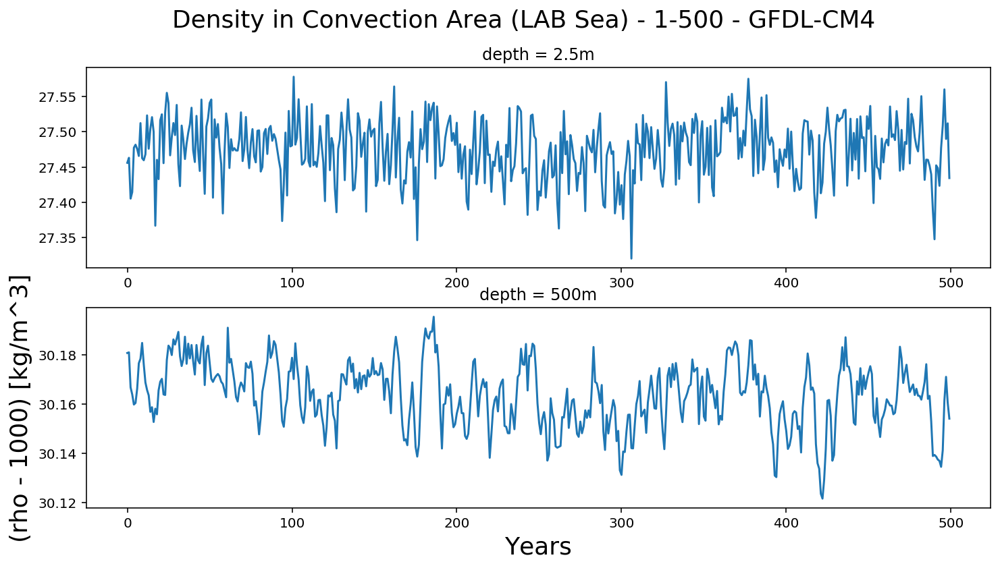

In [28]:
plt.suptitle('Density in Convection Area (LAB Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.subplot(211)
plt.title('depth = 2.5m')
plt.plot(LAB_rho[:,0]-1000)
plt.subplot(212)
plt.title('depth = 500m')
plt.plot(LAB_rho[:,13]-1000)
plt.ylabel('(rho - 1000) [kg/m^3]',fontsize=18)
plt.xlabel('Years', fontsize=18)

Text(0.5, 0, 'Years')

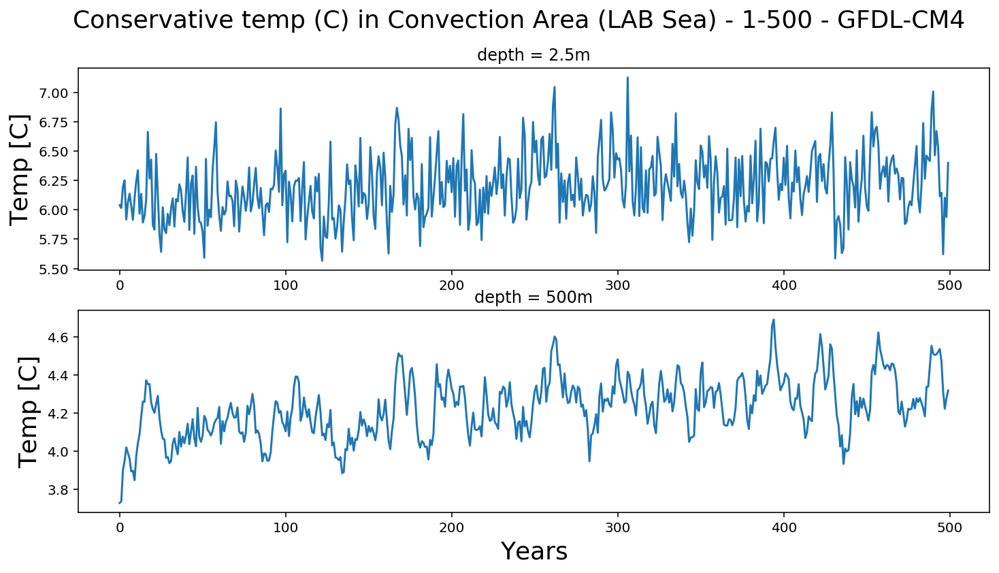

In [29]:
plt.suptitle('Conservative temp (C) in Convection Area (LAB Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.subplot(211)
plt.title('depth = 2.5m')
plt.plot(LAB_CT[:,0])
plt.ylabel('Temp [C]',fontsize=18)
plt.subplot(212)
plt.title('depth = 500m')
plt.plot(LAB_CT[:,13])
plt.ylabel('Temp [C]',fontsize=18)
plt.xlabel('Years', fontsize=18)

Text(0.5, 0, 'Years')

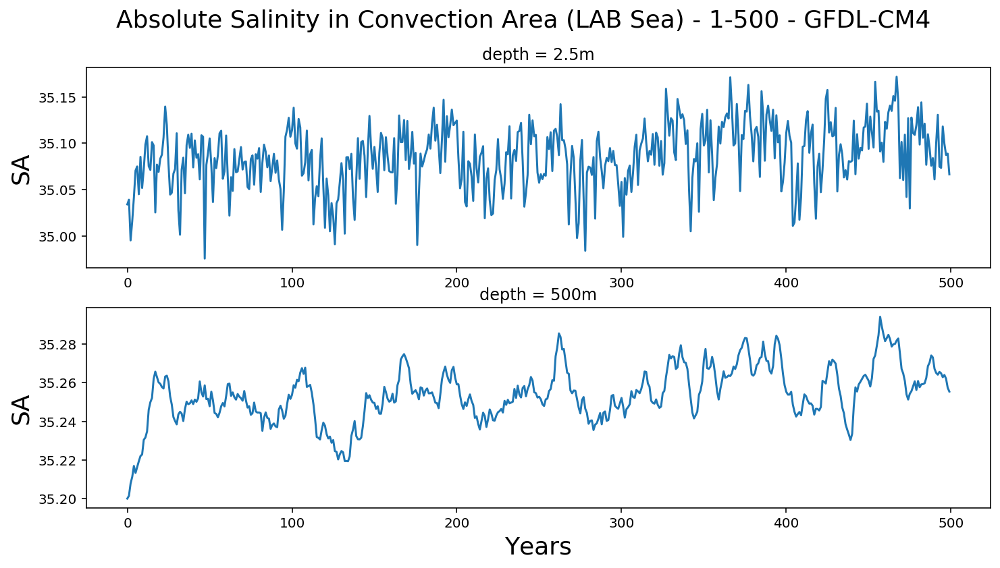

In [30]:
plt.suptitle('Absolute Salinity in Convection Area (LAB Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.subplot(211)
plt.title('depth = 2.5m')
plt.plot(LAB_SA[:,0])
plt.ylabel('SA',fontsize=18)
plt.subplot(212)
plt.title('depth = 500m')
plt.plot(LAB_SA[:,13])
plt.ylabel('SA',fontsize=18)
plt.xlabel('Years', fontsize=18)

Text(0.5, 1.0, 'Thermal Expansion Coefficient, Alpha, in Convection Area (LAB Sea), 500m - 1-500 - GFDL-CM4')

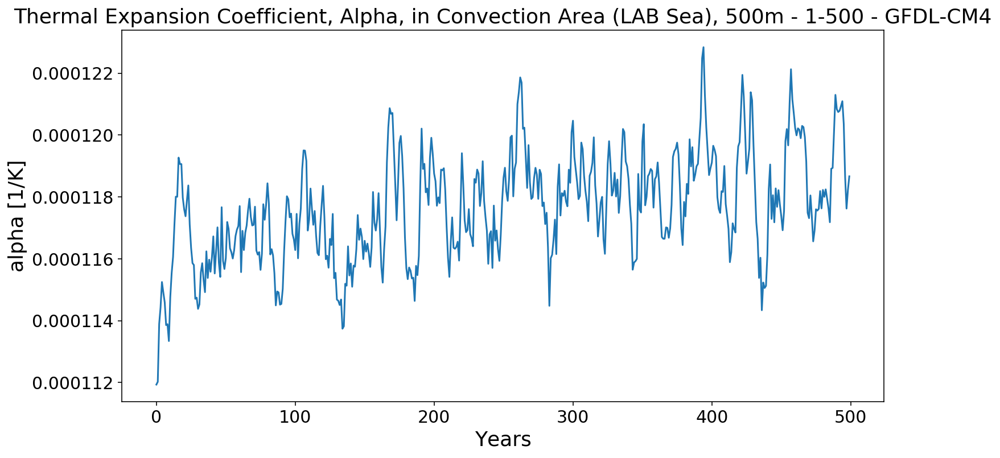

In [31]:
plt.plot(LAB_alpha[:,13])
plt.xlabel('Years', fontsize=18)
plt.ylabel('alpha [1/K]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Thermal Expansion Coefficient, Alpha, in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)

Text(0.5, 1.0, 'Haline Contraction Coefficient, Beta, in Convection Area (LAB Sea), 500m - 1-500 - GFDL-CM4')

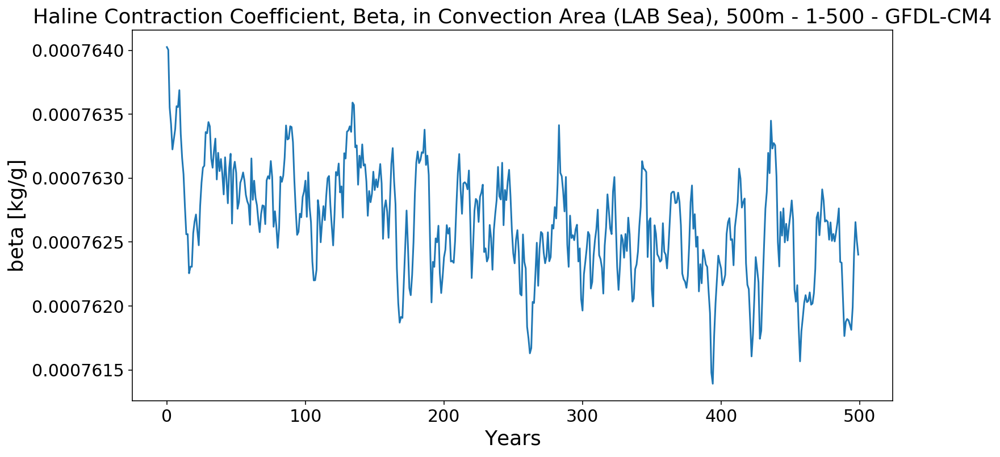

In [32]:
plt.plot(LAB_beta[:,13])
plt.xlabel('Years', fontsize=18)
plt.ylabel('beta [kg/g]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Haline Contraction Coefficient, Beta, in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)

In [33]:
s_term_500 = LAB_beta[:,13]*(LAB_SA[:,13]-np.mean(LAB_SA[:,13]))
t_term_500 = LAB_alpha[:,13]*(LAB_CT[:,13]-np.mean(LAB_CT[:,13]))

s_term_0 = LAB_beta[:,0]*(LAB_SA[:,0]-np.mean(LAB_SA[:,0]))
t_term_0 = LAB_alpha[:,0]*(LAB_CT[:,0]-np.mean(LAB_CT[:,0]))

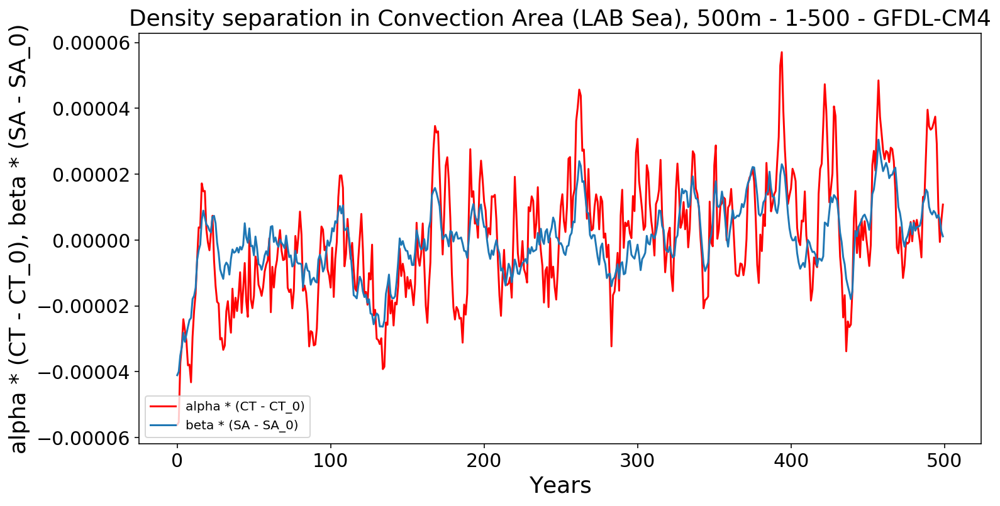

In [34]:
plt.plot(LAB_alpha[:,13]*(LAB_T[:,13]-np.mean(LAB_T[:,13])),'r')
plt.yticks(fontsize = 15)
plt.ylabel('alpha * (CT - CT_0), beta * (SA - SA_0)',fontsize = 18)
plt.plot(LAB_beta[:,13]*(LAB_S[:,13]-np.mean(LAB_S[:,13])))
plt.xlabel('Years', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Density separation in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.legend(['alpha * (CT - CT_0)','beta * (SA - SA_0)'],loc ='lower left')

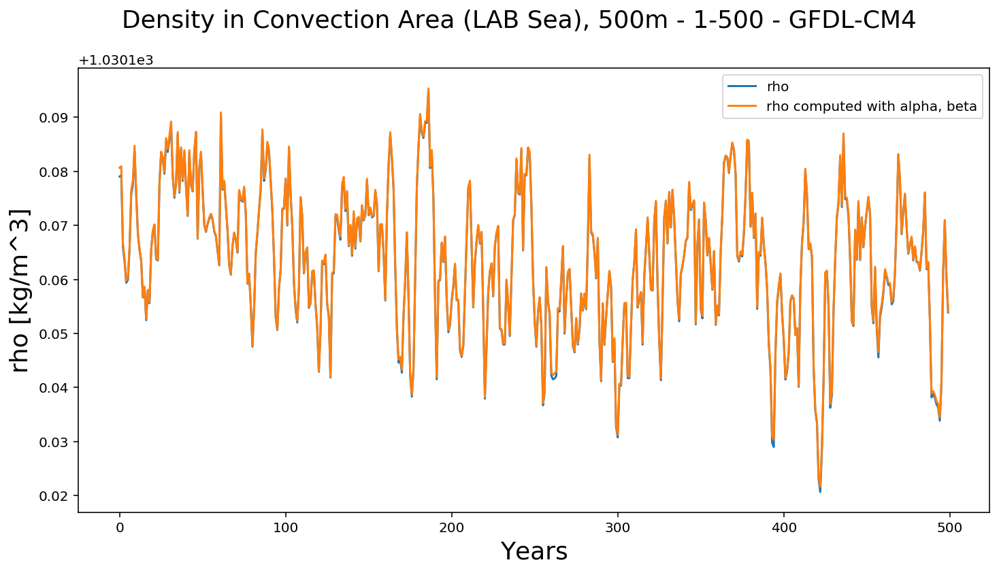

In [36]:
plt.plot((1 + s_term_500-t_term_500 + LAB_p[13]/10.1325/1000/1500**2)*np.mean(LAB_rho[:,13]))
plt.plot(LAB_rho[:,13])
plt.ylabel('rho [kg/m^3]',fontsize=18)
plt.suptitle('Density in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.xlabel('Years',fontsize = 18)
plt.legend(['rho','rho computed with alpha, beta'])

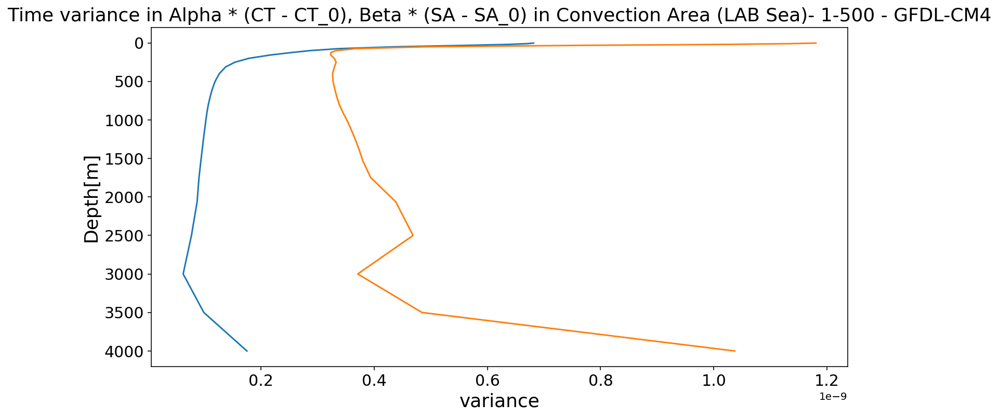

In [37]:
plt.plot(np.var(LAB_beta*(LAB_SA-np.mean(LAB_SA,0)),0),Depths)
plt.plot(np.var(LAB_alpha*(LAB_CT-np.mean(LAB_CT,0)),0),Depths)
plt.xlabel('variance', fontsize=18)
plt.ylabel('Depth[m]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Time variance in Alpha * (CT - CT_0), Beta * (SA - SA_0) in Convection Area (LAB Sea)- '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.gca().invert_yaxis()

In [38]:
LAB_rho_constS= g.rho(np.mean(LAB_SA,0),LAB_CT,LAB_p)
LAB_rho_constT= g.rho(LAB_SA,np.mean(LAB_CT,0),LAB_p)

Text(0.5, 1.0, 'rho calculated with constant SA, CT in Convection Area (LAB Sea), 500m - 1-500 - GFDL-CM4')

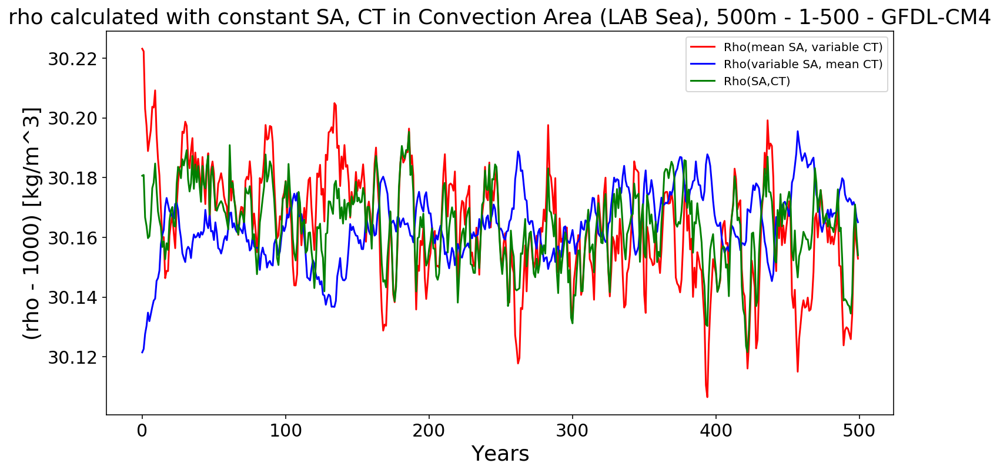

In [39]:
plt.plot(LAB_rho_constS[:,13]-1000,'r')
plt.plot(LAB_rho_constT[:,13]-1000,'b')
plt.plot(LAB_rho[:,13]-1000,'g')
plt.xlabel('Years', fontsize=18)
plt.ylabel('(rho - 1000) [kg/m^3]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.legend(['Rho(mean SA, variable CT)','Rho(variable SA, mean CT)','Rho(SA,CT)'])
plt.title('rho calculated with constant SA, CT in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)

Text(0.5, 1.0, 'rho calculated with constant SA, CT in Convection Area (LAB Sea), 2.5m - 1-500 - GFDL-CM4')

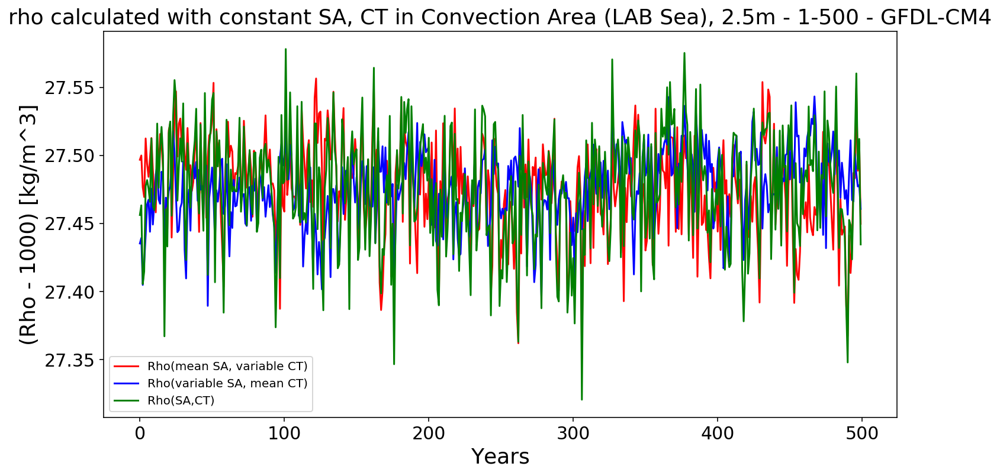

In [40]:
plt.plot(LAB_rho_constS[:,0]-1000,'r')
plt.plot(LAB_rho_constT[:,0]-1000,'b')
plt.plot(LAB_rho[:,0]-1000,'g')
plt.xlabel('Years', fontsize=18)
plt.ylabel('(Rho - 1000) [kg/m^3]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.legend(['Rho(mean SA, variable CT)','Rho(variable SA, mean CT)','Rho(SA,CT)'])
plt.title('rho calculated with constant SA, CT in Convection Area (LAB Sea), ' + str(Depths[0]) + 'm - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)

Text(0, 0.5, 'Depth[m]')

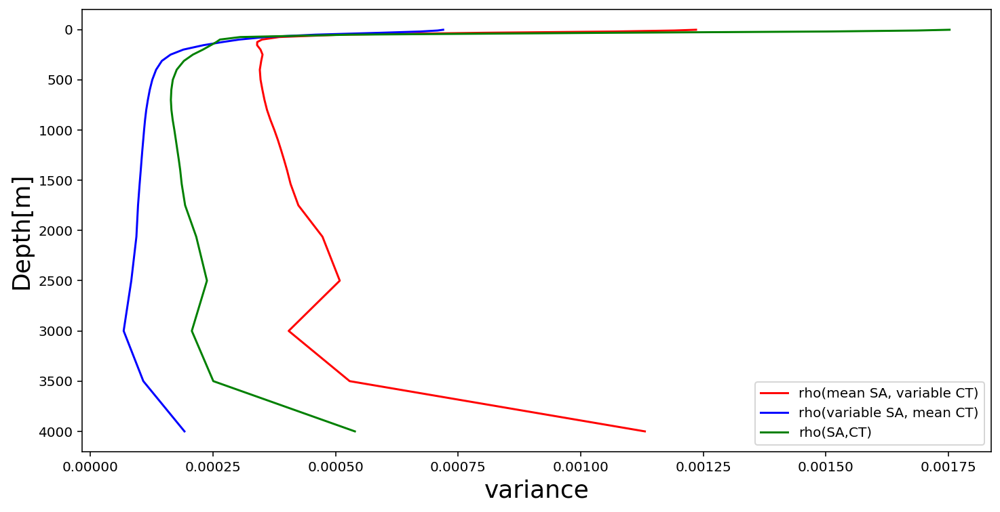

In [41]:

plt.plot(np.var(LAB_rho_constS,0),Depths,'r')
plt.plot(np.var(LAB_rho_constT,0),Depths,'b')
plt.plot(np.var(LAB_rho,0),Depths,'g')
plt.legend(['rho(mean SA, variable CT)','rho(variable SA, mean CT)','rho(SA,CT)'])
plt.gca().invert_yaxis()
plt.xlabel('variance', fontsize=18)
plt.ylabel('Depth[m]', fontsize=18)

In [43]:
ds_theta_sept = ds_thetao.isel(time=slice(year_start-1+8,year_end*12+8,12))
ds_so_sept = ds_so.isel(time=slice(year_start-1+8,year_end*12+8,12))

In [45]:
#ds_theta_sept

In [46]:
### using the ROSS SEA BOX (160 to 230E, 90 to 50S)
### using the LAB SEA BOX ([65W-41W, 50N-65N])
LAB_box_T = np.array(np.nanmean(ds_theta_sept.sel(lat=slice(50,65),lon=slice(295,319)).thetao,(2,3)))
LAB_box_S = np.array(np.nanmean(ds_so_sept.sel(lat=slice(50,65),lon=slice(295,319)).so,(2,3)))

distributed.scheduler - INFO - Register tcp://10.32.7.4:34713
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.7.4:34713
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Register tcp://10.32.45.5:45829
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.45.5:45829
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Register tcp://10.32.5.5:46817
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.5.5:46817
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Register tcp://10.32.8.5:36531
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.8.5:36531
distributed.core - INFO - Starting established connection
distributed.scheduler - INFO - Register tcp://10.32.11.6:37773
distributed.scheduler - INFO - Starting worker compute stream, tcp://10.32.11.6:37773
distributed.core - INFO - Sta

In [47]:
LAB_box_T= np.squeeze(LAB_box_T)
LAB_box_S= np.squeeze(LAB_box_S)
LAB_p = g.p_from_z(-ds_theta_sept.lev,55) #pressure at all depths assuming LAB sea is on avg 55N


LAB_box_SA = g.SA_from_SP(LAB_box_S,LAB_p,310,55) # 50W (310E) and 55N
LAB_box_CT = g.CT_from_pt(LAB_box_SA,LAB_box_T)
LAB_box_alpha= g.alpha(LAB_box_SA,LAB_box_CT,LAB_p)
LAB_box_beta= g.beta(LAB_box_SA,LAB_box_CT,LAB_p)
LAB_box_rho = g.rho(LAB_box_SA,LAB_box_CT,LAB_p)

Text(0.5, 0, 'Years')

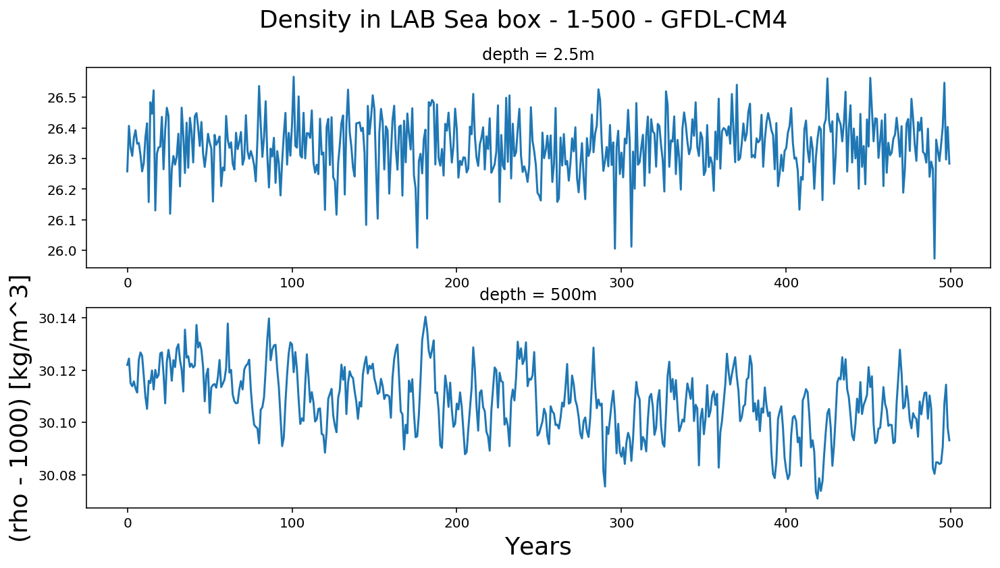

In [48]:

plt.suptitle('Density in LAB Sea box - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.subplot(211)
plt.title('depth = 2.5m')
plt.plot(LAB_box_rho[:,0]-1000)
plt.subplot(212)
plt.title('depth = 500m')
plt.plot(LAB_box_rho[:,13]-1000)
plt.ylabel('(rho - 1000) [kg/m^3]',fontsize=18)
plt.xlabel('Years', fontsize=18)

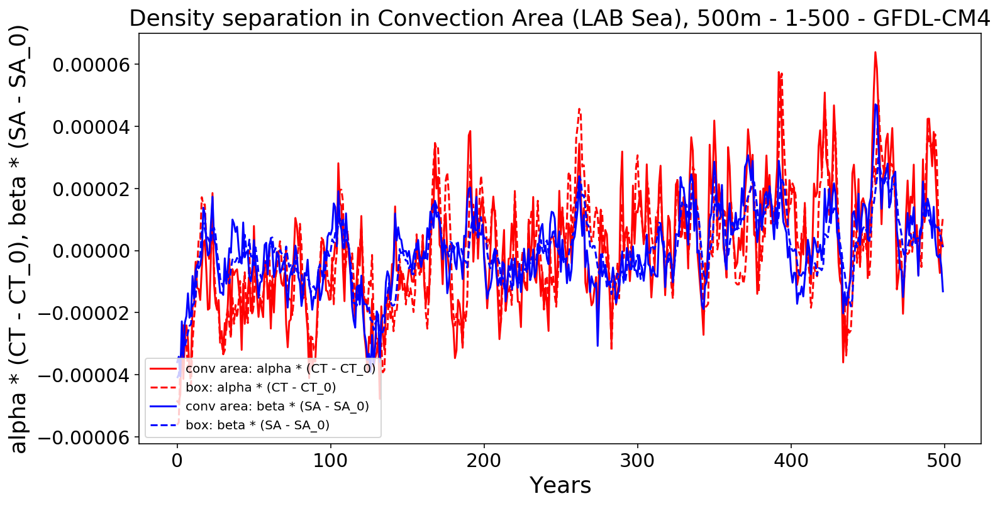

In [49]:
plt.plot(LAB_box_alpha[:,13]*(LAB_box_T[:,13]-np.mean(LAB_box_T[:,13])),'r')
plt.plot(LAB_alpha[:,13]*(LAB_T[:,13]-np.mean(LAB_T[:,13])),'r--')
plt.yticks(fontsize = 15)
plt.ylabel('alpha * (CT - CT_0), beta * (SA - SA_0)',fontsize = 18)
plt.plot(LAB_box_beta[:,13]*(LAB_box_S[:,13]-np.mean(LAB_box_S[:,13])),'b')
plt.plot(LAB_beta[:,13]*(LAB_S[:,13]-np.mean(LAB_S[:,13])),'b--')
plt.xlabel('Years', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Density separation in Convection Area (LAB Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM), fontsize=18)
plt.legend(['conv area: alpha * (CT - CT_0)','box: alpha * (CT - CT_0)','conv area: beta * (SA - SA_0)','box: beta * (SA - SA_0)'],loc ='lower left')

Text(30, -1.2, 'Non-Conv.')

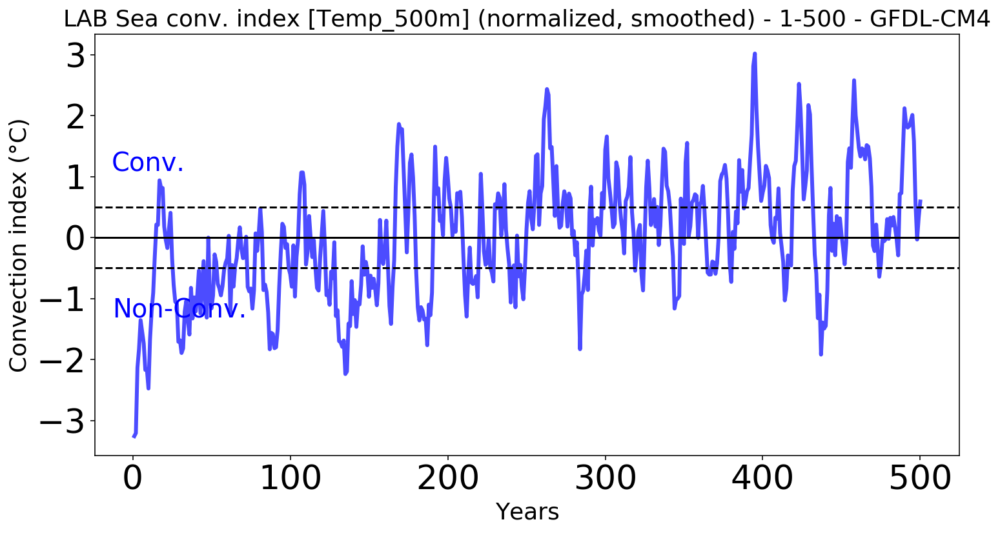

In [52]:
years=np.linspace(year_start,year_end,year_end-year_start+1)
P_Var_x=years
P_Var_y=copy.deepcopy(LAB_index_norm)
P_xlable='Years' ;  P_ylable='Convection index (°C)'
P_title='LAB Sea conv. index [Temp_500m] (normalized, smoothed) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM)
fig = func_plotline_1var(P_Var_x, P_Var_y, P_xlable, P_ylable, P_title,  'b', '-')
for l in fig.gca().lines:
    l.set_alpha(0.7)
l = plt.axhline(y=-0.5, color='k', linestyle ='--')
l = plt.axhline(y=0, color='k')
l = plt.axhline(y=0.5, color='k', linestyle ='--')
plt.text(10, 1.2, 'Conv.', horizontalalignment='center', verticalalignment='center', fontsize=20, color='b')
plt.text(30, -1.2, 'Non-Conv.', horizontalalignment='center', verticalalignment='center', fontsize=20, color='b')
#fig.savefig(dir_figs+str(GCM)+'_convec_index_ROSS_2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [71]:
GCM_2 = 'GFDL-ESM2G'

In [72]:
#############################################################################
################        To restore:        ##################################
import os
import shelve

dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM_2+'_500yr.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
globals()['WS_index_time_depth']=my_shelf['WS_index_time_depth']; my_shelf.close()


dir_pwd = os.getcwd() # Gets the current directory (and in which the code is placed)
filename_out = (dir_pwd + '/AllResults_'+GCM_2+'-WS_salt_index_500yr.out') # Directory to save processed data

my_shelf = shelve.open(filename_out)
for key in my_shelf:
    globals()[key]=my_shelf[key]
my_shelf.close()

In [58]:
WS_index_time_depth

array([[274.49588, 274.19202, 273.6564 , ..., 271.662  , 271.6516 ,
        271.6123 ],
       [274.43832, 274.15475, 273.6555 , ..., 271.6562 , 271.64636,
        271.61346],
       [273.8694 , 273.6918 , 273.33987, ..., 271.6527 , 271.64426,
        271.61414],
       ...,
       [273.81525, 273.61478, 273.2341 , ..., 271.74008, 271.7122 ,
        271.6933 ],
       [274.03552, 273.77896, 273.33057, ..., 271.73306, 271.70993,
        271.68942],
       [273.75906, 273.60745, 273.33566, ..., 271.72693, 271.7057 ,
        271.6908 ]], dtype=float32)

In [59]:
WS_salt_time_depth

array([[34.25313 , 34.269894, 34.28868 , ..., 34.46507 , 34.47005 ,
        34.471462],
       [34.23628 , 34.257896, 34.28182 , ..., 34.465073, 34.47056 ,
        34.471725],
       [34.190434, 34.221916, 34.254017, ..., 34.464767, 34.470543,
        34.472034],
       ...,
       [34.22174 , 34.23768 , 34.25913 , ..., 34.475502, 34.482567,
        34.481987],
       [34.22569 , 34.244865, 34.269745, ..., 34.4751  , 34.481445,
        34.481434],
       [34.205273, 34.22629 , 34.251   , ..., 34.474976, 34.480785,
        34.481438]], dtype=float32)

In [62]:
Depths

array([5.00000000e+00, 1.50000000e+01, 2.50000000e+01, 3.50000000e+01,
       4.50000000e+01, 5.50000000e+01, 6.50000000e+01, 7.50000000e+01,
       8.50000000e+01, 9.50000000e+01, 1.05000000e+02, 1.15000000e+02,
       1.25000000e+02, 1.35000000e+02, 1.45000000e+02, 1.55000000e+02,
       1.65000000e+02, 1.75000000e+02, 1.85000000e+02, 1.95000000e+02,
       2.05000000e+02, 2.15000000e+02, 2.25000000e+02, 2.36122818e+02,
       2.50599976e+02, 2.70620819e+02, 2.98304932e+02, 3.35675629e+02,
       3.84634277e+02, 4.46936646e+02, 5.24170593e+02, 6.17736328e+02,
       7.28828491e+02, 8.58421509e+02, 1.00725708e+03, 1.17583484e+03,
       1.36440625e+03, 1.57297131e+03, 1.80127869e+03, 2.04882861e+03,
       2.31487915e+03, 2.59845630e+03, 2.89836523e+03, 3.21320581e+03,
       3.54138989e+03, 3.88116211e+03, 4.23062061e+03, 4.58774268e+03,
       4.95040869e+03, 5.31642871e+03])

In [74]:
import gsw as g

WS_T = WS_index_time_depth -273.15
WS_S = WS_salt_time_depth

WS_p = g.p_from_z(-Depths,-60) #pressure at all depths assuming Wedell sea is on avg ~60S

WS_SA = g.SA_from_SP(WS_S,WS_p,330,-60) # 30W (330E) and 60S
WS_CT = g.CT_from_pt(WS_SA,WS_T)
WS_alpha= g.alpha(WS_SA,WS_CT,WS_p)
WS_beta= g.beta(WS_SA,WS_CT,WS_p)
WS_rho = g.rho(WS_SA,WS_CT,WS_p)
WS_sigma= g.sigma0(WS_SA,WS_CT)

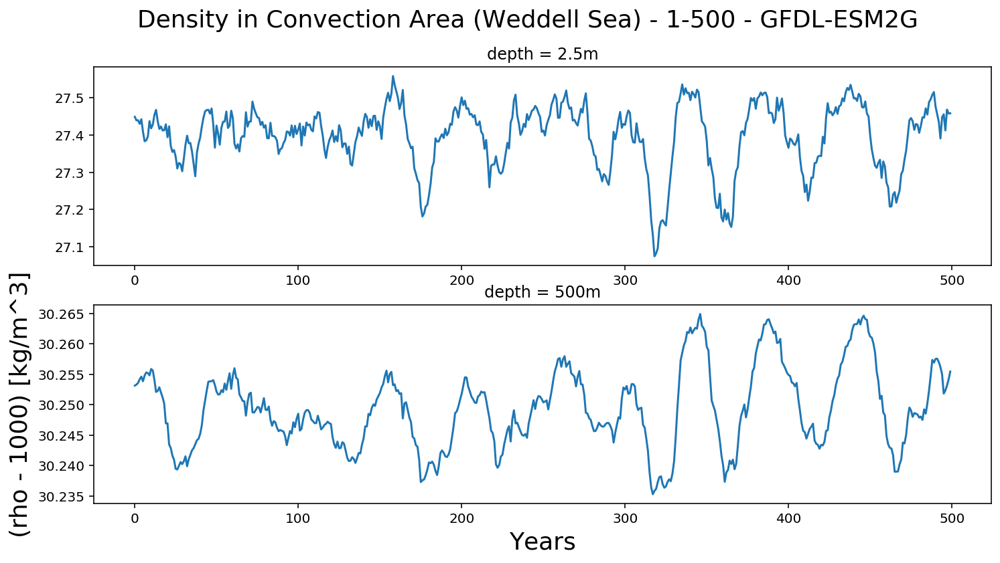

In [76]:
fig=plt.figure()
plt.suptitle('Density in Convection Area (Weddell Sea) - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM_2), fontsize=18)
plt.subplot(211)
plt.title('depth = 2.5m')
plt.plot(WS_rho[:,0]-1000)
plt.subplot(212)
plt.title('depth = 500m')
plt.plot(WS_rho[:,30]-1000)
plt.ylabel('(rho - 1000) [kg/m^3]',fontsize=18)
plt.xlabel('Years', fontsize=18)
#fig.savefig(dir_figs+str(GCM_2)+'_WS_Salt_Density_Temp_separation_Fig1.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [77]:
#########################
s_term_500 = WS_beta[:,30]*(WS_SA[:,30]-np.mean(WS_SA[:,30]))
t_term_500 = WS_alpha[:,30]*(WS_CT[:,30]-np.mean(WS_CT[:,30]))

s_term_0 = WS_beta[:,0]*(WS_SA[:,0]-np.mean(WS_SA[:,0]))
t_term_0 = WS_alpha[:,0]*(WS_CT[:,0]-np.mean(WS_CT[:,0]))


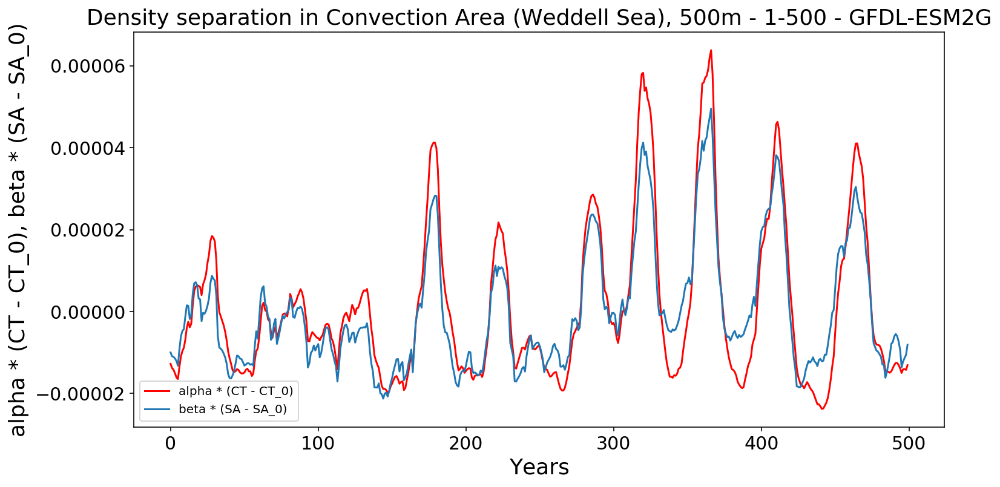

In [78]:
fig=plt.figure()
plt.plot(WS_alpha[:,30]*(WS_T[:,30]-np.mean(WS_T[:,30])),'r')
plt.yticks(fontsize = 15)
plt.ylabel('alpha * (CT - CT_0), beta * (SA - SA_0)',fontsize = 18)
plt.plot(WS_beta[:,30]*(WS_S[:,30]-np.mean(WS_S[:,30])))
plt.xlabel('Years', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.title('Density separation in Convection Area (Weddell Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM_2), fontsize=18)
plt.legend(['alpha * (CT - CT_0)','beta * (SA - SA_0)'],loc ='lower left')
#fig.savefig(dir_figs+str(GCM_2)+'_WS_Salt_Density_Temp_separation_Fig2.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

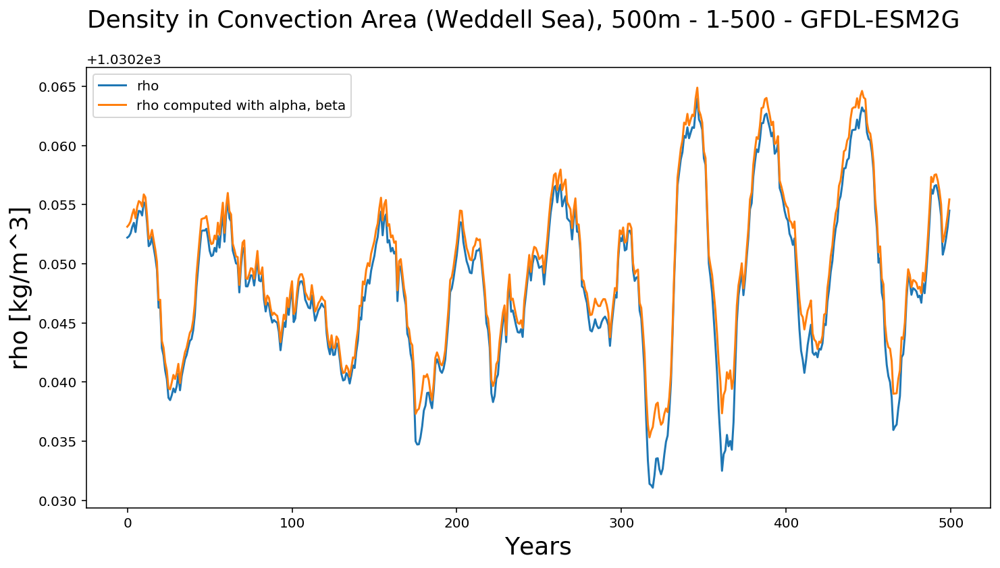

In [79]:
fig=plt.figure()
plt.plot((1 + s_term_500-t_term_500 + WS_p[30]/10.1325/1000/1500**2)*np.mean(WS_rho[:,30]))
plt.plot(WS_rho[:,30])
plt.ylabel('rho [kg/m^3]',fontsize=18)
plt.suptitle('Density in Convection Area (Weddell Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM_2), fontsize=18)
plt.xlabel('Years',fontsize = 18)
plt.legend(['rho','rho computed with alpha, beta'])
#fig.savefig(dir_figs+str(GCM_2)+'_WS_Salt_Density_Temp_separation_Fig3.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

In [80]:
#######################
WS_rho_constS= g.rho(np.mean(WS_SA,0),WS_CT,WS_p)
WS_rho_constT= g.rho(WS_SA,np.mean(WS_CT,0),WS_p)


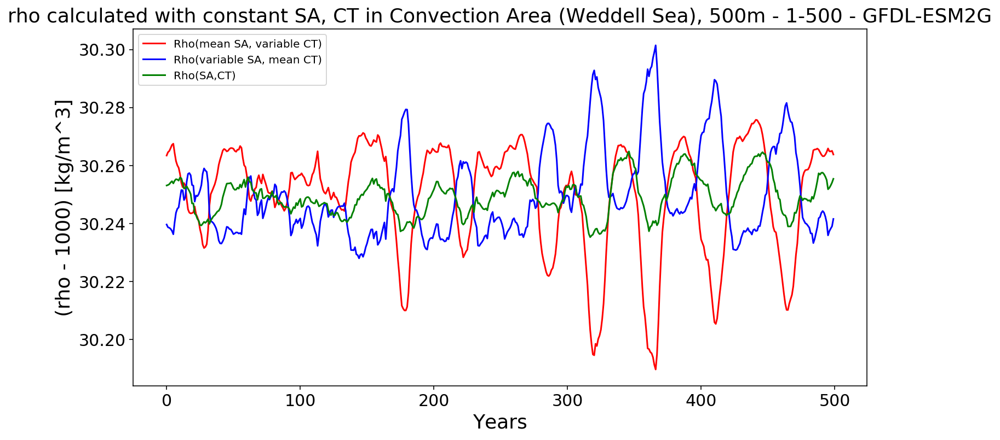

In [81]:
fig=plt.figure()
plt.plot(WS_rho_constS[:,30]-1000,'r')
plt.plot(WS_rho_constT[:,30]-1000,'b')
plt.plot(WS_rho[:,30]-1000,'g')
plt.xlabel('Years', fontsize=18)
plt.ylabel('(rho - 1000) [kg/m^3]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.legend(['Rho(mean SA, variable CT)','Rho(variable SA, mean CT)','Rho(SA,CT)'])
plt.title('rho calculated with constant SA, CT in Convection Area (Weddell Sea), 500m - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM_2), fontsize=18)
#fig.savefig(dir_figs+str(GCM_2)+'_WS_Salt_Density_Temp_separation_Fig4.png', format='png', dpi=300, transparent=True, bbox_inches='tight')

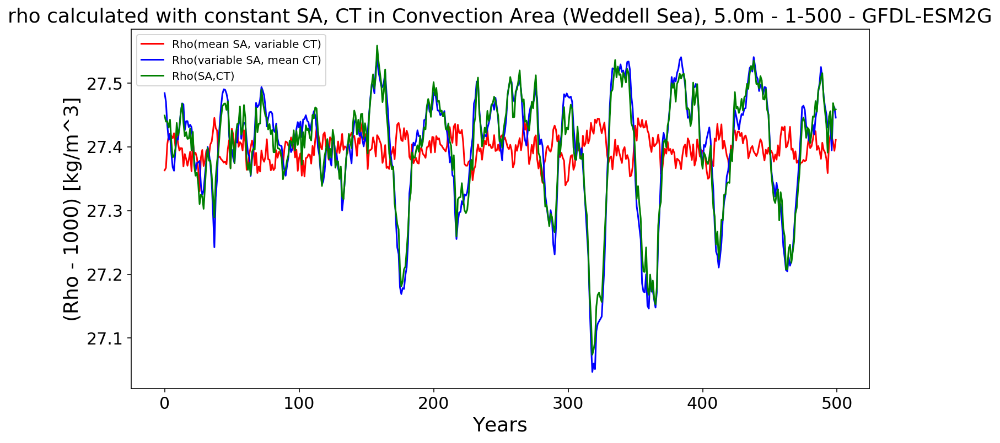

In [82]:
fig=plt.figure()
plt.plot(WS_rho_constS[:,0]-1000,'r')
plt.plot(WS_rho_constT[:,0]-1000,'b')
plt.plot(WS_rho[:,0]-1000,'g')
plt.xlabel('Years', fontsize=18)
plt.ylabel('(Rho - 1000) [kg/m^3]', fontsize=18)
plt.xticks(fontsize = 15); plt.yticks(fontsize = 15)
plt.legend(['Rho(mean SA, variable CT)','Rho(variable SA, mean CT)','Rho(SA,CT)'])
plt.title('rho calculated with constant SA, CT in Convection Area (Weddell Sea), ' + str(Depths[0]) + 'm - '+str(year_start)+'-'+str(year_end)+' - '+str(GCM_2), fontsize=18)
#fig.savefig(dir_figs+str(GCM_2)+'_WS_Salt_Density_Temp_separation_Fig5.png', format='png', dpi=300, transparent=True, bbox_inches='tight')